<a href="https://www.kaggle.com/code/subhadiphensh/walmart-sales-analysis-and-forecasting?scriptVersionId=286297840" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<div align="center">

# **🏪 Walmart Sales Forecasting Project**  

### **Author :** [Subhadip Hensh](https://www.linkedin.com/in/subhadip-hensh/)  

---

## 🧾 Project Overview  

Analyze and forecast **weekly sales data** from Walmart outlets using **statistical analysis**, **exploratory data analysis (EDA)**, and **predictive modeling**.  

Uncover **key sales drivers** and **predict store-wise sales** for the next **12 weeks** with high accuracy.

</div>

---

In [1]:
#---------------------------
# Importing Libraries
#---------------------------
from colorama import Fore, Style
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

---

## 📊 Dataset Description  

The dataset contains **weekly sales data** from multiple **Walmart stores** across the United States.  
It consists of **6,435 records** and **8 key features**, capturing crucial **economic** and **environmental** indicators that influence store performance.  

| 🏷️ **Feature Name** | 🧩 **Description** |
|----------------------|-------------------|
| `Store`              | Unique identifier for each Walmart store. |
| `Date`               | Week of sales in **dd-mm-yyyy** format. |
| `Weekly_Sales`       | Total sales for the given store during that week. |
| `Holiday_Flag`       | Indicates whether the week includes a **major holiday**. |
| `Temperature`        | Average **temperature (°F)** during the week. |
| `Fuel_Price`         | **Average regional fuel cost** ($ per gallon). |
| `CPI`                | **Consumer Price Index**, a measure of inflation. |
| `Unemployment`       | **Unemployment rate (%)** for the region. |

---

### 🔍 Usage  
This dataset will be utilized for:
- **Exploratory Data Analysis (EDA)**  
- **Correlation and trend analysis**  
- **Predictive modeling** for **store-wise sales forecasting**

---

In [2]:
# Load the Dataset
df = pd.read_csv('/kaggle/input/walmart-dataset-for-capstone-project/Walmart DataSet.csv')

# Preview Data
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


---

## 🧹 Data Cleaning  

Steps to be performed:

- Missing values check
- Duplicate records check  
- Detect and Remove Outlier
- Date formatting

---

In [3]:
#---------------------
# Missing value check 
#---------------------
no_of_missing_vals = df.isna().sum().sum()
print(Fore.CYAN + 'Total Number of Missing Values :' + Fore.YELLOW + f' {no_of_missing_vals}' + Style.RESET_ALL)

df = df.dropna()
print(Fore.CYAN + 'After removing missing values, DataFrame Shape :' + Fore.YELLOW + f' {df.shape}\n' + Style.RESET_ALL)

#---------------------
# Duplicate rows check 
#---------------------
no_of_duplicated_rows = df.duplicated().sum()
print(Fore.CYAN + 'Total Number of Duplicated Rows :' + Fore.YELLOW + f' {no_of_duplicated_rows}' + Style.RESET_ALL)

df = df.drop_duplicates()
print(Fore.CYAN + 'After removing duplicated rows, DataFrame Shape :' + Fore.YELLOW + f' {df.shape}' + Style.RESET_ALL)


Total Number of Missing Values : 0
After removing missing values, DataFrame Shape : (6435, 8)

Total Number of Duplicated Rows : 0
After removing duplicated rows, DataFrame Shape : (6435, 8)


In [4]:
plt.style.use('dark_background')

Number of Outliers Detected: 34

DataFrame shape after removing outliers: (6401, 8)



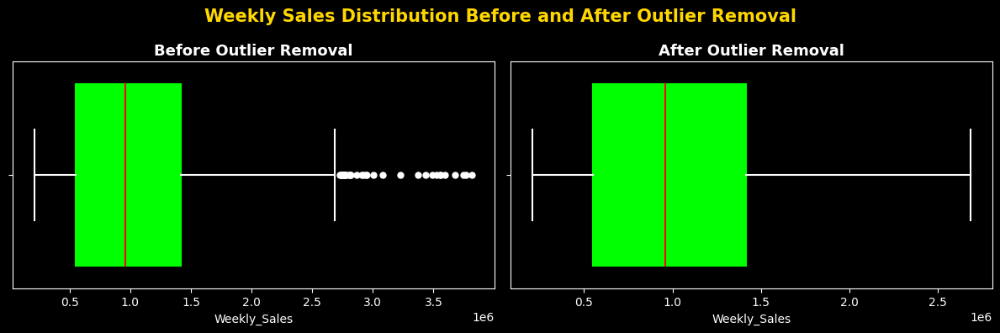

In [5]:
#--------------------------------
# Outlier Detection and Removal
#--------------------------------

if df['Weekly_Sales'].isna().sum() > 0:
    print(Fore.CYAN + 'Missing values found in Weekly_Sales. Filling with forward fill.' + Style.RESET_ALL)
    df['Weekly_Sales'] = df['Weekly_Sales'].fillna(method='ffill')

Q1 = df['Weekly_Sales'].quantile(0.25)
Q3 = df['Weekly_Sales'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[(df['Weekly_Sales'] < lower_bound) | (df['Weekly_Sales'] > upper_bound)]
print(Style.BRIGHT + Fore.CYAN + 'Number of Outliers Detected:' + Style.RESET_ALL + Fore.YELLOW + f' {outliers.shape[0]}' + Style.RESET_ALL + "\n")

#--------------------------------
# Box Plot Setup
#--------------------------------
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

box_style = dict(
    boxprops=dict(color='lime', linewidth=1.5),
    whiskerprops=dict(color='white', linewidth=1.5),
    capprops=dict(color='white', linewidth=1.5),
    medianprops=dict(color='red', linewidth=1.5),
    flierprops=dict(marker='o', color='white', markersize=5, markerfacecolor='white', markeredgecolor='white')
)

#-------------------------
# Before outlier removal
#-------------------------
sns.boxplot(x=df['Weekly_Sales'], ax=axes[0], color='skyblue', **box_style)
axes[0].set_title('Before Outlier Removal', fontsize=13, fontweight='bold', color='white')
axes[0].set_xlabel('Weekly_Sales', color='white')

#--------------------
# Remove Outliers
#--------------------
df_clean = df[(df['Weekly_Sales'] >= lower_bound) & (df['Weekly_Sales'] <= upper_bound)]
print(Style.BRIGHT + Fore.CYAN + 'DataFrame shape after removing outliers:' + Style.RESET_ALL + Fore.YELLOW + f' {df_clean.shape}' + Style.RESET_ALL + '\n')

sns.boxplot(x=df_clean['Weekly_Sales'], ax=axes[1], color='lightgreen', **box_style)
axes[1].set_title('After Outlier Removal', fontsize=13, fontweight='bold', color='white')
axes[1].set_xlabel('Weekly_Sales', color='white')

#--------------------------------
# Spine and Tick Color
#--------------------------------
for ax in axes:
    for spine in ax.spines.values():
        spine.set_color('white')
    ax.tick_params(colors='white')

plt.suptitle('Weekly Sales Distribution Before and After Outlier Removal', fontsize=15, fontweight='bold', color='gold')
plt.tight_layout()
plt.show()


In [6]:
#------------------------------------------
# Summary Statistics after Outlier Removal
#------------------------------------------
heading = 'Summary Statistics after Outlier Removal'
print(Style.BRIGHT + Fore.CYAN + heading + Style.RESET_ALL)
print(Fore.CYAN + '-' * len(heading) + Style.RESET_ALL)

desc = df['Weekly_Sales'].describe()

for stat, value in desc.items():
    print(Style.BRIGHT + Fore.WHITE + f"{stat:<10}" + Style.RESET_ALL + Fore.YELLOW + f"{value:>15,.2f}" + Style.RESET_ALL)

Summary Statistics after Outlier Removal
----------------------------------------
count            6,435.00
mean         1,046,964.88
std            564,366.62
min            209,986.25
25%            553,350.10
50%            960,746.04
75%          1,420,158.66
max          3,818,686.45


In [7]:
df = df_clean
df.shape

(6401, 8)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6401 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6401 non-null   int64  
 1   Date          6401 non-null   object 
 2   Weekly_Sales  6401 non-null   float64
 3   Holiday_Flag  6401 non-null   int64  
 4   Temperature   6401 non-null   float64
 5   Fuel_Price    6401 non-null   float64
 6   CPI           6401 non-null   float64
 7   Unemployment  6401 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 450.1+ KB


---

## 🗓️ Date Formatting  

The `Date` column in the dataset is currently stored as a **string (object)** type.  
To perform accurate **time-based analysis**, such as identifying **seasonal trends**, **holiday effects**, and enabling **forecasting**, it is essential to convert this column into a proper **datetime format**.

This transformation allows for:
- Chronological sorting and filtering  
- Time series visualizations  
- Feature extraction (e.g., month, year, week)

---

In [9]:
df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6401 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6401 non-null   int64         
 1   Date          6401 non-null   datetime64[ns]
 2   Weekly_Sales  6401 non-null   float64       
 3   Holiday_Flag  6401 non-null   int64         
 4   Temperature   6401 non-null   float64       
 5   Fuel_Price    6401 non-null   float64       
 6   CPI           6401 non-null   float64       
 7   Unemployment  6401 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 450.1 KB


---

## 🔍 Exploratory Data Analysis (EDA)

The goal of the **Exploratory Data Analysis (EDA)** phase is to uncover key insights, identify patterns, and understand the underlying structure of the data before modeling.  

### Key Steps to Perform:
- **Analyze Sales Trends Over Time** — Observe overall patterns, seasonality, and growth behavior.  
- **Compare Sales by Store** — Identify top-performing and underperforming stores.  
- **Holiday vs Non-Holiday Sales Analysis** — Examine how holidays impact weekly sales.  
- **Correlation Analysis** — Study relationships between numerical variables such as temperature, fuel price, CPI, and unemployment.

By performing these analyses, we can gain a deeper understanding of **sales dynamics** and the **factors influencing store performance**, forming a solid foundation for predictive modeling.

---

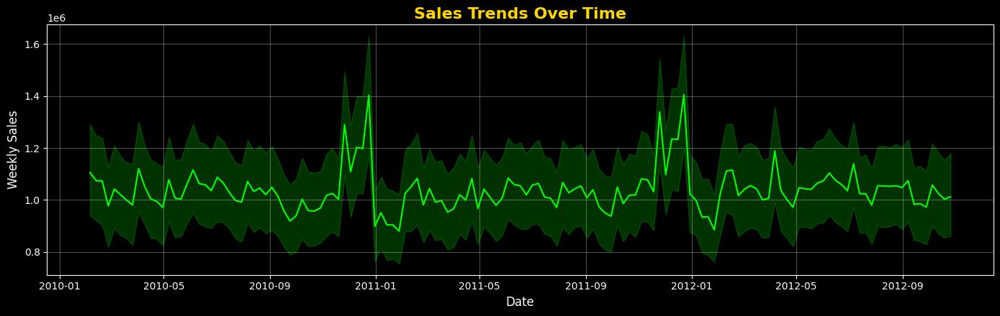

In [10]:
#---------------------------------
# Analyze Sales Trends Over Time
#---------------------------------

plt.figure(figsize=(14,4.5))
sns.lineplot(data=df, x='Date', y='Weekly_Sales', color='lime', linewidth=1.5)

plt.title('Sales Trends Over Time', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Date', fontsize=12)
plt.ylabel('Weekly Sales', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

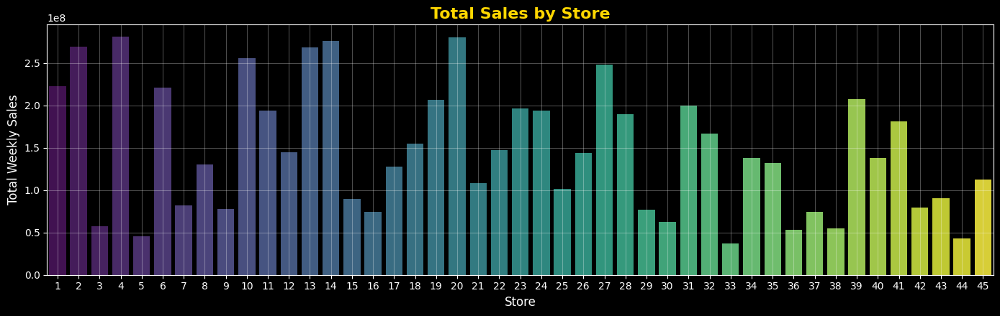

In [11]:
#-------------------------
# Compare Sales by Store
#-------------------------

plt.figure(figsize=(14,4.5))
store_sales = df.groupby('Store', as_index=False)['Weekly_Sales'].sum().sort_values(by='Weekly_Sales', ascending=False)

sns.barplot(
    data=store_sales,
    x='Store',
    y='Weekly_Sales',
    palette='viridis'
)

plt.title('Total Sales by Store', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Store', fontsize=12, color='white')
plt.ylabel('Total Weekly Sales', fontsize=12, color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

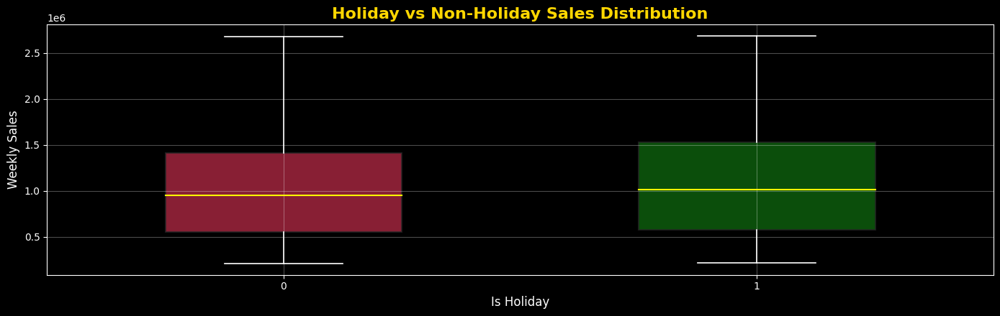

In [12]:
#--------------------------------------
# Holiday vs Non-Holiday Sales
#--------------------------------------

plt.figure(figsize=(14, 4.5))

sns.boxplot(
    data=df,
    x='Holiday_Flag',
    y='Weekly_Sales',
    palette=['crimson', 'green'],
    width=0.5,
    boxprops=dict(alpha=0.7, linewidth=1.5),
    whiskerprops=dict(color='white', linewidth=1.2),
    capprops=dict(color='white', linewidth=1.2),
    medianprops=dict(color='yellow', linewidth=1.5)
)

plt.title('Holiday vs Non-Holiday Sales Distribution', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Is Holiday', fontsize=12, color='white')
plt.ylabel('Weekly Sales', fontsize=12, color='white')

ax = plt.gca()
for spine in ax.spines.values():
    spine.set_color('white')
ax.tick_params(colors='white')
plt.grid(alpha=0.3)

plt.tight_layout()
plt.show()


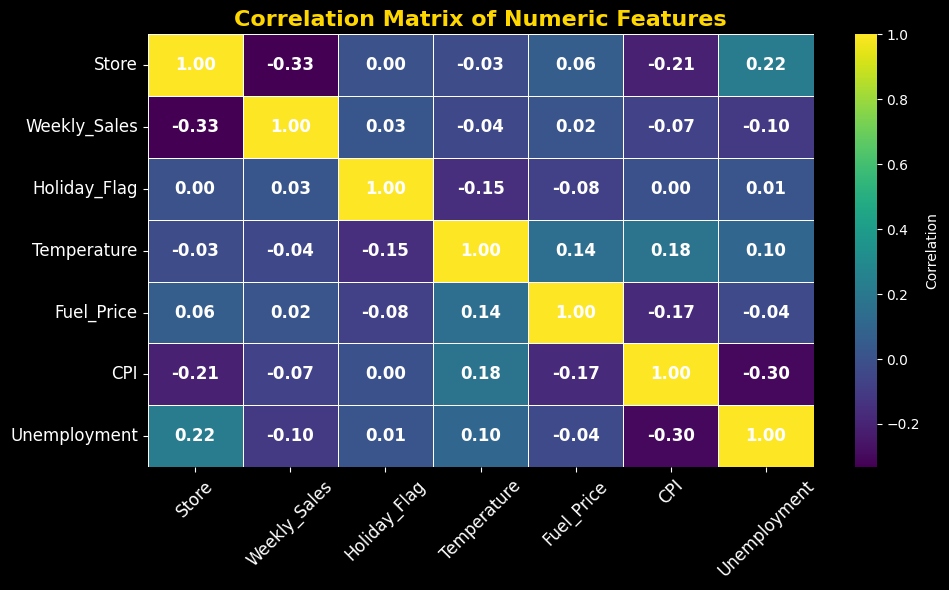

In [13]:
# ----------------------------
# Correlation Matrix
# ----------------------------
numeric_df = df.select_dtypes(include=['float64', 'int64'])
corr_matrix = numeric_df.corr()

plt.figure(figsize=(10, 6))

sns.heatmap(
    corr_matrix,
    annot=True,
    fmt=".2f",
    cmap='viridis',
    linewidths=0.7,
    linecolor='white',
    cbar_kws={'label': 'Correlation'},
    annot_kws={'size':12, 'weight':'bold', 'color':'white'}
)

plt.title('Correlation Matrix of Numeric Features', fontsize=16, fontweight='bold', color='gold')

plt.xticks(fontsize=12, color='white', rotation=45)
plt.yticks(fontsize=12, color='white', rotation=0)

for spine in plt.gca().spines.values():
    spine.set_color('white')

plt.tight_layout()
plt.show()

---

## 📈 Descriptive & Statistical Analysis  

This section focuses on uncovering patterns and relationships within the dataset using statistical techniques:

- **Summary Statistics** of key numerical features  
- **T-Test** to compare sales during **holiday vs non-holiday weeks**  
- **Correlation Analysis** between `Weekly_Sales` and economic indicators:  
  - `CPI` (Consumer Price Index)  
  - `Fuel_Price`  
  - `Unemployment`  


---

In [14]:
from scipy.stats import ttest_ind

#---------------------------------
# Descriptive Statistics
#---------------------------------
print(Style.BRIGHT + Fore.CYAN + 'Descriptive Statistics for Numeric Columns \n' + Style.RESET_ALL)
print(Fore.YELLOW + str(df.describe()) + Style.RESET_ALL)

Descriptive Statistics for Numeric Columns 

             Store                           Date  Weekly_Sales  Holiday_Flag  \
count  6401.000000                           6401  6.401000e+03   6401.000000   
mean     23.054210  2011-06-17 04:24:33.519762432  1.036130e+06      0.068895   
min       1.000000            2010-02-05 00:00:00  2.099862e+05      0.000000   
25%      12.000000            2010-10-08 00:00:00  5.517431e+05      0.000000   
50%      23.000000            2011-06-17 00:00:00  9.572983e+05      0.000000   
75%      34.000000            2012-02-24 00:00:00  1.414565e+06      0.000000   
max      45.000000            2012-10-26 00:00:00  2.685352e+06      1.000000   
std      12.991284                            NaN  5.451961e+05      0.253296   

       Temperature   Fuel_Price          CPI  Unemployment  
count  6401.000000  6401.000000  6401.000000   6401.000000  
mean     60.772042     3.359634   171.642219      8.002298  
min      -2.060000     2.472000   126.0640

In [15]:
#--------------------------------------
# T-test : Holiday vs Non-holiday Sales
#--------------------------------------

holiday_sales = df[df['Holiday_Flag'] == 1]['Weekly_Sales']
non_holiday_sales = df[df['Holiday_Flag'] == 0]['Weekly_Sales']

t_stat, p_value = ttest_ind(holiday_sales, non_holiday_sales, equal_var=False)

print(Style.BRIGHT + Fore.BLUE + 'T-test : Holiday vs Non-Holiday Sales' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.CYAN + 'T-Statistic : ' + Fore.YELLOW + f'{t_stat:.4f}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.CYAN + 'P-Value : ' + Fore.YELLOW + f'{p_value:.4e}' + Style.RESET_ALL)

if p_value < 0.05:
    print(Style.BRIGHT + Fore.RED + ' - Significant difference between holiday and non-holiday sales' + Style.RESET_ALL)
else:
    print(Style.BRIGHT + Fore.GREEN + ' - No significant difference between holiday and non-holiday sales' + Style.RESET_ALL)

T-test : Holiday vs Non-Holiday Sales
T-Statistic : 1.9130
P-Value : 5.6314e-02
 - No significant difference between holiday and non-holiday sales


In [16]:
#------------------------------------
# Correlation Analysis between Weekly_Sales and economic indicators:
#      - CPI (Consumer Price Index)
#      - Fuel_Price
#      - Unemployment
#------------------------------------
corr_columns = ['Weekly_Sales', 'CPI', 'Fuel_Price', 'Unemployment']

correlation_matrix = df[corr_columns].corr()

print(Fore.CYAN + "Correlation with Weekly_Sales :\n" + Style.RESET_ALL)

for col, value in correlation_matrix['Weekly_Sales'].drop('Weekly_Sales').items():
    if value > 0.5:
        color = Fore.GREEN     
    elif value > 0:
        color = Fore.BLUE 
    elif value < -0.5:
        color = Fore.RED        
    elif value < 0:
        color = Fore.MAGENTA    
    else:
        color = Fore.YELLOW    
    
    print(f"{Style.BRIGHT}{Fore.YELLOW}{col:<15}{Style.RESET_ALL}: {color}{value:.3f}{Style.RESET_ALL}")

Correlation with Weekly_Sales :

CPI            : -0.070
Fuel_Price     : 0.018
Unemployment   : -0.104


---

## 🔍 Question 1: Impact of Unemployment on Weekly Sales  

**Objective:**  
Determine whether the **unemployment rate** affects **weekly sales** across Walmart stores.  
If a significant relationship exists, identify **which stores are most negatively impacted** by rising unemployment.


---

In [17]:
df[['Weekly_Sales', 'Unemployment']].corr()

,Weekly_Sales,Unemployment
Weekly_Sales,1.000000,-0.104298
Unemployment,-0.104298,1.000000


In [18]:
#--------------------------------------------------------------
# Store-wise Correlation between Weekly_Sales and Unemployment
#--------------------------------------------------------------
store_corr = (
    df.groupby('Store')[['Weekly_Sales', 'Unemployment']]
    .corr()
    .iloc[0::2, -1]
    .reset_index()
)

store_corr.columns = ['Store', 'Metric', 'Correlation']
store_corr = store_corr.sort_values(by='Correlation')

most_affected = store_corr[store_corr['Correlation'] < -0.3]

print(Style.BRIGHT + Fore.CYAN + "Stores Most Affected by Unemployment" + Fore.YELLOW + "(Correlation < -0.3)" + Style.RESET_ALL)
print(Fore.CYAN + "-----------------------------------------------------------" + Style.RESET_ALL + "\n")

print(Fore.YELLOW + f"{'Store':<10}{'Correlation':>15}" + Style.RESET_ALL)

for _, row in most_affected.iterrows():
    corr = row['Correlation']
    color = Fore.RED if corr < -0.5 else Fore.MAGENTA 
    print(Style.BRIGHT + Fore.WHITE + f"{int(row['Store']):<10}" + color + f"{corr:>15.3f}" + Style.RESET_ALL)

Stores Most Affected by Unemployment(Correlation < -0.3)
-----------------------------------------------------------

Store         Correlation
38                 -0.785
44                 -0.780
4                  -0.640
13                 -0.400
39                 -0.385
42                 -0.356
41                 -0.351


---

## 🔍 Question 2: Seasonal Trends in Weekly Sales  

**Objective:**  
Investigate whether **weekly sales** exhibit any **seasonal patterns** throughout the year.  
If a trend is observed, identify **when** it occurs and explore **possible reasons** behind these seasonal fluctuations.

---

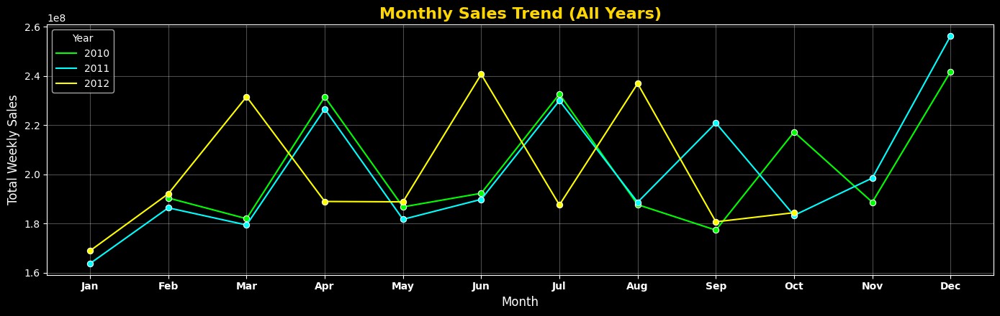

In [19]:
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Week'] = df['Date'].dt.isocalendar().week
df['Quarter'] = df['Date'].dt.quarter

# Aggregate weekly sales by month
monthly_sales = df.groupby(['Year', 'Month'])['Weekly_Sales'].sum().reset_index()

# Aggregate weekly sales by week number across all years
weekly_sales = df.groupby('Week')['Weekly_Sales'].mean().reset_index()

#-----------------------------
# Momthly Sales Trend
#-----------------------------
plt.figure(figsize=(14,4.5))
sns.lineplot(data=monthly_sales, x='Month', y='Weekly_Sales', hue='Year', palette={2012 : "yellow", 2011 : 'cyan' , 2010 : 'lime'}, marker='o')
plt.title('Monthly Sales Trend (All Years)', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Month', fontsize=12, color='white')
plt.ylabel('Total Weekly Sales', fontsize=12, color='white')
plt.xticks(range(1,13), ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec'], color='white', fontweight='semibold')
plt.yticks(color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

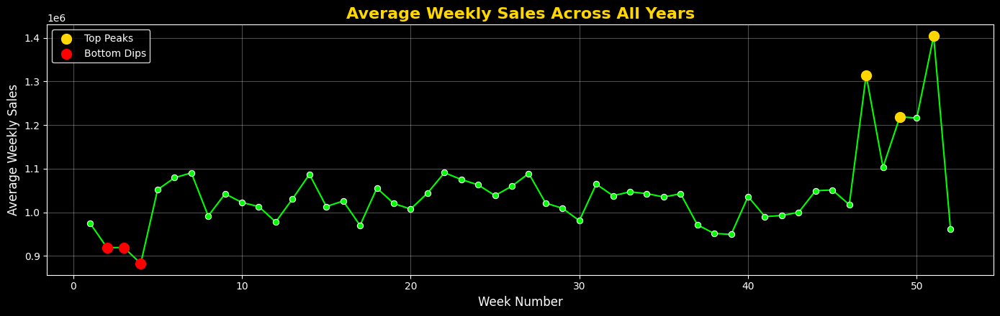


Top 3 Weekly Sales Peaks:

Week 51  : 1403886.69
Week 47  : 1314322.77
Week 49  : 1218829.17

Bottom 3 Weekly Sales Dips:

Week 4   : 882609.20
Week 2   : 918852.85
Week 3   : 919284.94


In [20]:
#--------------------------------------------
# Average Weekly Sales Trend Across the Year
# 
# This section analyzes the average weekly sales across all years.
# It identifies the top 3 peaks and bottom 3 dips in weekly sales.
# A line plot is created to visualize the trend, with peaks highlighted in red
# and dips highlighted in blue. The results are also printed with color coding.
#--------------------------------------------

# Aggregate weekly sales by week number across all years
weekly_sales = df.groupby('Week')['Weekly_Sales'].mean().reset_index()

# Identify top 3 peaks and bottom 3 dips
top_peaks = weekly_sales.nlargest(3, 'Weekly_Sales')
bottom_dips = weekly_sales.nsmallest(3, 'Weekly_Sales')

plt.figure(figsize=(14,4.5))
sns.lineplot(data=weekly_sales, x='Week', y='Weekly_Sales', color='lime', marker='o')
plt.title('Average Weekly Sales Across All Years', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Week Number', fontsize=12, color='white')
plt.ylabel('Average Weekly Sales', fontsize=12, color='white')
plt.xticks(color='white')
plt.yticks(color='white')
plt.grid(alpha=0.3)

# Highlight top peaks in gold
plt.scatter(top_peaks['Week'], top_peaks['Weekly_Sales'], color='gold', s=100, zorder=5, label='Top Peaks')
# Highlight bottom dips in red
plt.scatter(bottom_dips['Week'], bottom_dips['Weekly_Sales'], color='red', s=100, zorder=5, label='Bottom Dips')

plt.legend(facecolor='black', edgecolor='white', labelcolor='white')
plt.tight_layout()
plt.show()

print(Fore.CYAN + "\nTop 3 Weekly Sales Peaks:\n" + Style.RESET_ALL)
for _, row in top_peaks.iterrows():
    print(Fore.YELLOW + f"Week {int(row['Week']):<3}" + Fore.RED + f" : {row['Weekly_Sales']:.2f}" + Style.RESET_ALL)

print(Fore.CYAN + "\nBottom 3 Weekly Sales Dips:\n" + Style.RESET_ALL)
for _, row in bottom_dips.iterrows():
    print(Fore.YELLOW + f"Week {int(row['Week']):<3}" + Fore.BLUE + f" : {row['Weekly_Sales']:.2f}" + Style.RESET_ALL)


---

## 🔍 Question 3: Temperature Effects on Weekly Sales  

**Objective:**  
Explore whether **temperature variations** have any impact on **weekly sales** across Walmart stores.  
Identify if there's a **positive or negative relationship**, and assess whether certain stores or regions are more sensitive to temperature changes.

---

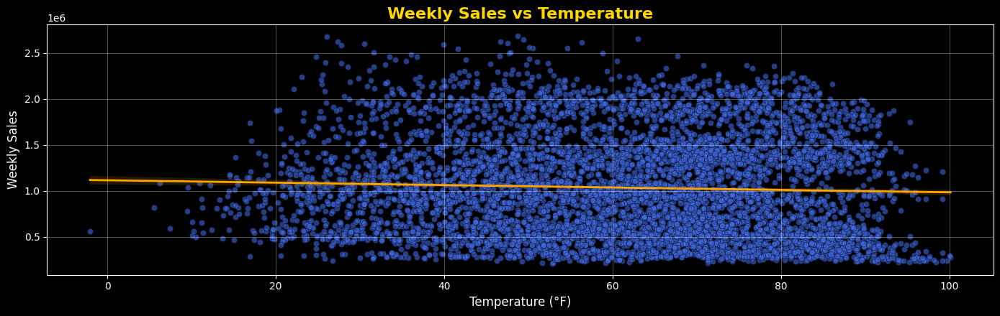

In [21]:
#--------------------------------------------
# Weekly Sales vs Temperature
#--------------------------------------------
plt.figure(figsize=(14,4.5))

sns.scatterplot(data=df, x='Temperature', y='Weekly_Sales', color='royalblue', edgecolor='black', alpha=0.6)
sns.regplot(data=df, x='Temperature', y='Weekly_Sales', scatter=False, color='orange', line_kws={'linewidth':2})

plt.title('Weekly Sales vs Temperature', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Temperature (°F)', fontsize=12, color='white')
plt.ylabel('Weekly Sales', fontsize=12, color='white')

plt.xticks(color='white')
plt.yticks(color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

In [22]:
corr_temp = df['Temperature'].corr(df['Weekly_Sales'])
if corr_temp > 0.1:
    color = Fore.GREEN
elif corr_temp < -0.1:
    color = Fore.RED
else:
    color = Fore.MAGENTA

print(Style.BRIGHT + Fore.CYAN + "\nCorrelation between Temperature and Weekly Sales:" + Style.RESET_ALL)
print(Style.BRIGHT + Fore.YELLOW + f"{color}{corr_temp:.3f}" + Style.RESET_ALL)


Correlation between Temperature and Weekly Sales:
-0.044


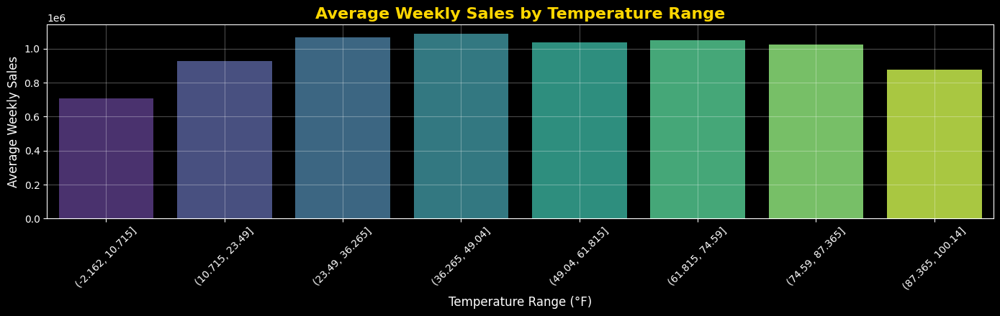

In [23]:
df['Temp_bin'] = pd.cut(df['Temperature'], bins=8)
temp_sales = df.groupby('Temp_bin')['Weekly_Sales'].mean().reset_index()

plt.figure(figsize=(14,4.5))
sns.barplot(data=temp_sales, x='Temp_bin', y='Weekly_Sales', palette='viridis')
plt.xticks(rotation=45, color='white')
plt.yticks(color='white')
plt.title('Average Weekly Sales by Temperature Range', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Temperature Range (°F)', fontsize=12, color='white')
plt.ylabel('Average Weekly Sales', fontsize=12, color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

---

## 🔍 Question 4: Impact of Consumer Price Index (CPI) on Weekly Sales  

**Objective:**  
Analyze how fluctuations in the **Consumer Price Index (CPI)** influence **weekly sales** across Walmart stores.  
Identify whether rising inflation (as indicated by CPI) leads to **higher or lower sales**, and determine if certain stores are more sensitive to these changes.

---

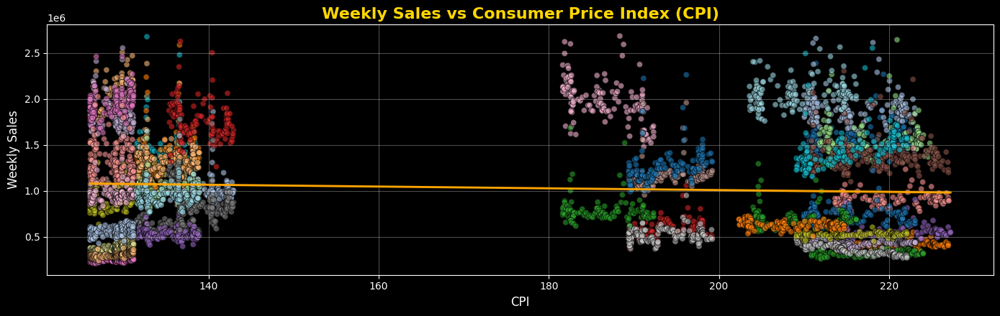

In [24]:
#--------------------------------------------
# Weekly Sales vs CPI (by Store)
#--------------------------------------------
plt.figure(figsize=(14,4.5))

sns.scatterplot(
    data=df, 
    x='CPI', 
    y='Weekly_Sales', 
    hue='Store', 
    palette='tab20', 
    legend=False,
    alpha=0.6, 
    edgecolor='black', 
    linewidth=0.7
)

sns.regplot(
    data=df, 
    x='CPI', 
    y='Weekly_Sales', 
    scatter=False, 
    color='orange', 
    line_kws={'linewidth':2}
)

plt.title('Weekly Sales vs Consumer Price Index (CPI)', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('CPI', fontsize=12, color='white')
plt.ylabel('Weekly Sales', fontsize=12, color='white')

plt.xticks(color='white')
plt.yticks(color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

In [25]:
#---------------------------
# Overall correlation
#---------------------------

corr_cpi = df['Weekly_Sales'].corr(df['CPI'])
color = Fore.GREEN if corr_cpi > 0.1 else Fore.RED if corr_cpi < -0.1 else Fore.MAGENTA
print(Style.BRIGHT + Fore.CYAN + "Overall correlation between CPI and Weekly Sales:" + Style.RESET_ALL)
print(Fore.YELLOW + f"{color}{corr_cpi:.3f}" + Style.RESET_ALL)

Overall correlation between CPI and Weekly Sales:
-0.070


In [26]:
#---------------------------
# Store-wise correlation
#---------------------------

store_corr = df.groupby('Store')[['Weekly_Sales', 'CPI']].corr().iloc[0::2,-1].reset_index()
store_corr.columns = ['Store', 'Metric', 'Correlation']

print(Style.BRIGHT + Fore.CYAN + "\nStore-wise CPI vs Weekly Sales Correlation:" + Style.RESET_ALL)
print(Fore.YELLOW + f"{'Store':<8}{'Correlation':>12}" + Style.RESET_ALL)

for _, row in store_corr.iterrows():
    corr = row['Correlation']
    color = Fore.GREEN if corr > 0.1 else Fore.RED if corr < -0.1 else Fore.MAGENTA
    print(Style.BRIGHT + Fore.WHITE + f"{int(row['Store']):<8}" + color + f"{corr:>12.3f}" + Style.RESET_ALL)



Store-wise CPI vs Weekly Sales Correlation:
Store    Correlation
1              0.225
2             -0.064
3              0.317
4              0.675
5              0.308
6              0.034
7              0.289
8              0.120
9              0.295
10            -0.130
11             0.070
12             0.084
13             0.401
14            -0.498
15            -0.174
16             0.124
17             0.349
18            -0.194
19            -0.155
20             0.204
21            -0.164
22            -0.039
23             0.137
24            -0.014
25            -0.011
26             0.132
27            -0.236
28            -0.096
29            -0.073
30            -0.298
31             0.133
32             0.197
33            -0.052
34             0.115
35            -0.424
36            -0.915
37             0.245
38             0.813
39             0.428
40             0.113
41             0.392
42             0.361
43            -0.286
44             0.740
45        

---
## 🔍 Question 5: Top Performing Stores Based on Historical Sales  

**Objective:**  
Identify the **highest performing Walmart stores** based on their **historical weekly sales**.  
This helps highlight which locations consistently generate strong revenue and may serve as benchmarks for others.

---

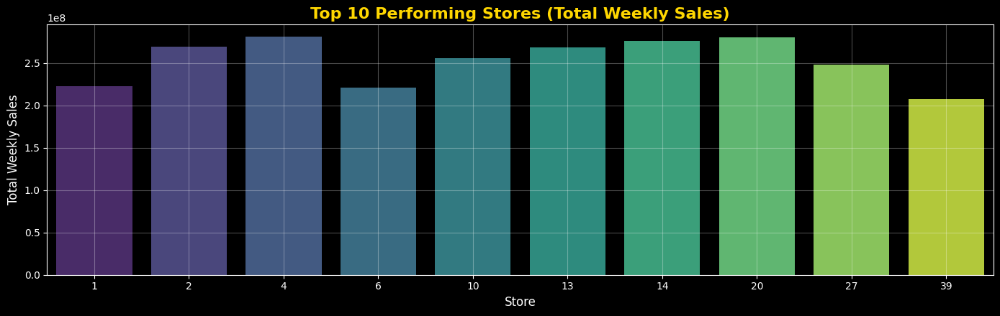


Top 10 Performing Stores by Total Weekly Sales:

Store 4   : 281,035,224.92
Store 20  : 280,023,734.81
Store 14  : 276,127,584.78
Store 2   : 268,722,063.50
Store 13  : 268,202,470.39
Store 10  : 255,678,877.44
Store 27  : 248,038,735.05
Store 1   : 222,402,808.85
Store 6   : 221,028,555.46
Store 39  : 207,445,542.47


In [27]:
#--------------------------------------------
# Top Performing Stores (Total Sales)
#--------------------------------------------

# Aggregate total sales by store
store_sales = df.groupby('Store')['Weekly_Sales'].sum().reset_index().sort_values(by='Weekly_Sales', ascending=False)

# Plot top 10 stores
plt.figure(figsize=(14,4.5))
sns.barplot(
    data=store_sales.head(10), 
    x='Store', 
    y='Weekly_Sales', 
    palette='viridis'
)

plt.title('Top 10 Performing Stores (Total Weekly Sales)', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Store', fontsize=12, color='white')
plt.ylabel('Total Weekly Sales', fontsize=12, color='white')
plt.xticks(color='white')
plt.yticks(color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

print(Style.BRIGHT + Fore.CYAN + "\nTop 10 Performing Stores by Total Weekly Sales:\n" + Style.RESET_ALL)
for i, row in store_sales.head(10).iterrows():
    print(Style.BRIGHT + Fore.YELLOW + f"Store {int(row['Store']):<3}" + Fore.GREEN + f" : {row['Weekly_Sales']:,.2f}" + Style.RESET_ALL)


---

## 🔍 Question 6: Worst Performing Store & Performance Gap  

**Objective:**  
Identify the **lowest performing Walmart store** based on historical weekly sales.  
Quantify the **performance gap** between the **highest and lowest performing stores** to understand the **extent of disparity** in sales across locations.

---

Performance Comparison of Stores:

Best Performing Store: Store 4   : 281,035,224.92
Worst Performing Store: Store 33  : 37,160,221.96
Difference between Best and Worst: 243,875,002.96 (86.78%)



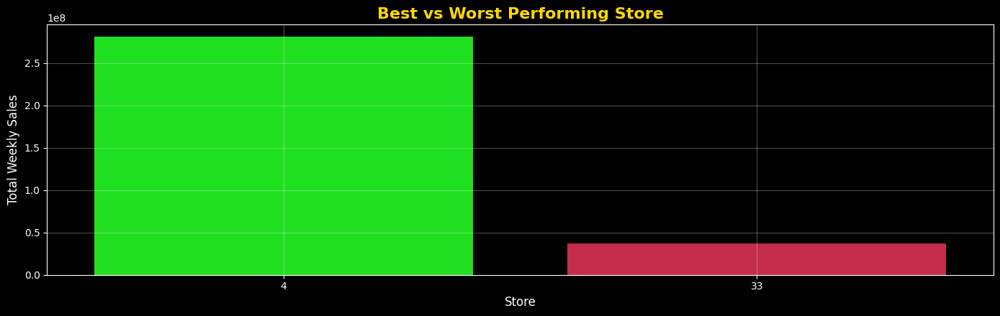

In [28]:
#--------------------------------------------
# Worst vs Best Performing Stores
#--------------------------------------------

store_sales = df.groupby('Store')['Weekly_Sales'].sum().reset_index().sort_values(by='Weekly_Sales', ascending=False)

best_store = store_sales.iloc[0]
worst_store = store_sales.iloc[-1]
diff_sales = best_store['Weekly_Sales'] - worst_store['Weekly_Sales']
diff_percent = (diff_sales / best_store['Weekly_Sales']) * 100  

# Print formatted output
print(Style.BRIGHT + Fore.CYAN + "Performance Comparison of Stores:\n" + Style.RESET_ALL)

print(Style.BRIGHT + Fore.YELLOW + f"Best Performing Store: Store {int(best_store['Store']):<3}" + 
      Fore.GREEN + f" : {best_store['Weekly_Sales']:,.2f}" + Style.RESET_ALL)

print(Style.BRIGHT + Fore.YELLOW + f"Worst Performing Store: Store {int(worst_store['Store']):<3}" + 
      Fore.RED + f" : {worst_store['Weekly_Sales']:,.2f}" + Style.RESET_ALL)

print(Style.BRIGHT + Fore.YELLOW + "Difference between Best and Worst:" + 
      Fore.MAGENTA + f" {diff_sales:,.2f} ({diff_percent:.2f}%)" + Style.RESET_ALL + '\n')

plt.figure(figsize=(14,4.5))
sns.barplot(
    data=pd.concat([store_sales.tail(1), store_sales.head(1)]), 
    x='Store', 
    y='Weekly_Sales', 
    palette=['lime','crimson']
)
plt.title('Best vs Worst Performing Store', fontsize=16, color='gold', fontweight='semibold')
plt.xlabel('Store', fontsize=12, color='white')
plt.ylabel('Total Weekly Sales', fontsize=12, color='white')
plt.xticks(color='white')
plt.yticks(color='white')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


---

## 🔮 Sales Forecasting for the Next 12 Weeks (Store-Level)  

Using predictive modeling techniques, we aim to forecast **weekly sales** for **each individual Walmart store** over the upcoming **12-week period**.  
This store-level forecasting enables Walmart to make **location-specific decisions** for inventory planning, staffing, and promotional strategies.  
The modeling process will include:
- Feature engineering  
- Model selection and training  
- Evaluation and visualization of predictions  


---

## 🧭 Strategy: Modeling Approaches for Sales Forecasting  

To forecast weekly sales for each store, we consider two primary modeling strategies:

---

### Option A: Time Series Modeling  
Model each store’s sales as a time-dependent sequence.  
**Techniques:**  
- ARIMA  
- SARIMA  
- Prophet  
- LSTM (for deep learning-based forecasting)

---

### Option B: Regression-Based Modeling  
Treat each row as an independent sample with engineered features.  
**Features may include:**  
- Date components (Month, Week, Year)  
- Store ID  
- CPI, Fuel Price, Unemployment  
- Holiday Flag, Temperature  

**Technique Implemented:**  
- ✅ **XGBoost** (with GPU acceleration)  

We began with **Option B (Regression)** using XGBoost for its scalability, speed, and interpretability.  
This approach allowed us to evaluate predictions on the final 12 weeks of known data.  
However, since regression relies on engineered features, it cannot forecast future weeks unless those features are explicitly constructed.

---

Next, we pivot to **Option A (Time Series Modeling)** to generate true forecasts without relying on external features.


---

## 🧪 Step 1: Feature Engineering  

To prepare the dataset for regression modeling, we extract **time-based features** from the `Date` column:  
- `Month`: Captures seasonal effects  
- `Week`: Captures weekly patterns  
- `Year`: Helps model long-term trends  

We also ensure that `Store` is treated as a **categorical variable**, allowing the model to learn store-specific patterns.

---

In [29]:
# ----------------------------
# 1. Basic datetime features
# ----------------------------

df['Year']  = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Week']  = df['Date'].dt.isocalendar().week.astype(int)  
df['Day']   = df['Date'].dt.day
df['DayOfWeek'] = df['Date'].dt.dayofweek   
df['Quarter'] = df['Date'].dt.quarter

df['month_sin'] = np.sin(2 * np.pi * df['Month'] / 12)
df['month_cos'] = np.cos(2 * np.pi * df['Month'] / 12)
df['dow_sin']   = np.sin(2 * np.pi * df['DayOfWeek'] / 7)
df['dow_cos']   = np.cos(2 * np.pi * df['DayOfWeek'] / 7)

# ----------------------------------------
# 2. Holiday Proximity Features
# ----------------------------------------

df = df.sort_values(['Store', 'Date']).copy()
df['is_holiday'] = df['Holiday_Flag'].astype(int)

# Last holiday date per store
df['last_holiday_date'] = (
    df.groupby('Store')['Date']
      .transform(lambda x: x.where(df.loc[x.index, 'is_holiday'] == 1).ffill())
)

# Next holiday date per store
df['next_holiday_date'] = (
    df.groupby('Store')['Date']
      .transform(lambda x: x.where(df.loc[x.index, 'is_holiday'] == 1).bfill())
)

df['days_since_holiday'] = (df['Date'] - df['last_holiday_date']).dt.days.fillna(9999)
df['days_until_holiday'] = (df['next_holiday_date'] - df['Date']).dt.days.fillna(9999)

df = df.drop(['last_holiday_date', 'next_holiday_date'], axis=1)

In [30]:
from sklearn.preprocessing import LabelEncoder

store_ohe = pd.get_dummies(
    df['Store'].astype(str),
    prefix='Store',
    drop_first=True
)

le = LabelEncoder()
df['Store_LE'] = le.fit_transform(df['Store'])

---

## 🧪 Step 2: Train-Test Split (Chronological)  

To simulate real-world forecasting, we split the dataset **chronologically**:  
- The **training set** includes all data up to 12 weeks before the latest date.  
- The **testing set** includes the most recent 12 weeks, representing the future period we aim to predict.

This approach avoids data leakage and ensures the model learns only from past data.


---

In [31]:
df = df.sort_values('Date')
cutoff_date = df['Date'].max() - pd.Timedelta(weeks=12)

train = df[df['Date'] <= cutoff_date].copy()
test  = df[df['Date'] > cutoff_date].copy()

---
## 🧪 Step 3: Feature Selection & GPU-Accelerated Model Training  

We selected a set of engineered features to train our regression model:  
- Store ID (encoded), Month, Week, Year  
- Holiday flag, Temperature, Fuel Price, CPI, Unemployment  
- Cyclical encodings for Month and Day of Week  
- Holiday proximity indicators: days since and until next holiday  

To ensure fast and scalable training, we used **XGBoost with GPU acceleration**:  
- `tree_method='gpu_hist'` enables efficient histogram-based training on GPU  
- `predictor='gpu_predictor'` ensures GPU is used during inference  

This setup allows the model to capture complex patterns in weekly sales while significantly reducing training time.


---

In [32]:
import xgboost as xgb

features = [
    'Store_LE', 'Month', 'Week', 'Year', 'Holiday_Flag',
    'Temperature', 'Fuel_Price', 'CPI', 'Unemployment',
    'month_sin', 'month_cos', 'dow_sin', 'dow_cos',
    'is_holiday', 'days_since_holiday', 'days_until_holiday'
]

X_train = train[features]
y_train = train['Weekly_Sales']

X_test = test[features]
y_test = test['Weekly_Sales']

model = xgb.XGBRegressor(
    tree_method='gpu_hist',      
    predictor='gpu_predictor',   
    n_estimators=100,
    max_depth=6,
    learning_rate=0.1,
    random_state=42
)

model.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor='gpu_predictor', ...)

---

## 🧪 Step 4: Prediction & Evaluation  

After training the **XGBoost model with GPU acceleration**, we generated predictions for the test set (last 12 weeks).  
To evaluate performance, we calculated the following metrics:

- **Mean Absolute Error (MAE):** $71,596.74$  
- **Mean Squared Error (MSE):** $9,090,788,833.72$  
- **R² Score:** $0.97$  

These metrics help assess how close the predictions are to actual sales values and how well the model generalizes.  
A high R² score indicates strong predictive power, while MAE and MSE highlight the average and squared errors respectively.

---

In [33]:
from sklearn.metrics import *

predictions = model.predict(X_test)
test['Predicted_Sales'] = predictions

mae = mean_absolute_error(y_test, predictions)
mse = mean_squared_error(y_test, predictions)
r2_score = r2_score(y_test, predictions)
print(Style.BRIGHT + Fore.CYAN + 'Mean Absolute Error (MAE): ' + Fore.YELLOW + f"{mae:.2f}" + Style.RESET_ALL)
print(Style.BRIGHT + Fore.CYAN + 'Mean Squared Error (MSE): ' + Fore.YELLOW + f"{mse:.2f}" + Style.RESET_ALL)
print(Style.BRIGHT + Fore.CYAN + 'R² Score: ' + Fore.YELLOW + f"{r2_score:.2f}" + Style.RESET_ALL)

Mean Absolute Error (MAE): 71596.74
Mean Squared Error (MSE): 9090788833.72
R² Score: 0.97


---

## 🧪 Step 5: Store-Level Visualization Across All 45 Stores  

To assess model performance visually, we plotted **actual vs predicted weekly sales** for **all 45 stores**, sorted in ascending order from Store 1 to Store 45.  

Each plot compares actual and predicted sales over the final 12-week test period:  
- 🟢 Actual sales are shown with green circles  
- 🔵 Predicted sales are shown with blue X markers and dashed lines  

This comprehensive visualization helps identify:  
- Stores with strong prediction accuracy  
- Time periods with under- or over-prediction  
- Seasonal or holiday-related deviations  

By looping through each store individually, we ensured a detailed and transparent evaluation of model performance across the entire Walmart network.

---

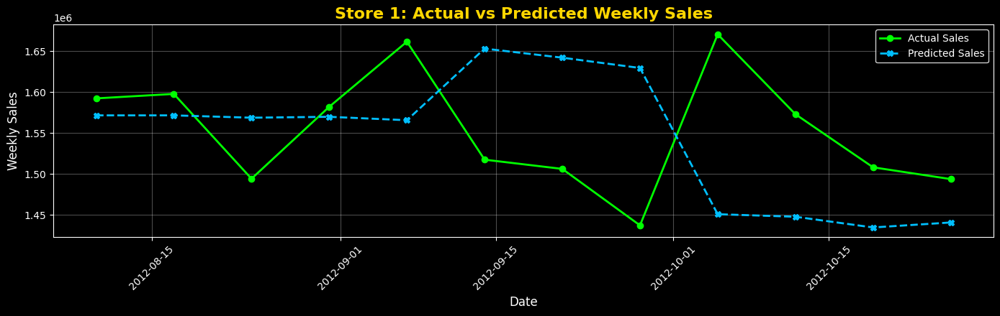

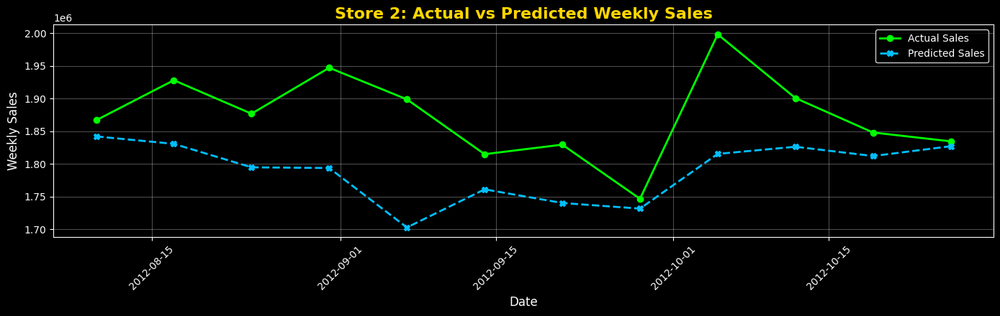

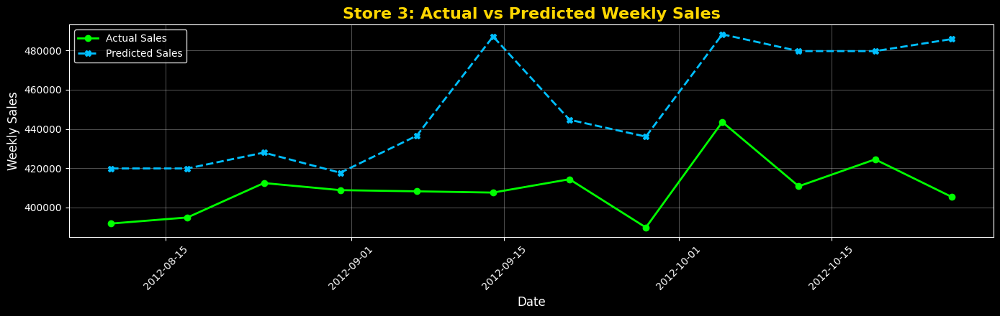

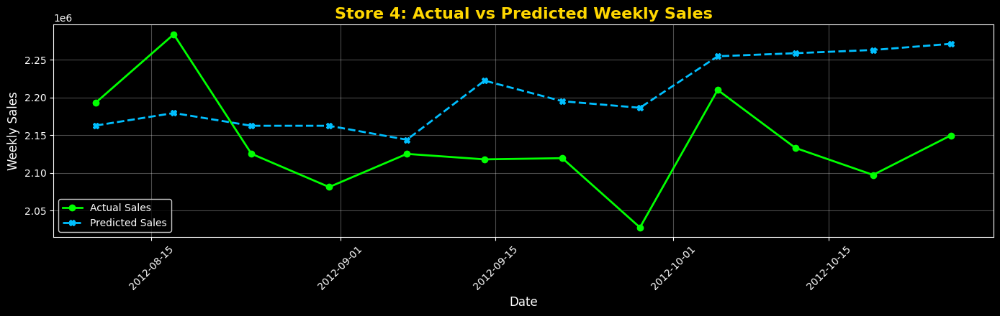

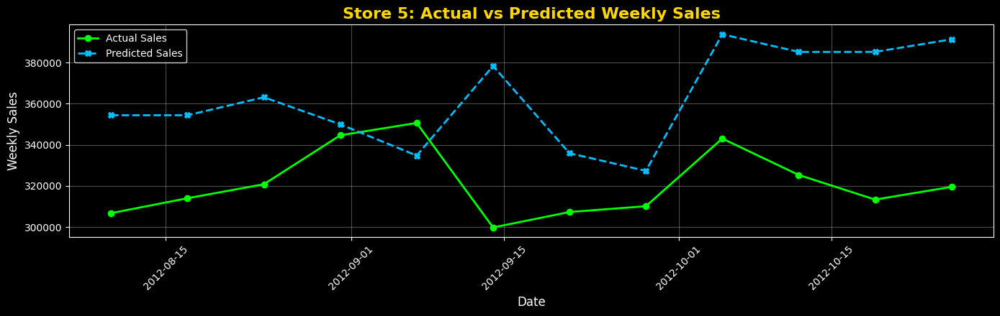

...

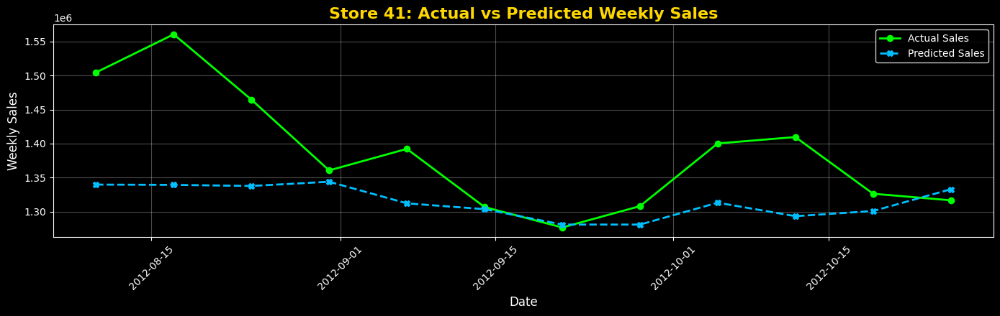

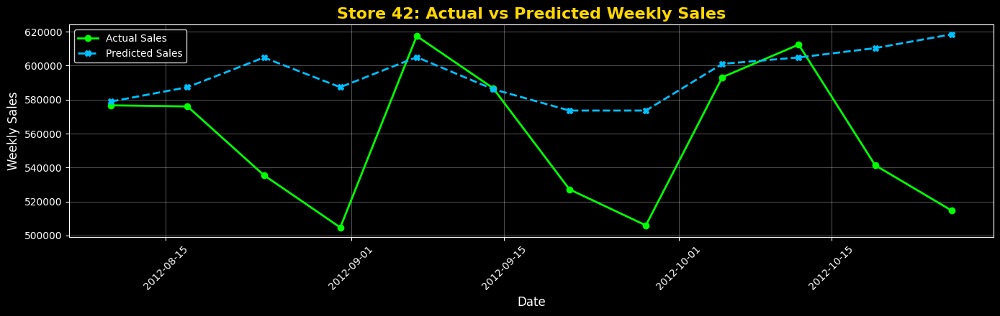

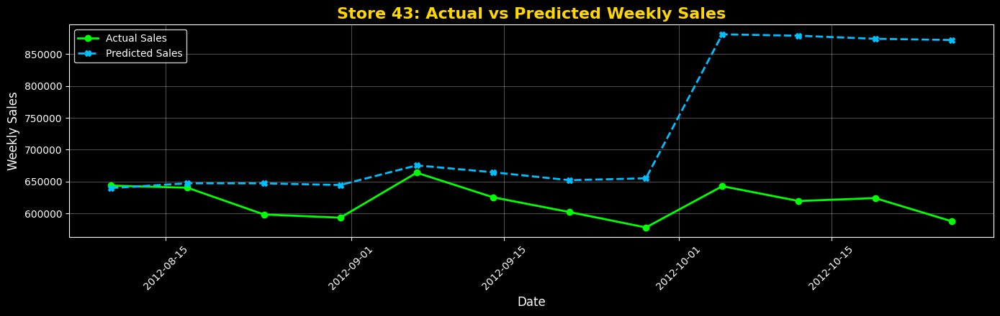

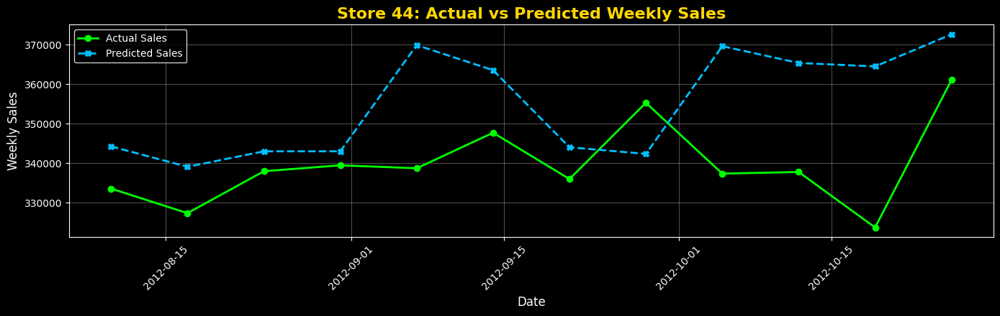

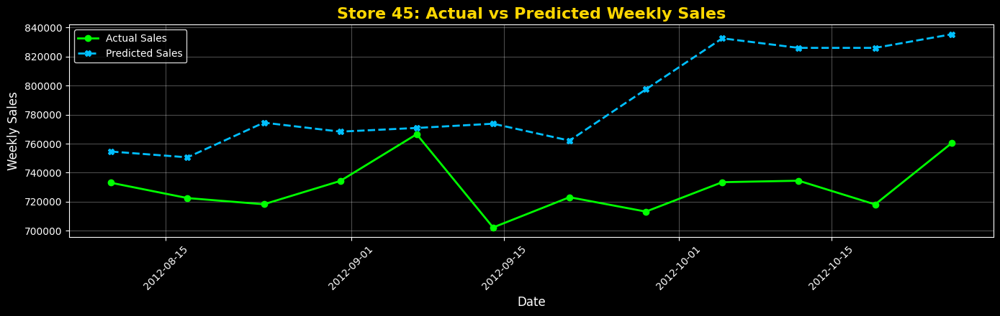

In [34]:
store_ids = sorted(test['Store'].unique())  # Ascending order

for store_id in store_ids:
    store_data = test[test['Store'] == store_id]

    plt.figure(figsize=(14, 4.5))

    # Actual sales
    plt.plot(
        store_data['Date'], 
        store_data['Weekly_Sales'], 
        label='Actual Sales', 
        marker='o', 
        markersize=6, 
        color='lime', 
        linewidth=2
    )

    # Predicted sales
    plt.plot(
        store_data['Date'], 
        store_data['Predicted_Sales'], 
        label='Predicted Sales', 
        marker='X', 
        markersize=6, 
        color='deepskyblue', 
        linestyle='--', 
        linewidth=2
    )

    plt.title(f'Store {store_id}: Actual vs Predicted Weekly Sales', fontsize=16, color='gold', fontweight='semibold')
    plt.xlabel('Date', fontsize=12, color='white')
    plt.ylabel('Weekly Sales', fontsize=12, color='white')

    plt.xticks(rotation=45, color='white')
    plt.yticks(color='white')

    plt.legend(facecolor='black', edgecolor='white', labelcolor='white')
    plt.grid(alpha=0.3)

    plt.tight_layout()
    plt.show()

---

## 🧪 Step 7: Tabular Summary of Predictions Across All Stores  

To complement our visual analysis, we created a table showing **actual vs predicted weekly sales** for all 45 stores.  
The table includes:
- Store ID  
- Date  
- Actual Weekly Sales  
- Predicted Weekly Sales  

This tabular format allows for quick inspection, filtering, and export for further analysis or reporting.

---

In [35]:
prediction_table = test[['Store', 'Date', 'Weekly_Sales', 'Predicted_Sales']]

prediction_table = prediction_table.sort_values(by=['Store', 'Date']).reset_index(drop=True)

print(Style.BRIGHT + Fore.CYAN + f'{prediction_table.shape}' + Style.RESET_ALL + '\n')
print(Style.BRIGHT + Fore.YELLOW + f'{prediction_table.head(24)}' + Style.RESET_ALL)  # Showng 12 Weeks predictions of Store 1 & 2

(540, 4)

    Store       Date  Weekly_Sales  Predicted_Sales
0       1 2012-08-10    1592409.97      1571631.500
1       1 2012-08-17    1597868.05      1571631.500
2       1 2012-08-24    1494122.38      1568764.750
3       1 2012-08-31    1582083.40      1569869.500
4       1 2012-09-07    1661767.33      1565698.375
5       1 2012-09-14    1517428.87      1653307.500
6       1 2012-09-21    1506126.06      1642206.625
7       1 2012-09-28    1437059.26      1629599.750
8       1 2012-10-05    1670785.97      1450705.250
9       1 2012-10-12    1573072.81      1447605.625
10      1 2012-10-19    1508068.77      1434483.750
11      1 2012-10-26    1493659.74      1440601.750
12      2 2012-08-10    1866719.96      1841994.375
13      2 2012-08-17    1928016.01      1830622.625
14      2 2012-08-24    1876788.15      1794698.125
15      2 2012-08-31    1947083.30      1793609.750
16      2 2012-09-07    1898777.07      1702612.125
17      2 2012-09-14    1814806.63      1760986.500
18

---

# 🧭 Strategy Shift: Time Series Modeling for Weekly Sales Forecasting

Having completed Option B (Regression-Based Modeling) with strong performance using XGBoost, we now pivot to **Option A: Time Series Modeling** to capture deeper temporal patterns in weekly sales.

## 🎯 Objective

Model each store’s weekly sales as a time-dependent sequence to uncover trends, seasonality, and holiday effects more explicitly.

## 🧪 Techniques to Explore

We will implement and compare the following time series models:

1. **ARIMA** – Autoregressive Integrated Moving Average  
   - Captures autoregression, differencing, and moving average components  
   - Assumes stationarity or transforms data to achieve it  

2. **SARIMA** – Seasonal ARIMA  
   - Extends ARIMA with seasonal terms  
   - Ideal for weekly or monthly seasonal patterns  

3. **Prophet** – Additive time series model by Meta  
   - Automatically detects seasonality, holidays, and trend shifts  
   - Robust to missing data and outliers  

4. **LSTM** – Long Short-Term Memory neural network  
   - Deep learning model for sequential data  
   - Captures long-term dependencies and nonlinear patterns  

## 🧱 Modeling Setup

- We will begin with **Store 1** as a baseline and apply each model individually.  
- Weekly sales will be treated as a univariate time series.  

---

Let’s begin with **ARIMA** and walk through stationarity checks, differencing, model fitting, and forecasting.

✅ Time Series Prepared for Store1
Date Range:2010-02-07→2012-10-28
Total Weeks:143
Missing Weeks:0
Average Weekly Sales:1555264.4


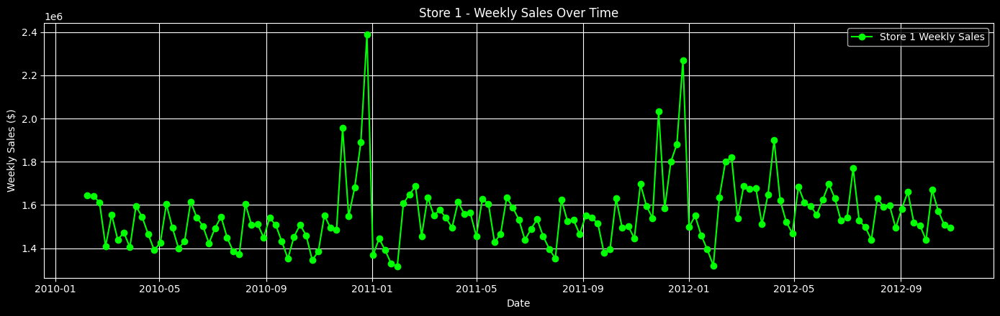

In [36]:
# ----------------------------------------
# Prepare Time Series for Store 1
# ----------------------------------------

store_id = 1
store_ts = df[df['Store'] == store_id].copy()

store_ts = store_ts.sort_values('Date')

store_ts = store_ts.set_index('Date')

ts = store_ts['Weekly_Sales'].resample('W').sum()

print(Style.BRIGHT + Fore.GREEN + "✅ Time Series Prepared for Store" + Style.RESET_ALL + Fore.YELLOW + f'{store_id}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.GREEN + "Date Range:" + Fore.YELLOW + f'{ts.index.min().date()}' + Fore.RED + "→" + Fore.YELLOW + f'{ts.index.max().date()}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.GREEN + "Total Weeks:" + Fore.YELLOW + f'{len(ts)}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.GREEN + "Missing Weeks:" + Fore.YELLOW + f'{ts.isna().sum()}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.GREEN + "Average Weekly Sales:" + Fore.YELLOW + f'{round(ts.mean(), 2)}' + Style.RESET_ALL)

plt.figure(figsize=(14, 4.5))
plt.plot(ts, label=f'Store {store_id} Weekly Sales', color='lime', marker='o')
plt.title(f'Store {store_id} - Weekly Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Weekly Sales ($)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


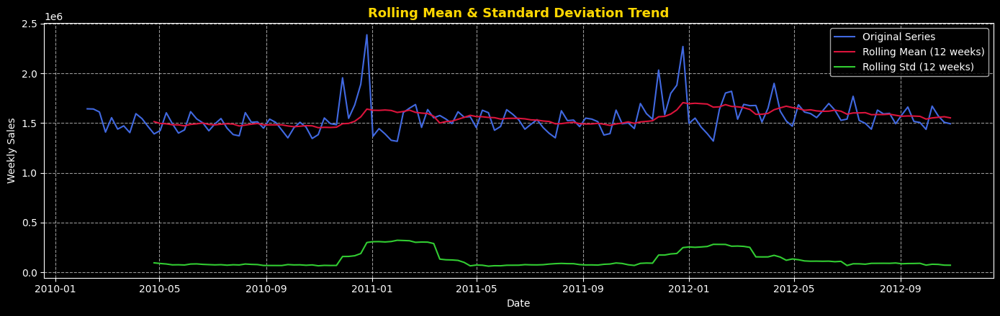


📊 Augmented Dickey-Fuller Test Results
------------------------------------------------------------
Test Statistic           : -5.1022
p-value                  : 0.0000
# Lags Used              : 4.0000
# Observations Used      : 138.0000
Critical Value (1%)      : -3.4786
Critical Value (5%)      : -2.8827
Critical Value (10%)     : -2.5781
------------------------------------------------------------

✅ The series is likely STATIONARY (p < 0.05)


In [37]:
# ----------------------------------------
# Check Stationarity
# ----------------------------------------

from statsmodels.tsa.stattools import adfuller
from colorama import Fore, Style

rolmean = ts.rolling(window=12).mean()
rolstd  = ts.rolling(window=12).std()

plt.figure(figsize=(14, 4.5))
plt.plot(ts, color='royalblue', label='Original Series')
plt.plot(rolmean, color='crimson', label='Rolling Mean (12 weeks)')
plt.plot(rolstd, color='limegreen', label='Rolling Std (12 weeks)')
plt.title('Rolling Mean & Standard Deviation Trend', fontsize=13, fontweight='semibold', color='gold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend(loc='best')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

print(Style.BRIGHT + Fore.YELLOW + "\n📊 Augmented Dickey-Fuller Test Results" + Style.RESET_ALL)
adf_test = adfuller(ts.dropna(), autolag='AIC')

adf_results = pd.Series(adf_test[0:4], index=['Test Statistic', 'p-value', '# Lags Used', '# Observations Used'])
for key, value in adf_test[4].items():
    adf_results[f'Critical Value ({key})'] = value

print(Fore.CYAN + '-'*60 + Style.RESET_ALL)
for key, value in adf_results.items():
    color = Fore.GREEN if 'Critical' not in key else Fore.MAGENTA
    print(f"{color}{key:<25}: {value:.4f}" + Style.RESET_ALL)
print(Fore.CYAN + '-'*60 + Style.RESET_ALL)

if adf_results['p-value'] < 0.05:
    print(Style.BRIGHT + Fore.GREEN + "\n✅ The series is likely STATIONARY (p < 0.05)" + Style.RESET_ALL)
else:
    print(Style.BRIGHT + Fore.RED + "\n⚠️ The series is NON-STATIONARY (p ≥ 0.05). Differencing needed." + Style.RESET_ALL)

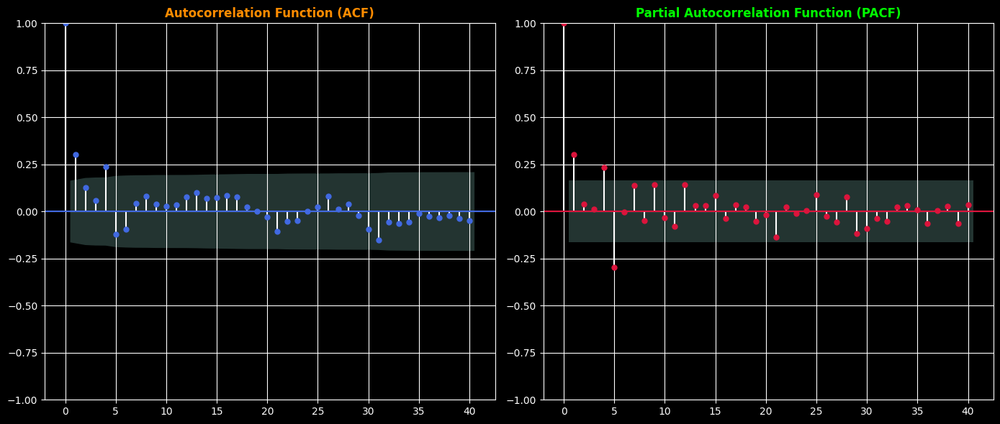

In [38]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plt.figure(figsize=(14,6))

plt.subplot(1,2,1)
plot_acf(ts, lags=40, ax=plt.gca(), color='royalblue')
plt.title('Autocorrelation Function (ACF)', fontsize=12, color='darkorange', fontweight='semibold')
plt.grid(True)

plt.subplot(1,2,2)
plot_pacf(ts, lags=40, ax=plt.gca(), color='crimson', method='ywm')
plt.title('Partial Autocorrelation Function (PACF)', fontsize=12, color='lime', fontweight='semibold')
plt.grid(True)

plt.tight_layout()
plt.show()

In [39]:
!pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 698.0/698.0 kB 10.8 MB/s eta 0:00:00 0:00:01


In [40]:
import pmdarima as pm

auto_model = pm.auto_arima(
    ts,
    seasonal=False,        
    stepwise=True,         
    trace=True         
)

print(auto_model.summary())

# Best parameters
print("Best ARIMA order:", auto_model.order)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3819.024, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3850.005, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3838.724, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3831.432, Time=0.03 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3848.013, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3819.410, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3821.284, Time=0.09 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3817.475, Time=0.12 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3818.117, Time=0.13 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.38 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=3810.990, Time=0.18 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3809.486, Time=0.15 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3810.431, Time=0.17 sec
 ARIMA(2,1,4)(0,0,0)[0] intercept   : AIC=3810.637, Time=0.22 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : 

In [41]:
from statsmodels.tsa.arima.model import ARIMA

arima_model = ARIMA(ts, order=(2, 1, 3))
arima_result = arima_model.fit()

print(arima_result.summary())

                               SARIMAX Results                                
Dep. Variable:           Weekly_Sales   No. Observations:                  143
Model:                 ARIMA(2, 1, 3)   Log Likelihood               -1897.843
Date:                Mon, 15 Dec 2025   AIC                           3807.686
Time:                        07:53:01   BIC                           3825.421
Sample:                    02-07-2010   HQIC                          3814.893
                         - 10-28-2012                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7500      0.127     -5.919      0.000      -0.998      -0.502
ar.L2         -0.3101      0.128     -2.420      0.016      -0.561      -0.059
ma.L1          0.2867      0.118      2.427      0.0

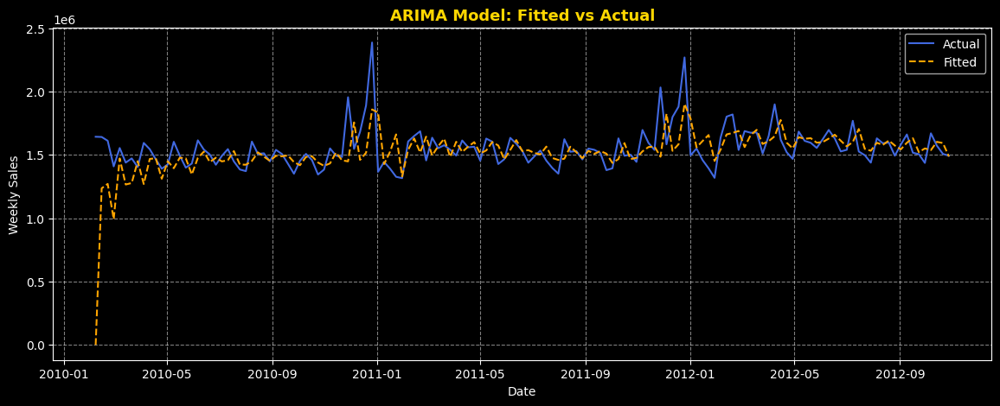

In [42]:
plt.figure(figsize=(14,5))
plt.plot(ts, color='royalblue', label='Actual')
plt.plot(arima_result.fittedvalues, color='orange', linestyle='--', label='Fitted')
plt.title('ARIMA Model: Fitted vs Actual', fontsize=13, fontweight='semibold', color='gold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

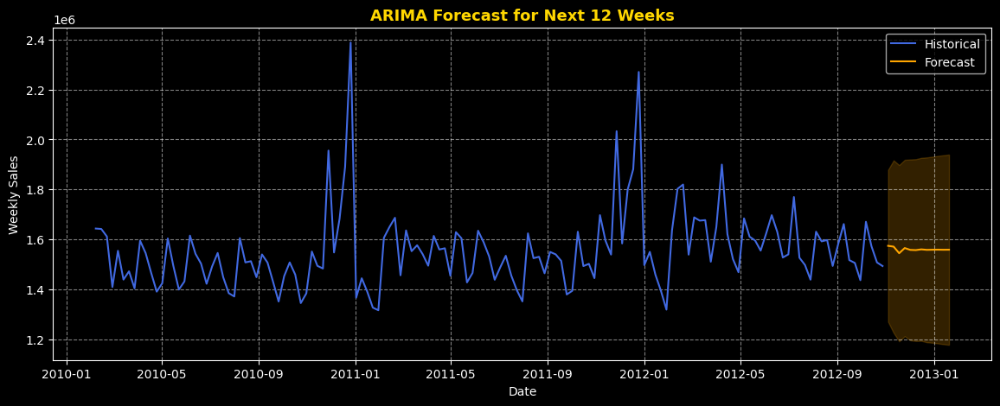

In [43]:
forecast_steps = 12
forecast = arima_result.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=ts.index[-1] + pd.Timedelta(weeks=1), periods=forecast_steps, freq='W')
forecast_mean = forecast.predicted_mean
forecast_ci = forecast.conf_int()

plt.figure(figsize=(14,5))
plt.plot(ts, color='royalblue', label='Historical')
plt.plot(forecast_index, forecast_mean, color='orange', label='Forecast')
plt.fill_between(forecast_index, forecast_ci.iloc[:,0], forecast_ci.iloc[:,1], color='orange', alpha=0.2)
plt.title('ARIMA Forecast for Next 12 Weeks', fontsize=13, fontweight='semibold', color='gold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [44]:
forecast_results = []

store_ids = sorted(df['Store'].unique())

for store_id in store_ids:
    store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
    store_data = store_data.sort_values('Date')
    store_data.set_index('Date', inplace=True)

    ts = store_data['Weekly_Sales'].resample('W').sum()

    ts = ts.interpolate()

    try:
        model = ARIMA(ts, order=(2, 1, 3))
        result = model.fit()

        forecast_steps = 12
        forecast = result.get_forecast(steps=forecast_steps)
        forecast_mean = forecast.predicted_mean

        forecast_index = pd.date_range(start=ts.index[-1] + pd.Timedelta(weeks=1), periods=forecast_steps, freq='W')

        forecast_df = pd.DataFrame({
            'Store': store_id,
            'Date': forecast_index,
            'Forecasted_Sales': forecast_mean
        })

        forecast_results.append(forecast_df)

    except Exception as e:
        print(f"⚠️ Store {store_id} failed to forecast: {e}")

all_forecasts = pd.concat(forecast_results).reset_index(drop=True)

print(all_forecasts.head())

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


   Store       Date  Forecasted_Sales
0      1 2012-11-04      1.574583e+06
1      1 2012-11-11      1.571373e+06
2      1 2012-11-18      1.544934e+06
3      1 2012-11-25      1.565757e+06
4      1 2012-12-02      1.558339e+06


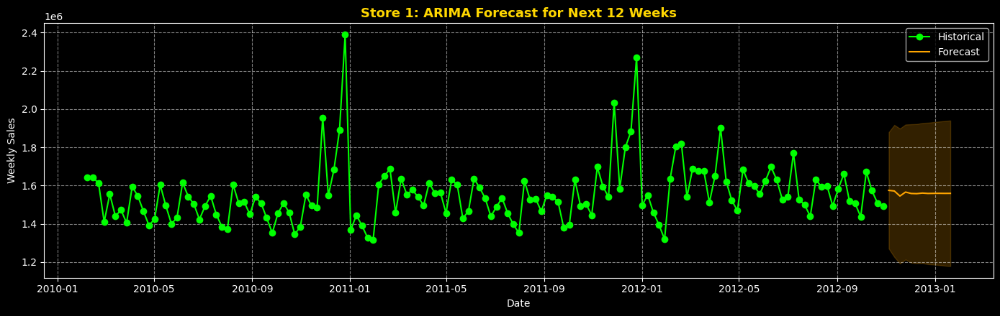

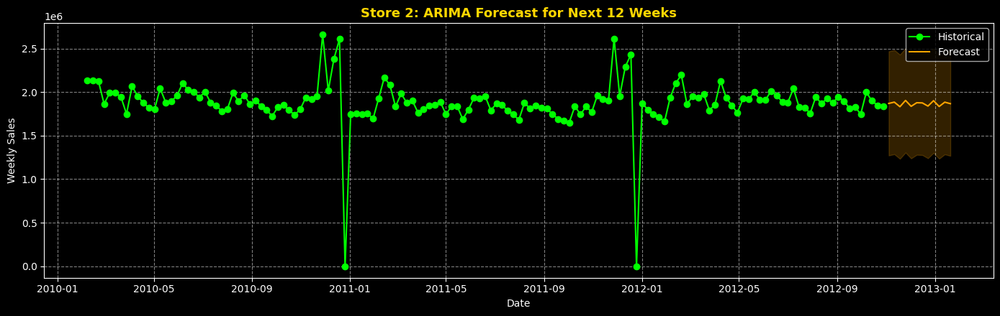

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


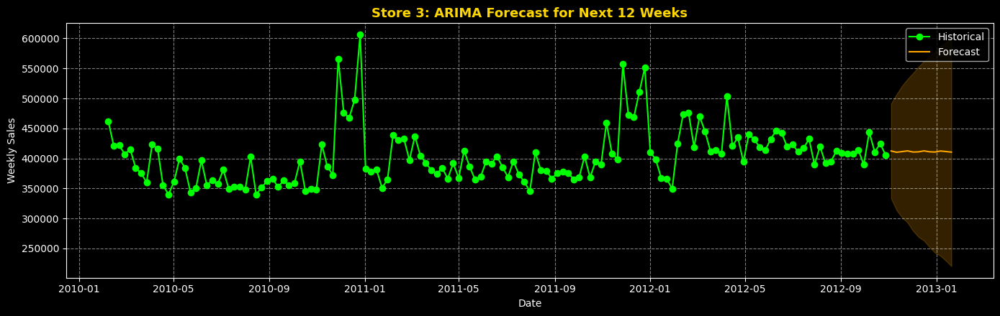

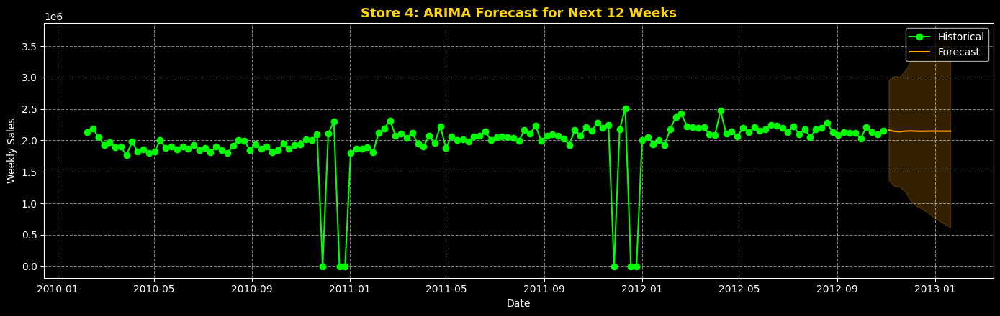

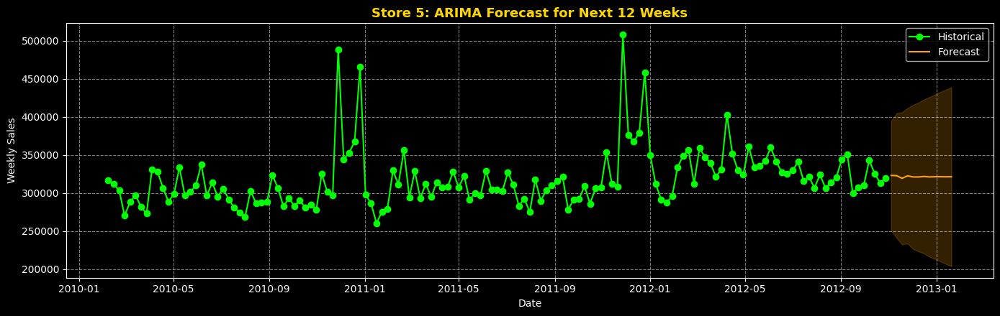

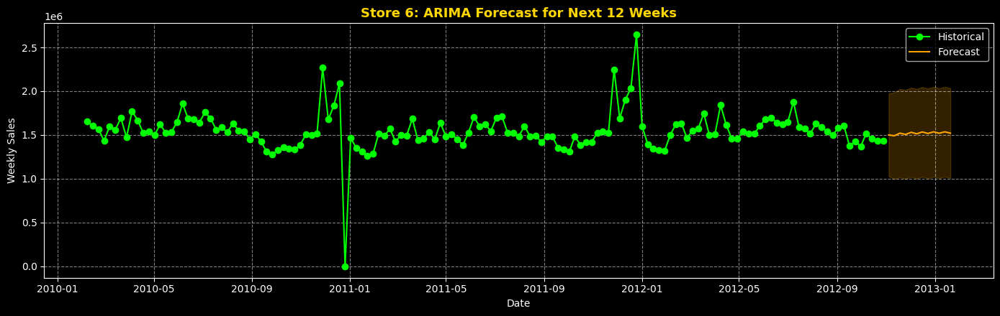

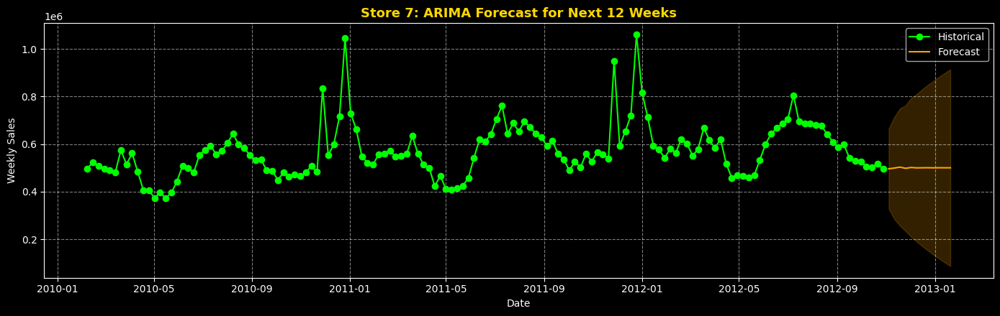

...

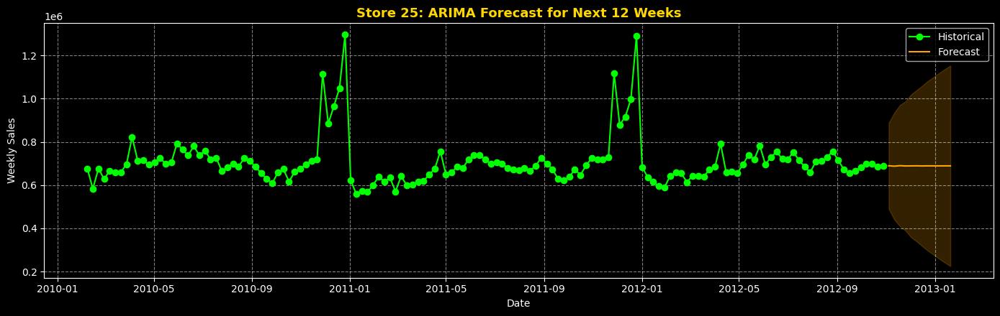

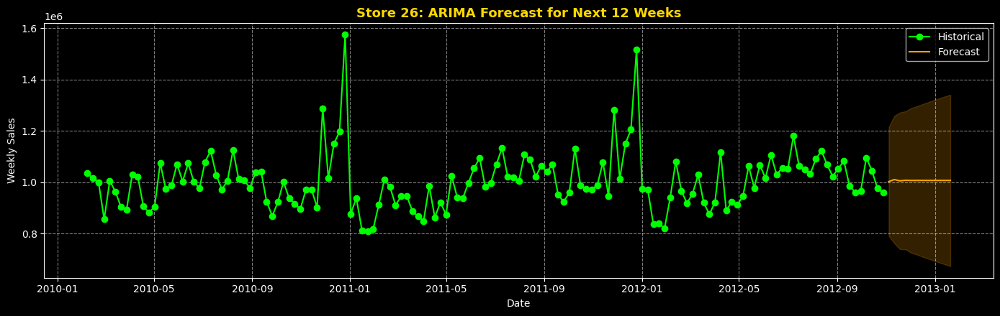

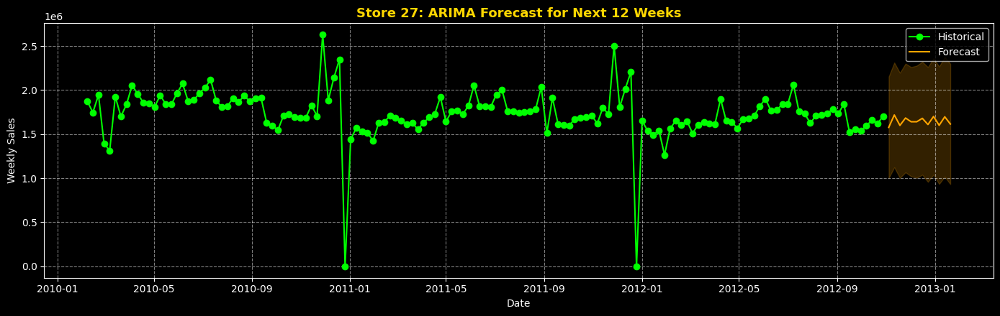

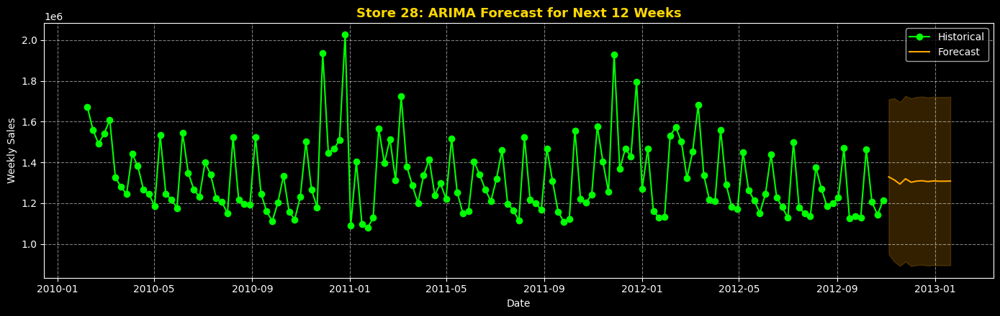

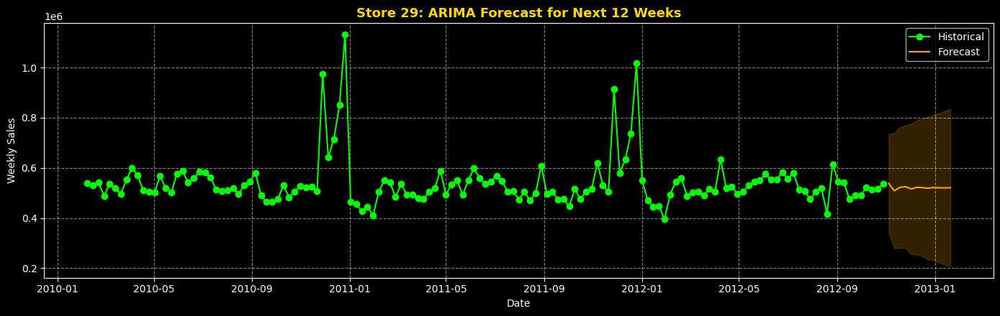

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


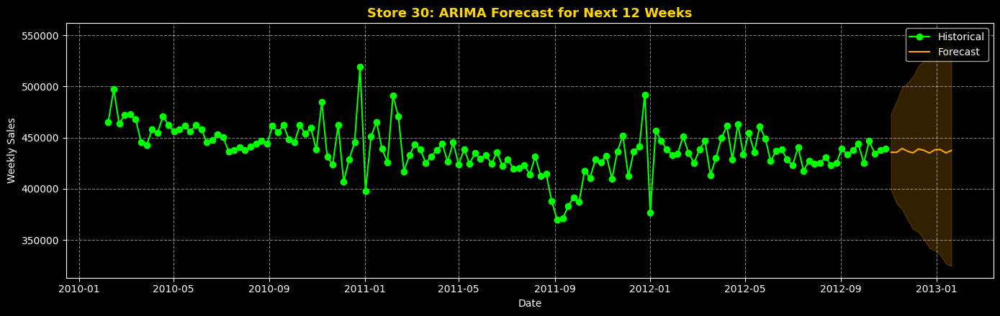

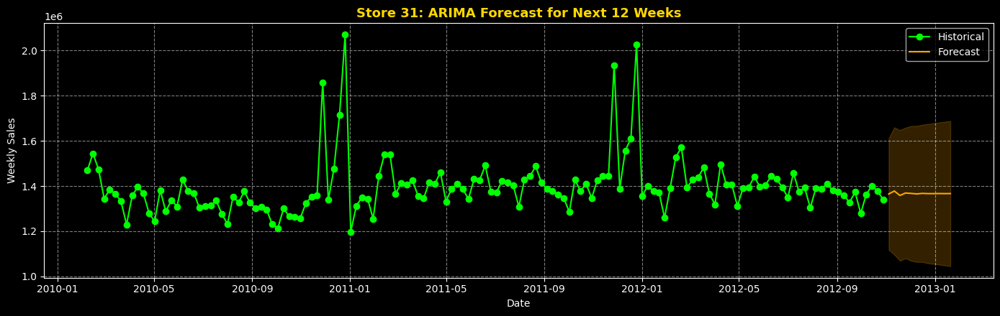

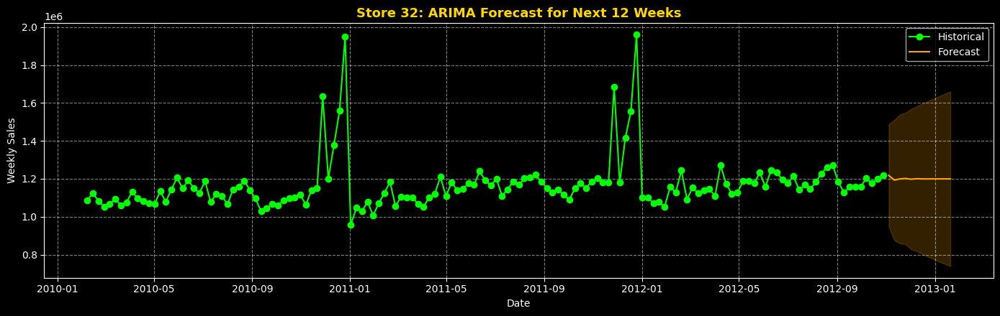

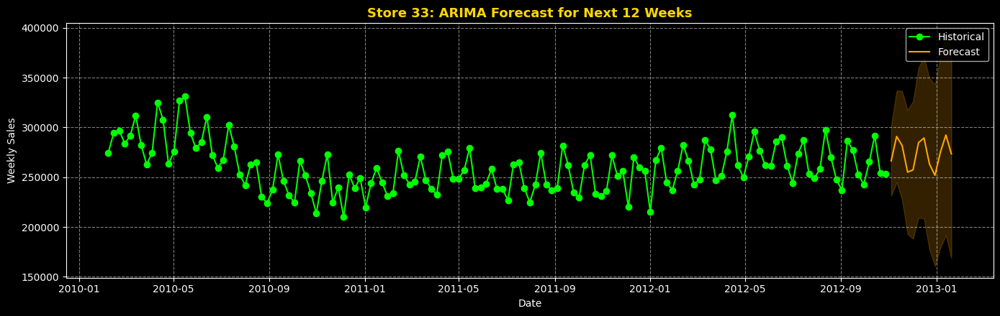

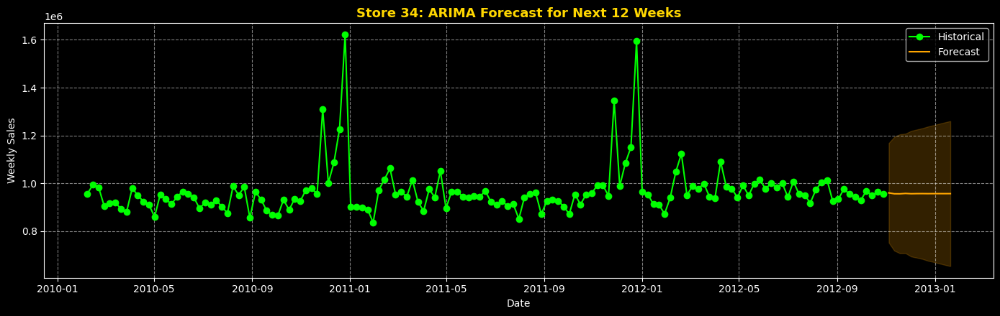

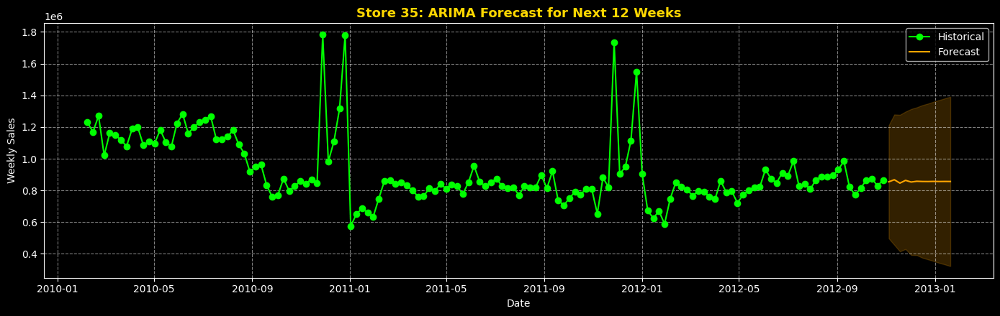

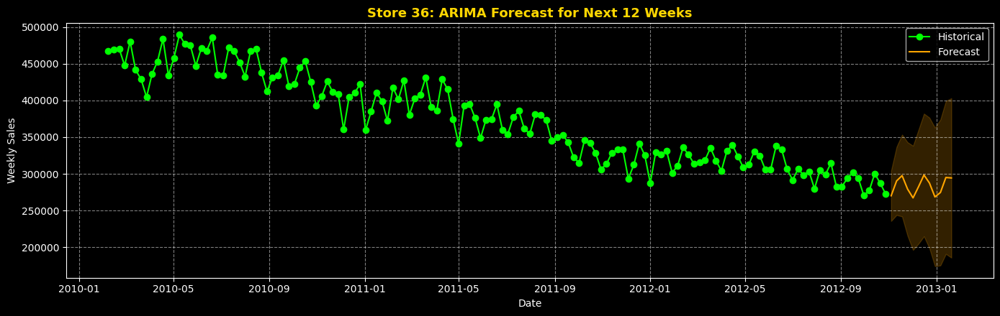

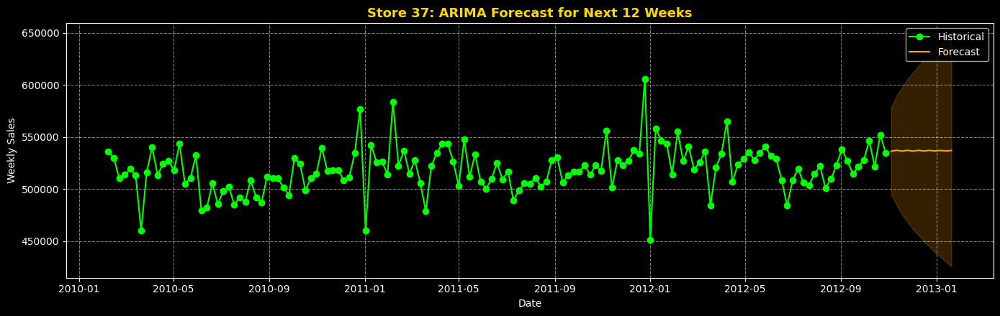

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


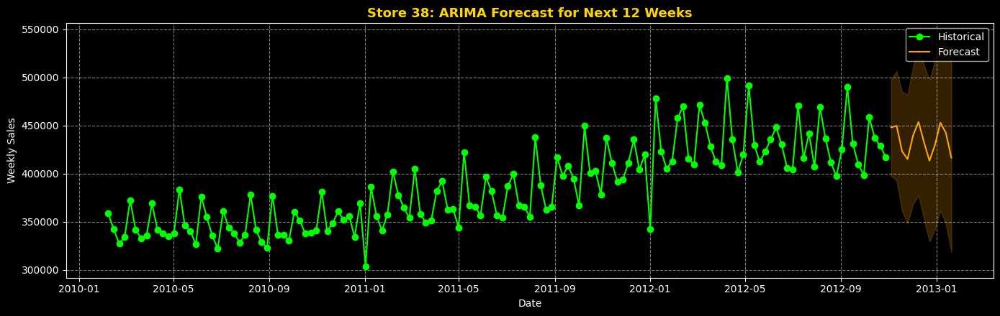

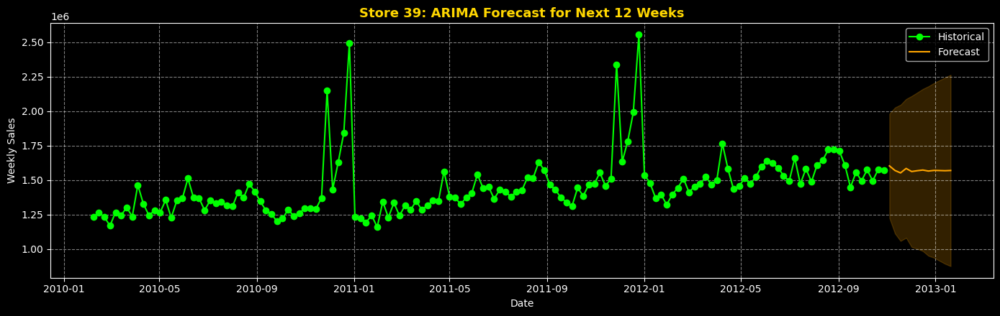

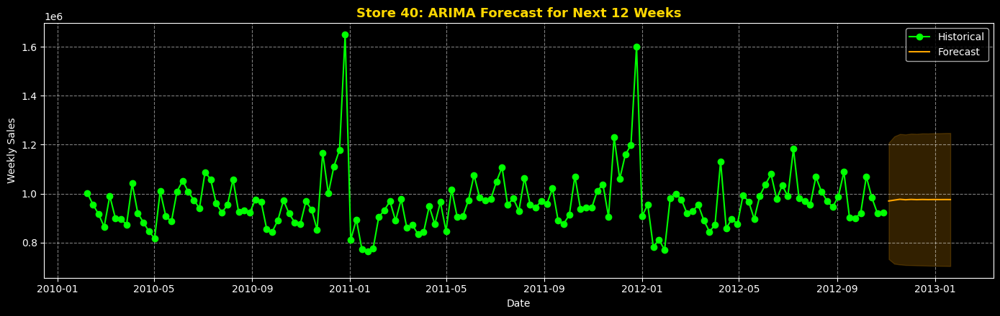

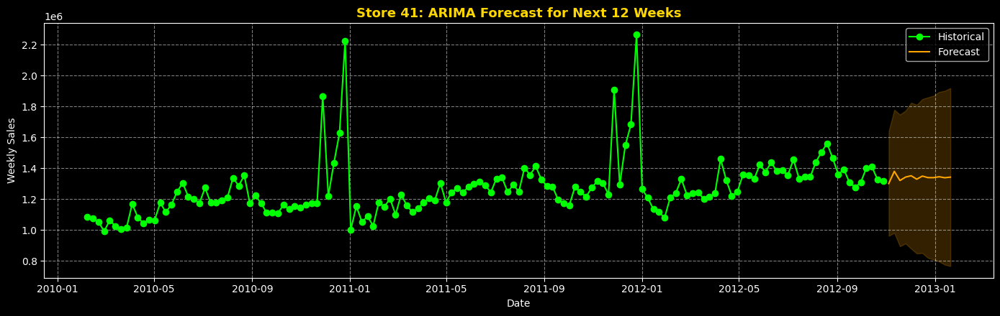

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


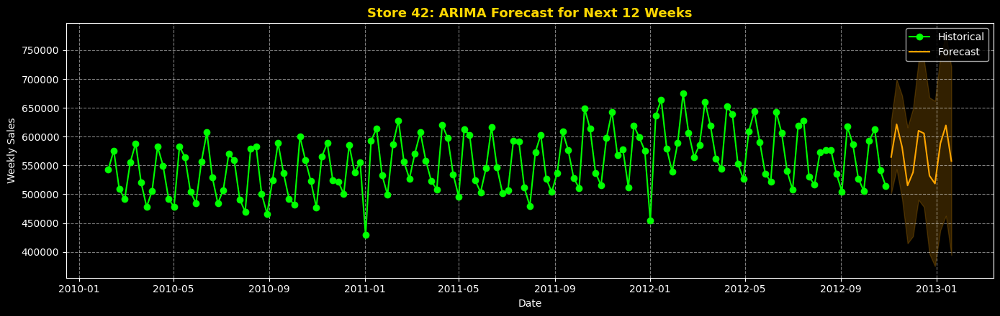

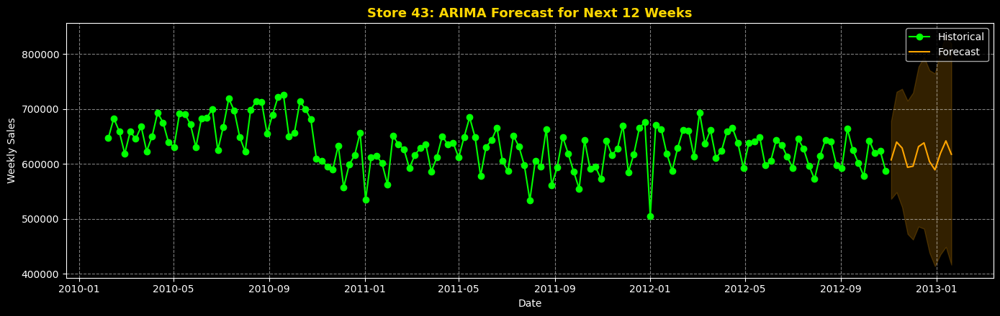

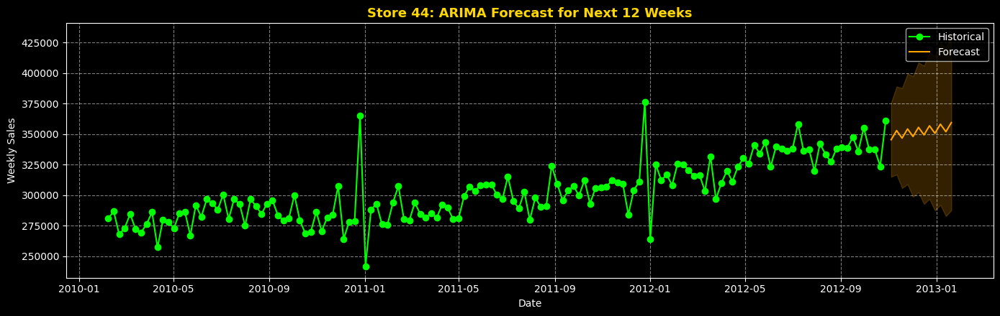

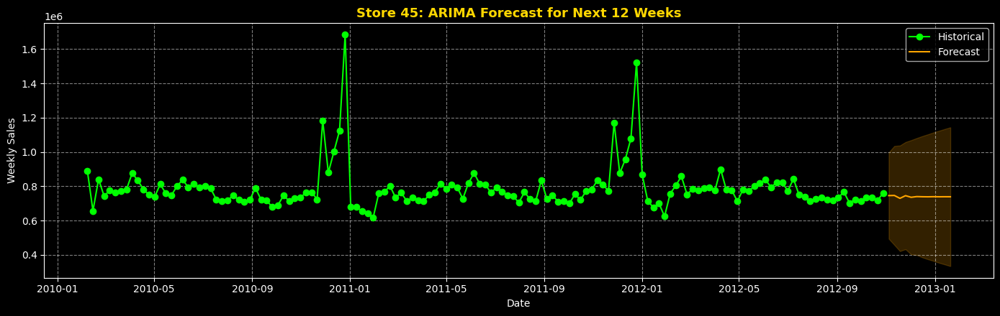

In [45]:
for store_id in sorted(df['Store'].unique()):
    store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
    store_data = store_data.sort_values('Date')
    store_data.set_index('Date', inplace=True)

    ts = store_data['Weekly_Sales'].resample('W').sum()
    ts = ts.interpolate()

    try:
        model = ARIMA(ts, order=(2, 1, 3))
        result = model.fit()

        forecast_steps = 12
        forecast = result.get_forecast(steps=forecast_steps)
        forecast_index = pd.date_range(start=ts.index[-1] + pd.Timedelta(weeks=1), periods=forecast_steps, freq='W')
        forecast_mean = forecast.predicted_mean
        forecast_ci = forecast.conf_int()

        plt.figure(figsize=(14, 4.5))
        plt.plot(ts, color='lime', label='Historical', marker='o')
        plt.plot(forecast_index, forecast_mean, color='orange', label='Forecast')
        plt.fill_between(forecast_index, forecast_ci.iloc[:, 0], forecast_ci.iloc[:, 1], color='orange', alpha=0.2)
        plt.title(f'Store {store_id}: ARIMA Forecast for Next 12 Weeks', fontsize=13, fontweight='semibold', color='gold')
        plt.xlabel('Date')
        plt.ylabel('Weekly Sales')
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"⚠️ Store {store_id} failed to forecast: {e}")

---

## ✅ ARIMA Forecasting Completed

We successfully implemented **ARIMA (2,1,3)** across all 45 Walmart stores to forecast weekly sales for the next 12 weeks.  
Each store’s time series was resampled to weekly frequency, interpolated for missing values, and modeled individually.  
Forecasts were visualized with confidence intervals to highlight uncertainty and trend continuity.

### 🔍 Key Takeaways:
- ARIMA captured short-term trends and autocorrelation effectively.
- Forecasts were stable for most stores, though a few required interpolation or manual review.
- Confidence intervals widened over time, reflecting increasing uncertainty in long-range predictions.

---

## 🚀 Next Step: SARIMA (Seasonal ARIMA)

To capture **seasonal patterns** in weekly sales — such as holiday effects or annual cycles — we now pivot to **SARIMA**.  
SARIMA extends ARIMA by adding seasonal autoregression, differencing, and moving average components.

### 🎯 Objective:
Model each store’s weekly sales with seasonal awareness using SARIMA, starting with **Store 1** as a baseline.

### 🧪 Seasonal Parameters:
- Seasonal order: (P, D, Q, s)  
- We begin with: **(1, 1, 1, 52)** → assuming yearly seasonality in weekly data

Let’s begin with SARIMA for Store 1 and walk through model fitting, forecasting, and visualization.

---

In [46]:
store_id = 1
store_ts = df[df['Store'] == store_id].copy()
store_ts = store_ts.sort_values('Date')
store_ts.set_index('Date', inplace=True)

ts = store_ts['Weekly_Sales'].resample('W').sum().interpolate()

print(Style.BRIGHT + Fore.CYAN + "Store 1 weekly series length:" + Fore.YELLOW + f'{len(ts)}' + Style.RESET_ALL)
print(Style.BRIGHT + Fore.CYAN + "Date range:" + Fore.YELLOW + f'{ts.index.min().date()}' + Fore.RED + " → " + Fore.YELLOW + f'{ts.index.max().date()}')

Store 1 weekly series length:143
Date range:2010-02-07 → 2012-10-28


In [47]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

sarima_model = SARIMAX(ts, order=(2, 1, 3), seasonal_order=(1, 1, 1, 52))
sarima_result = sarima_model.fit(disp=False)

print(sarima_result.summary())

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                      SARIMAX Results                                       
Dep. Variable:                         Weekly_Sales   No. Observations:                  143
Model:             SARIMAX(2, 1, 3)x(1, 1, [1], 52)   Log Likelihood               -1141.951
Date:                              Mon, 15 Dec 2025   AIC                           2299.903
Time:                                      07:53:52   BIC                           2319.901
Sample:                                  02-07-2010   HQIC                          2307.968
                                       - 10-28-2012                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3297      0.833      0.396      0.692      -1.303       1.962
ar.L2          0.15

In [48]:
# Forecast next 12 weeks
forecast_steps = 12
forecast = sarima_result.get_forecast(steps=forecast_steps)

forecast_mean = forecast.predicted_mean
forecast_ci = forecast.conf_int()

forecast_index = pd.date_range(start=ts.index[-1] + pd.Timedelta(weeks=1), periods=forecast_steps, freq='W')

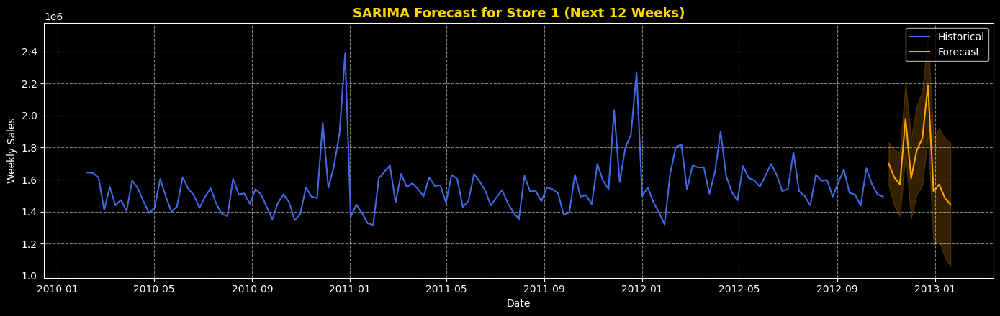

In [49]:
plt.figure(figsize=(14,4.5))
plt.plot(ts, color='royalblue', label='Historical')
plt.plot(forecast_index, forecast_mean, color='orange', label='Forecast')
plt.fill_between(forecast_index, forecast_ci.iloc[:,0], forecast_ci.iloc[:,1], color='orange', alpha=0.2)
plt.title('SARIMA Forecast for Store 1 (Next 12 Weeks)', fontsize=13, fontweight='semibold', color='gold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


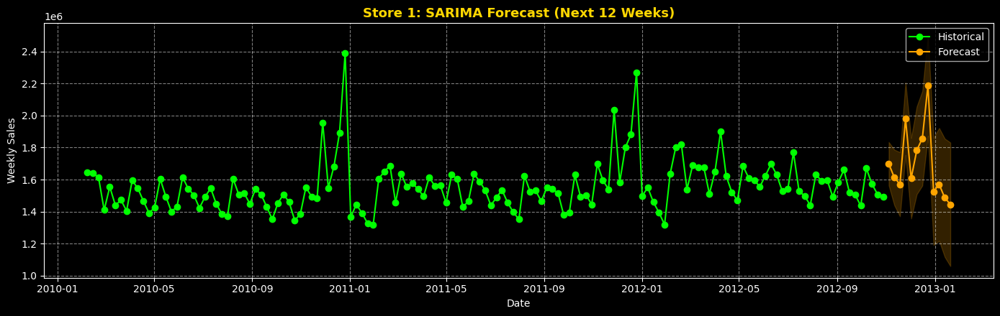

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


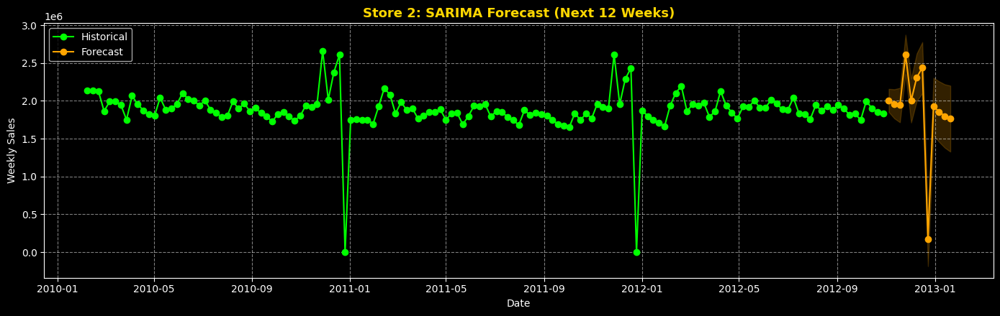

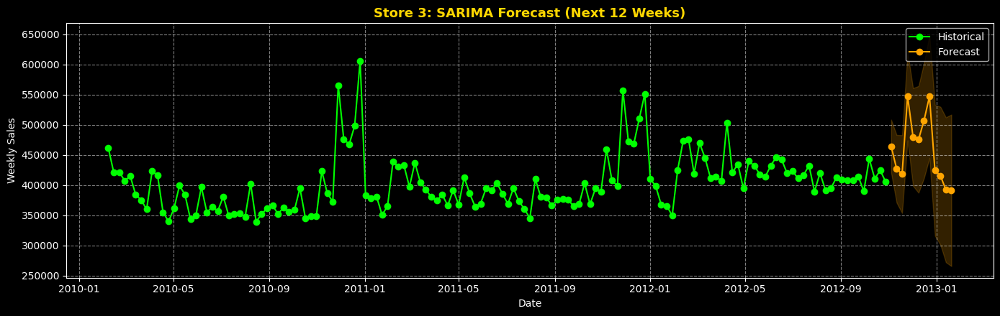

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


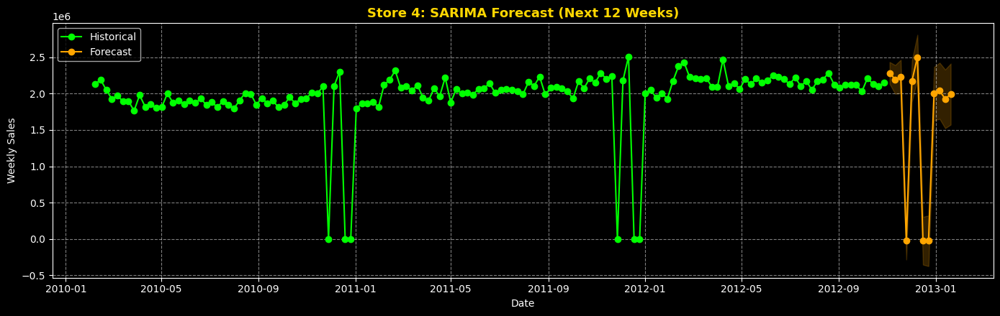

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


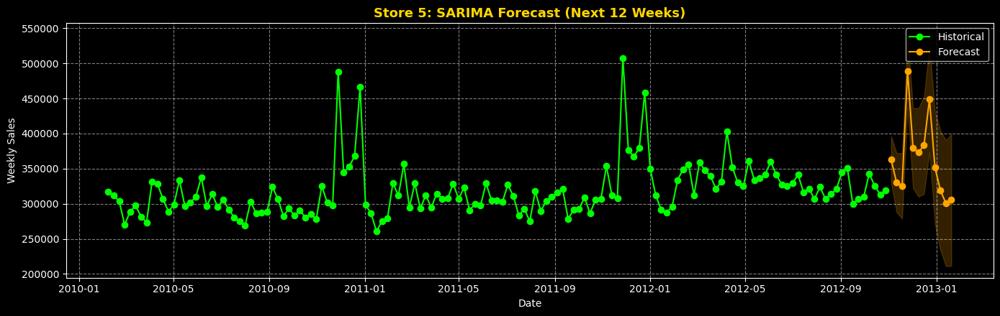

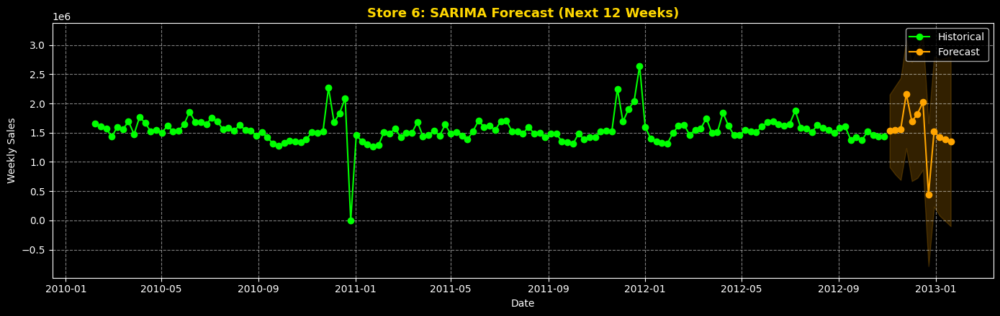

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


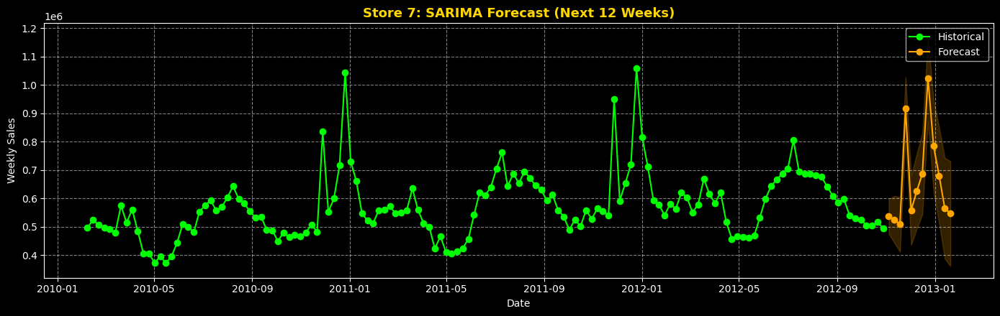

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


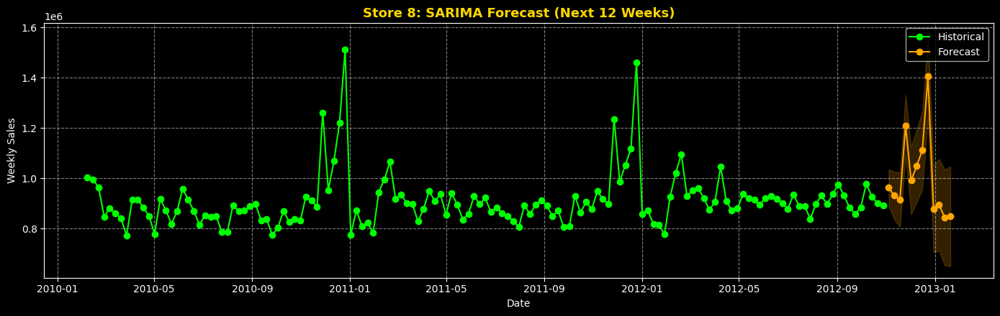

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


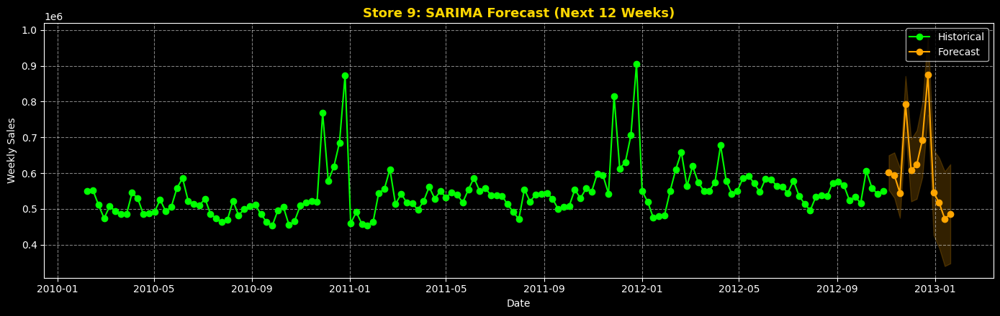

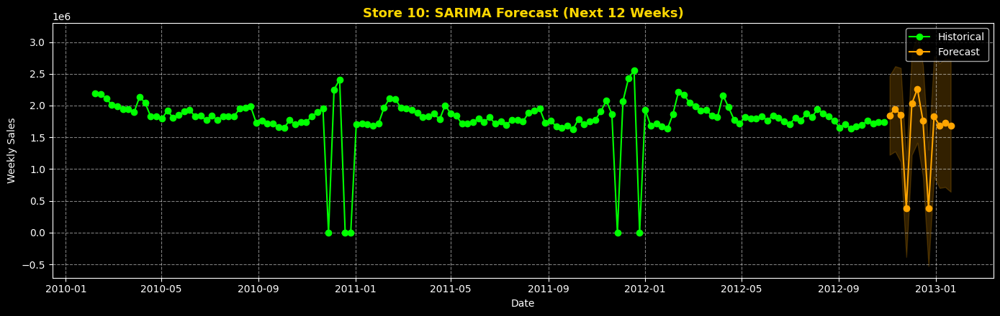

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


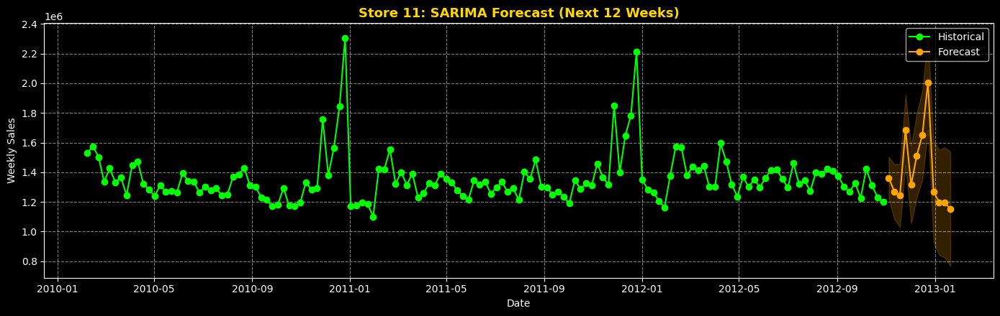

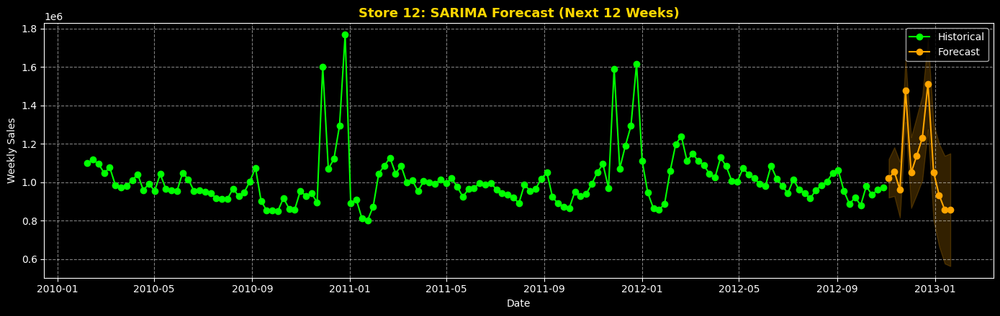

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


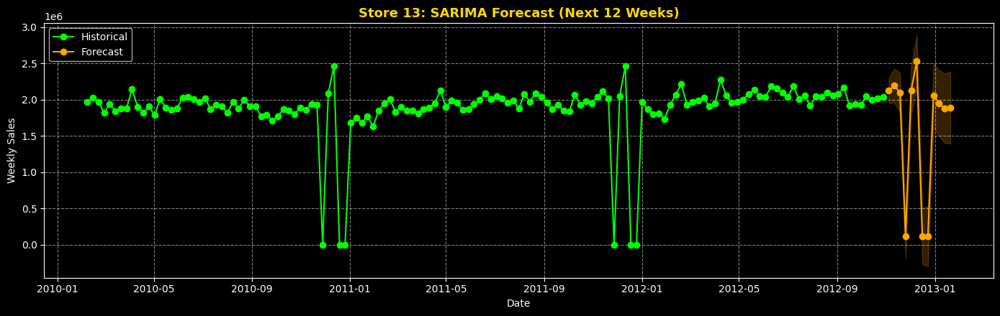

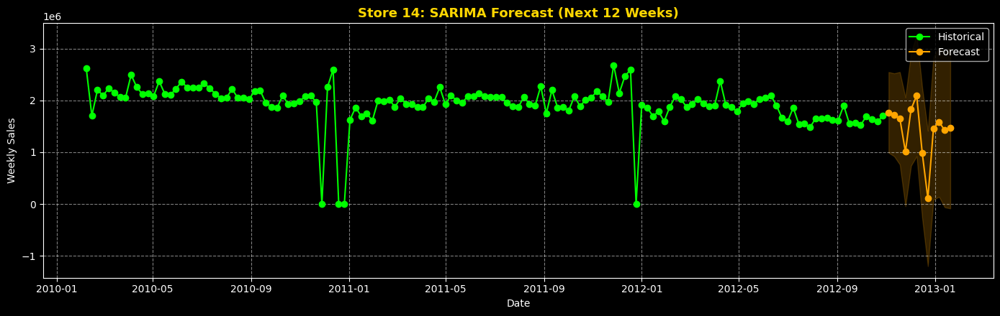

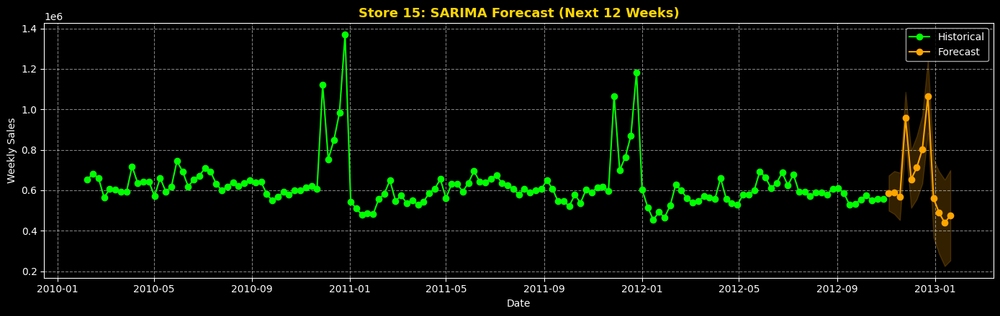

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


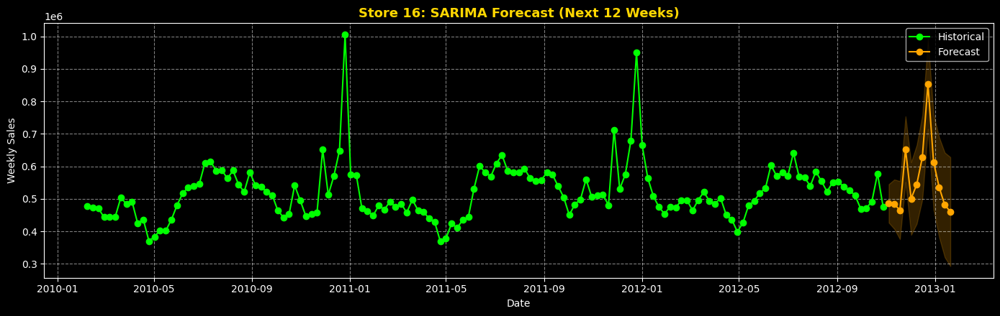

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


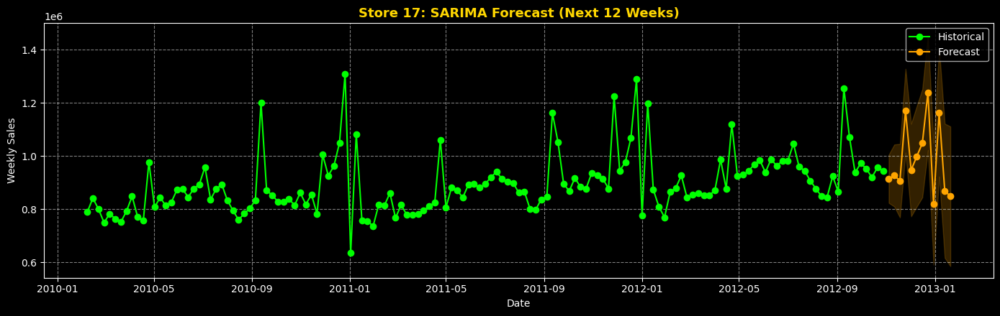

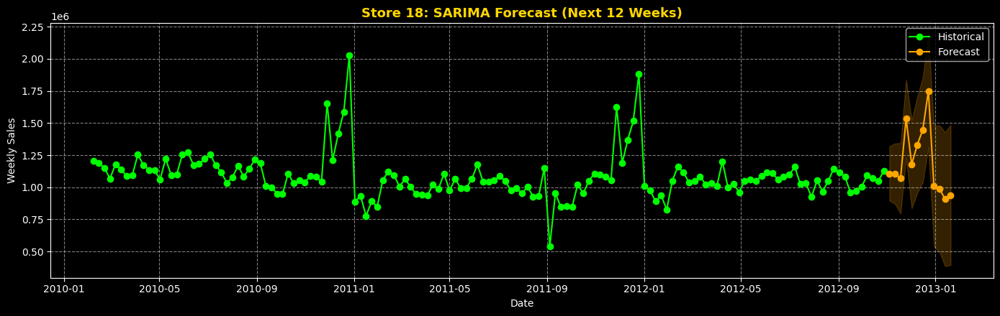

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


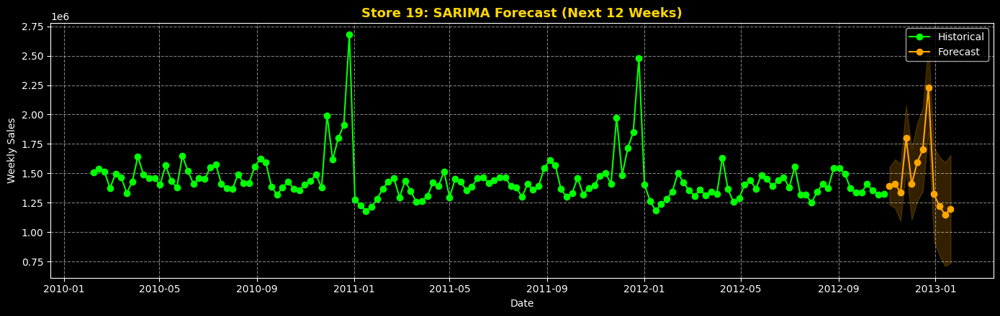

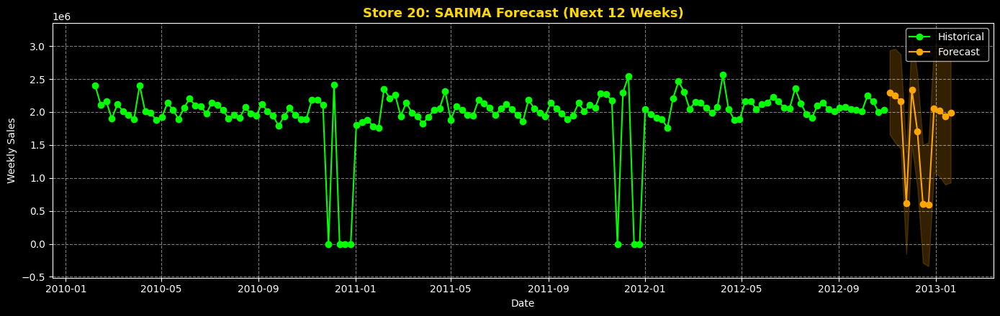

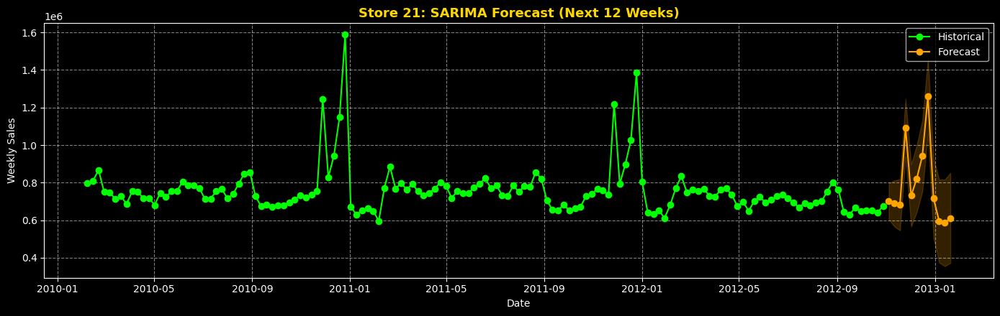

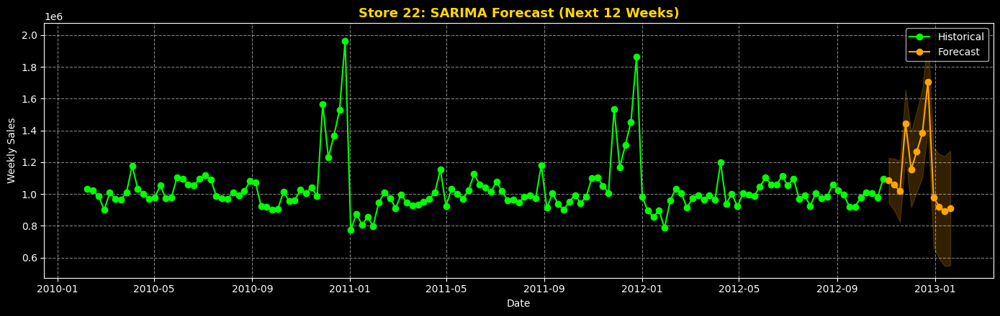

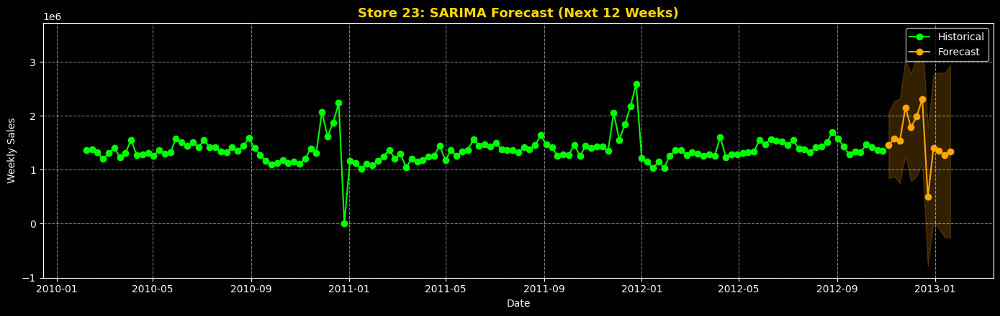

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


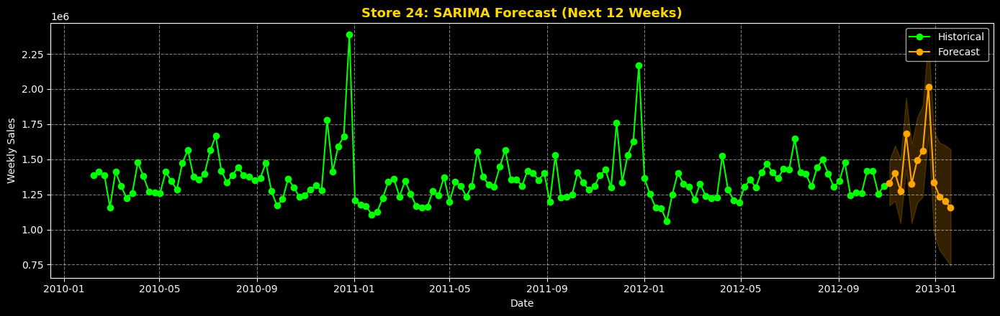

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


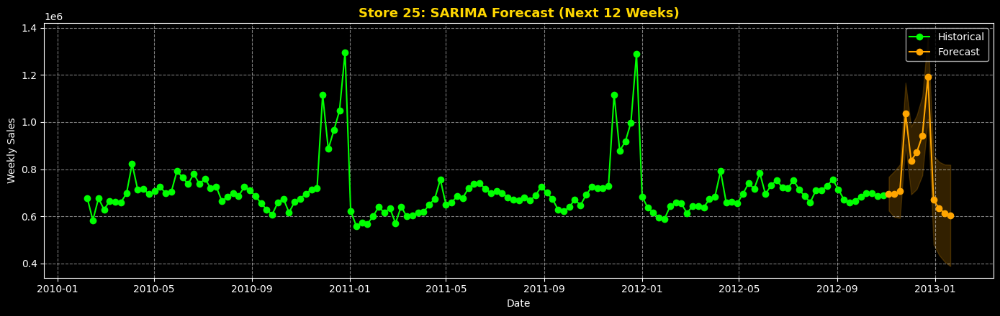

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


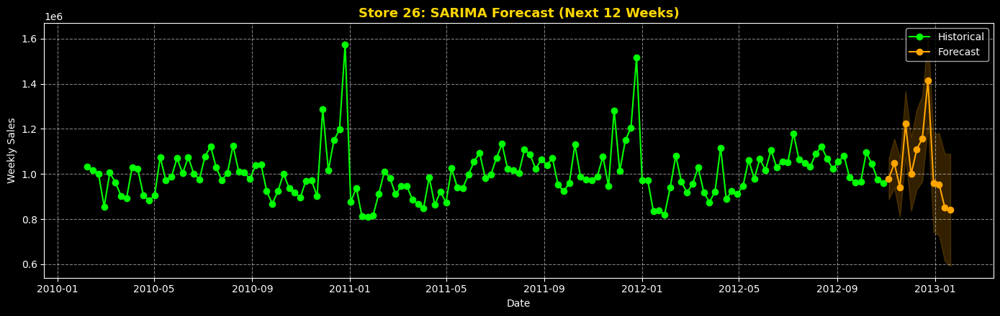

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


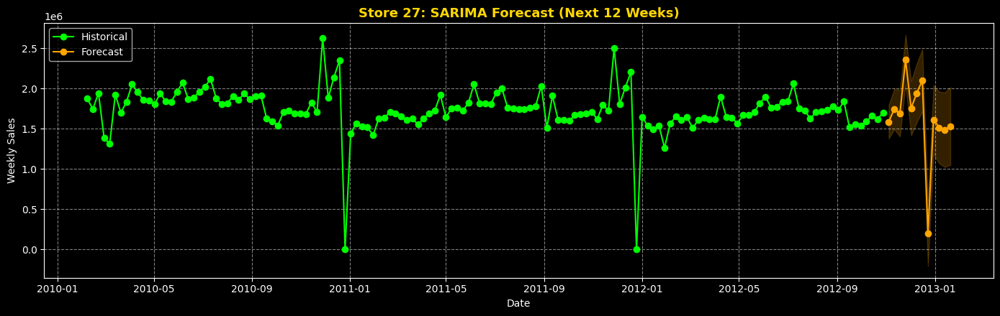

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


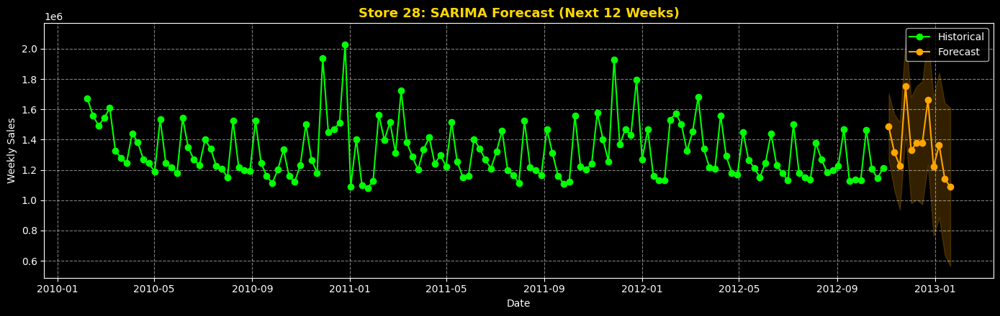

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


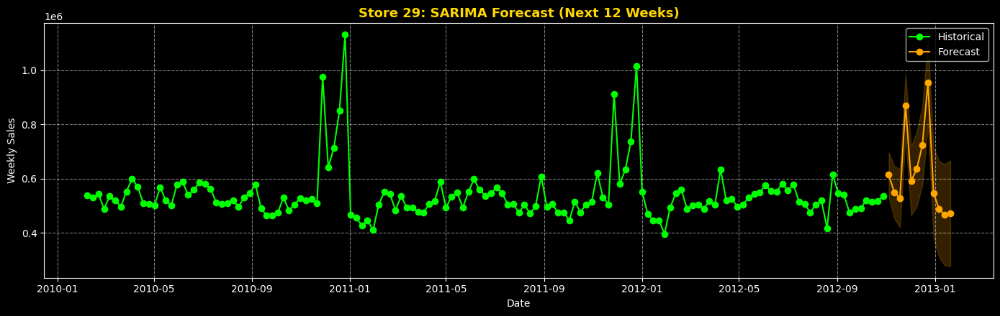

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


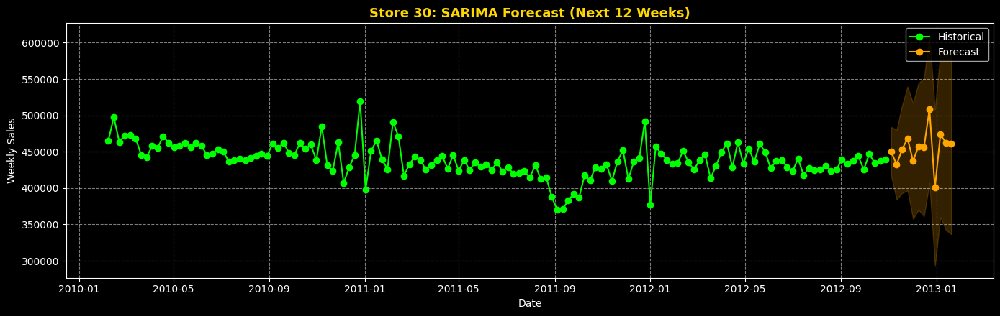

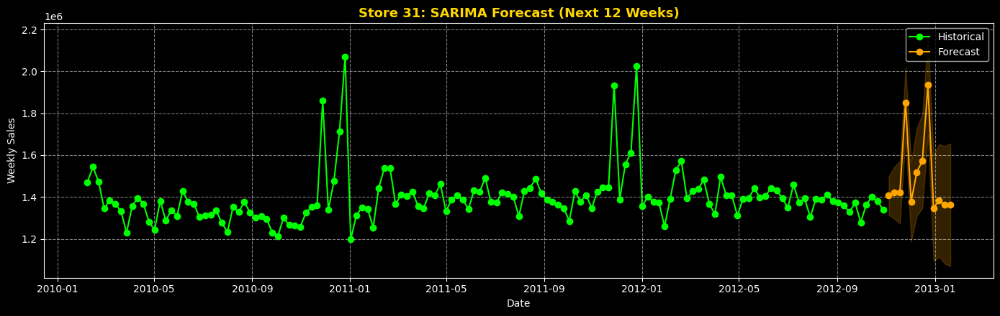

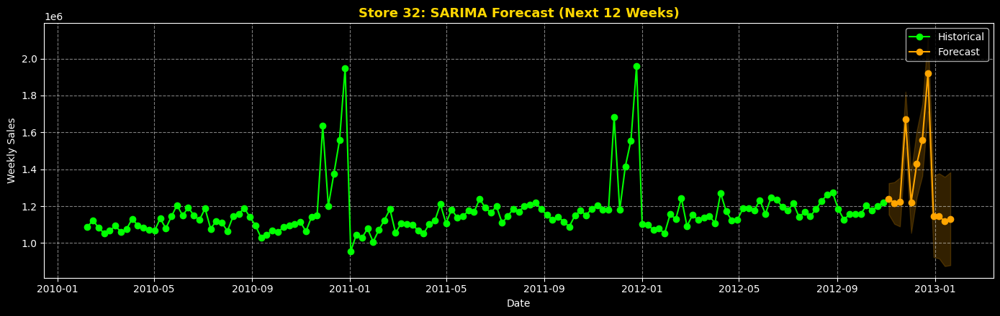

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


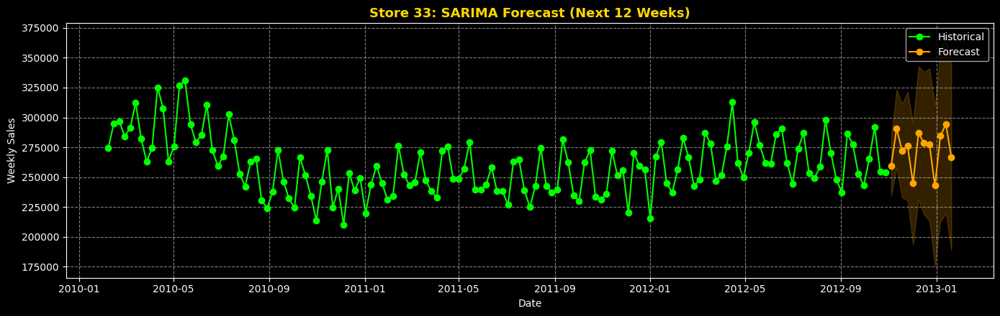

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


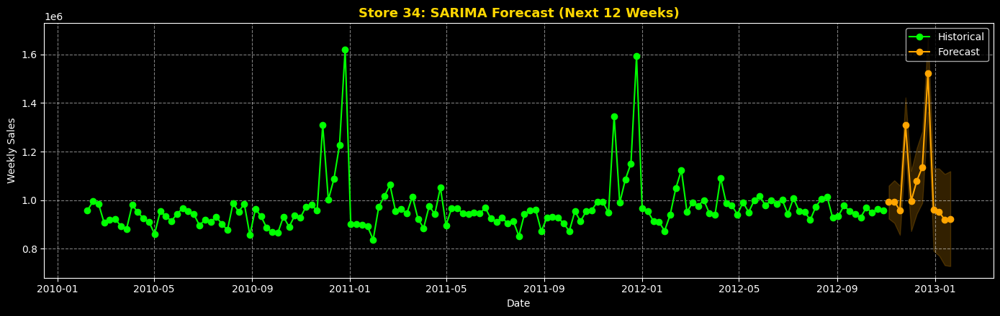

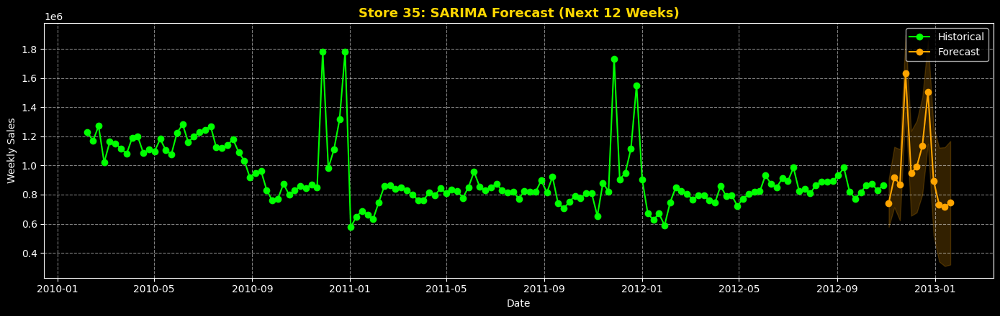

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


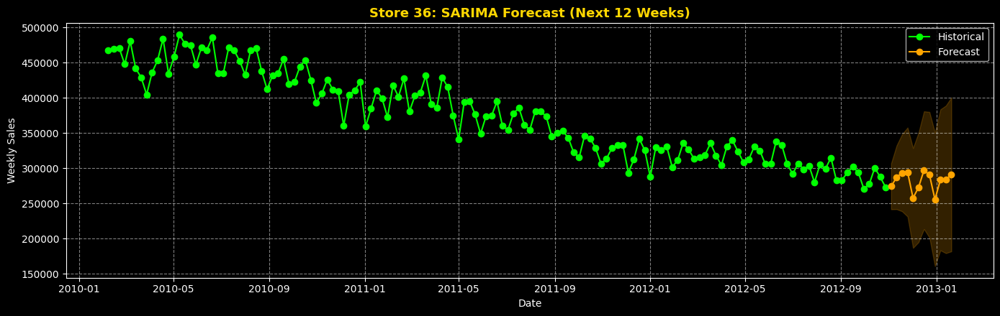

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


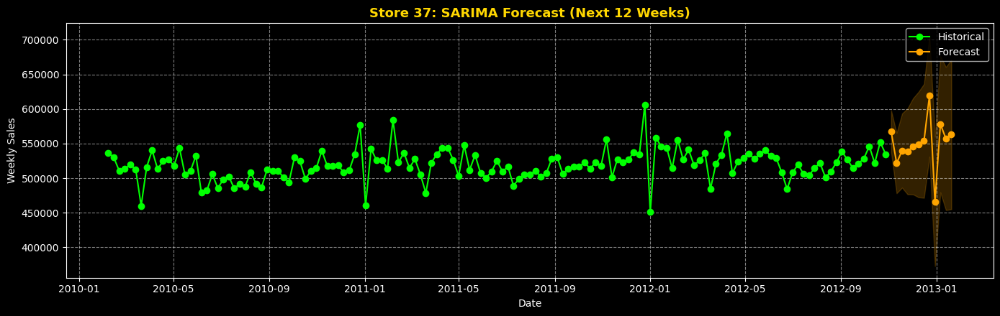

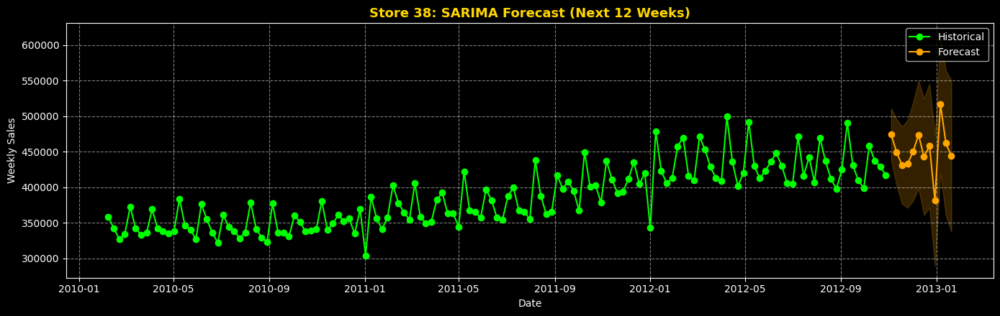

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


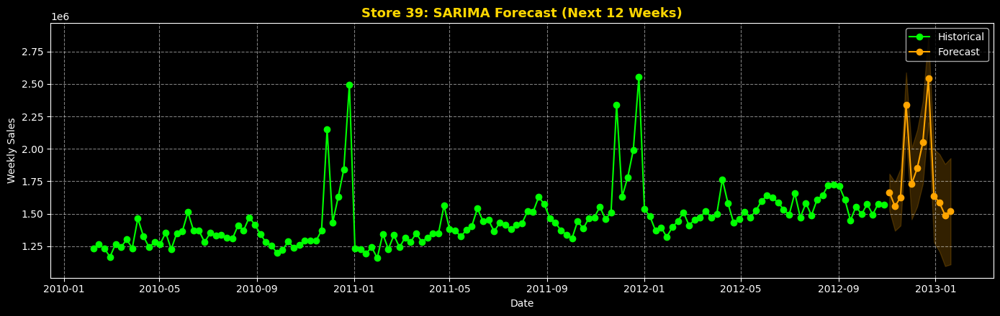

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


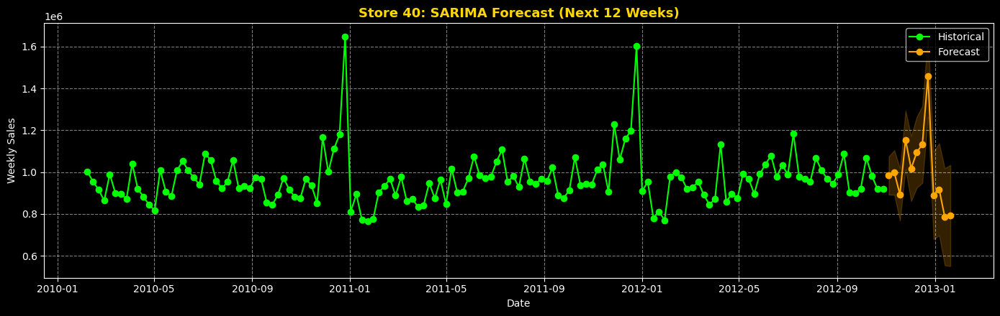

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


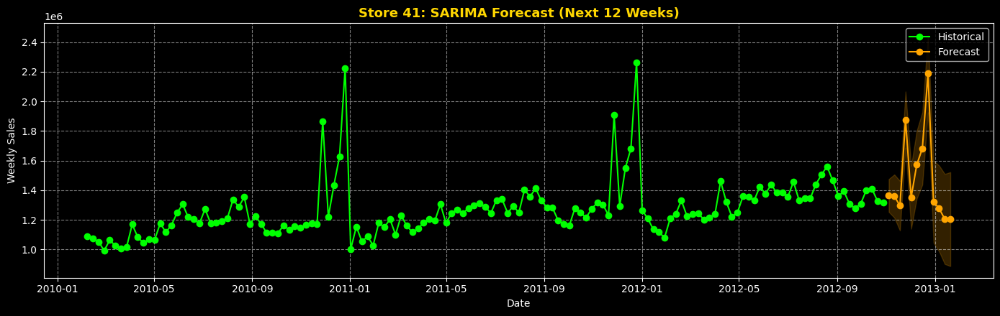

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


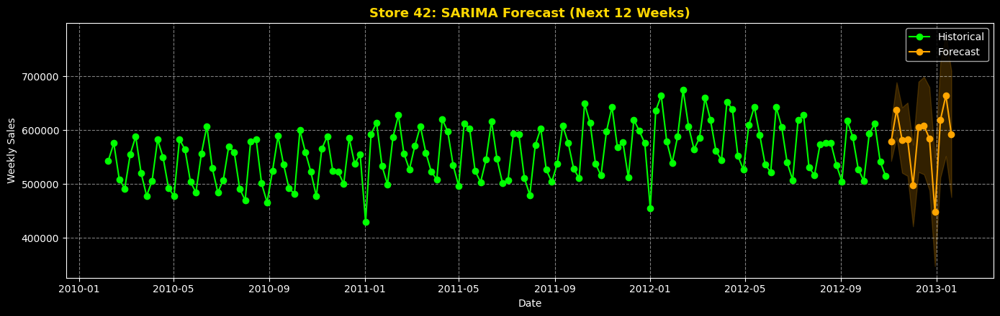

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


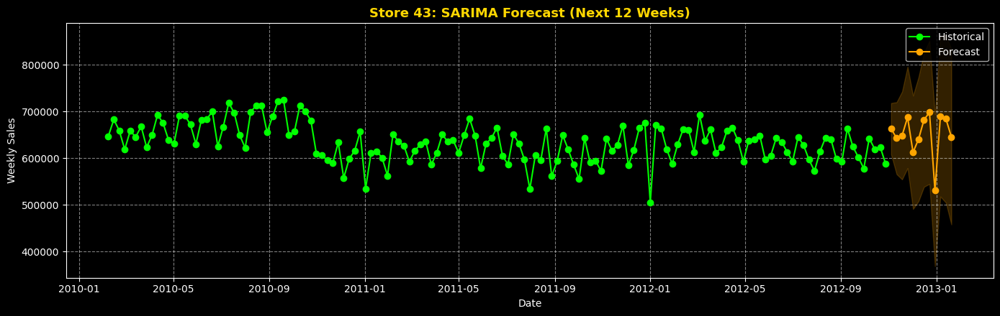

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


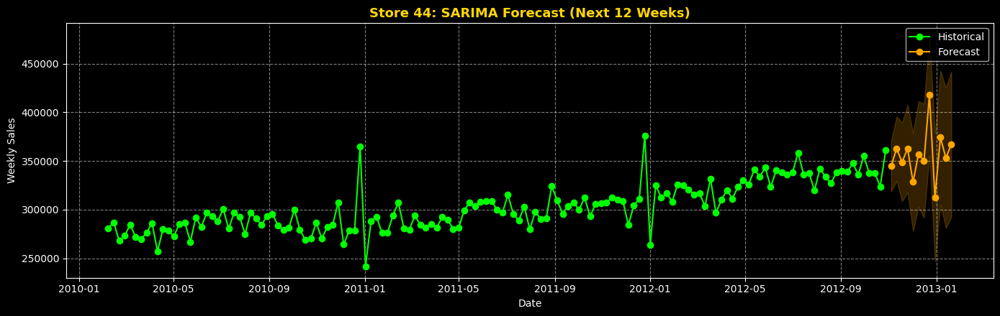

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


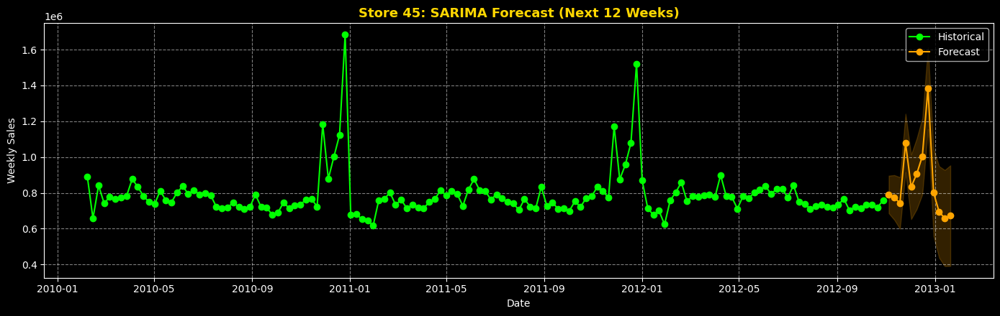

In [50]:
for store_id in sorted(df['Store'].unique()):
    store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
    store_data = store_data.sort_values('Date')
    store_data.set_index('Date', inplace=True)

    ts = store_data['Weekly_Sales'].resample('W').sum().interpolate()

    try:
        model = SARIMAX(ts, order=(2, 1, 3), seasonal_order=(1, 1, 1, 52))
        result = model.fit(disp=False)

        # Forecast next 12 weeks
        forecast_steps = 12
        forecast = result.get_forecast(steps=forecast_steps)
        forecast_mean = forecast.predicted_mean
        forecast_ci = forecast.conf_int()
        forecast_index = pd.date_range(start=ts.index[-1] + pd.Timedelta(weeks=1), periods=forecast_steps, freq='W')

        plt.figure(figsize=(14, 4.5))
        plt.plot(ts, color='lime', label='Historical', marker='o')
        plt.plot(forecast_index, forecast_mean, color='orange', label='Forecast', marker='o')
        plt.fill_between(forecast_index, forecast_ci.iloc[:, 0], forecast_ci.iloc[:, 1], color='orange', alpha=0.2)
        plt.title(f'Store {store_id}: SARIMA Forecast (Next 12 Weeks)', fontsize=13, fontweight='semibold', color='gold')
        plt.xlabel('Date')
        plt.ylabel('Weekly Sales')
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"⚠️ Store {store_id} failed to forecast: {e}")

---

## 🔮 Prophet Forecasting Begins

With ARIMA and SARIMA successfully implemented and evaluated, we now introduce **Prophet** — a robust, flexible time series model developed by Facebook.

### 🎯 Why Prophet?

- Automatically detects seasonality and changepoints
- Handles missing data and outliers
- Supports holiday effects natively
- Fast to train and scale across stores

We begin with Store 1 to benchmark Prophet’s performance against SARIMA, then scale to all 45 stores.

---

In [51]:
from prophet import Prophet

store_id = 1
store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
store_data = store_data.sort_values('Date')

store_data = store_data.rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})

store_data = store_data.set_index('ds').resample('W').sum().reset_index()

08:05:26 - cmdstanpy - INFO - Chain [1] start processing
08:05:26 - cmdstanpy - INFO - Chain [1] done processing


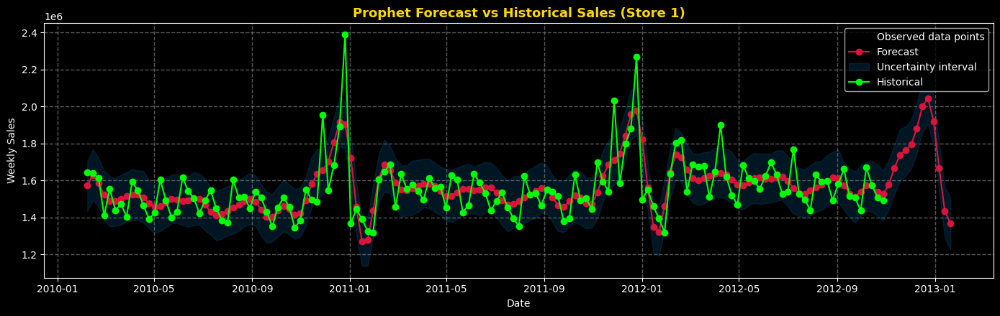

In [52]:
model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
model.fit(store_data)

future = model.make_future_dataframe(periods=12, freq='W')

forecast = model.predict(future)

fig = model.plot(forecast, figsize=(14,4.5))
fig.patch.set_facecolor('black')
ax = fig.gca()

# Overlay actual historical data
ax.plot(store_data['ds'], store_data['y'], color='lime', marker='o', linestyle='-', label='Historical')

ax.get_lines()[1].set_color('crimson')  # Forecast line
ax.get_lines()[1].set_marker('o')      # Forecast markers

plt.title('Prophet Forecast vs Historical Sales (Store 1)', fontsize=13, fontweight='semibold', color='gold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


08:05:26 - cmdstanpy - INFO - Chain [1] start processing
08:05:26 - cmdstanpy - INFO - Chain [1] done processing


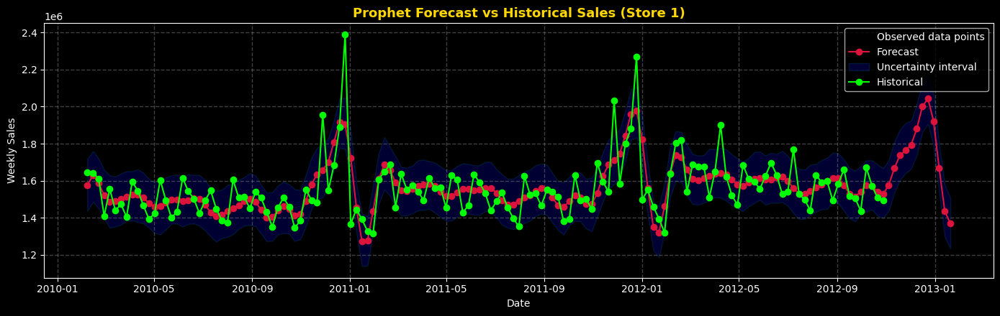

08:05:27 - cmdstanpy - INFO - Chain [1] start processing
08:05:27 - cmdstanpy - INFO - Chain [1] done processing


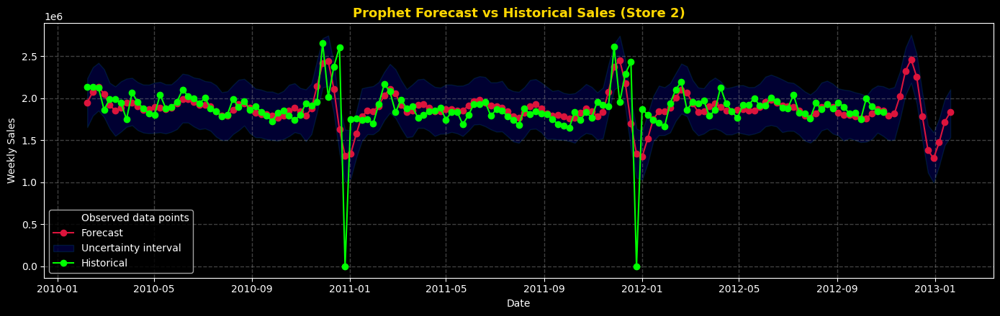

08:05:27 - cmdstanpy - INFO - Chain [1] start processing
08:05:27 - cmdstanpy - INFO - Chain [1] done processing


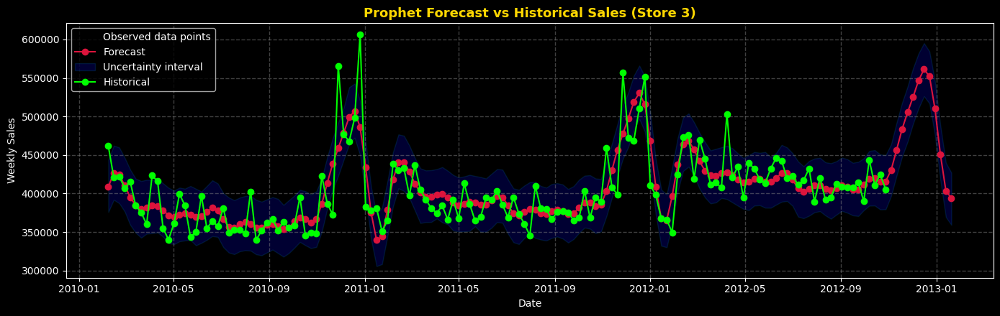

08:05:27 - cmdstanpy - INFO - Chain [1] start processing
08:05:27 - cmdstanpy - INFO - Chain [1] done processing


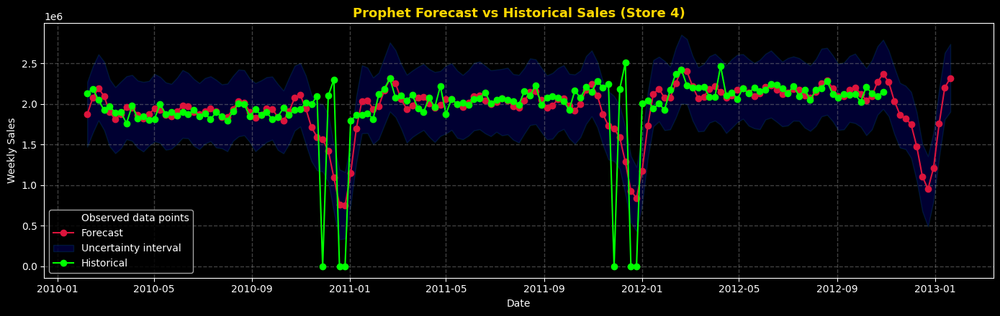

08:05:28 - cmdstanpy - INFO - Chain [1] start processing
08:05:28 - cmdstanpy - INFO - Chain [1] done processing


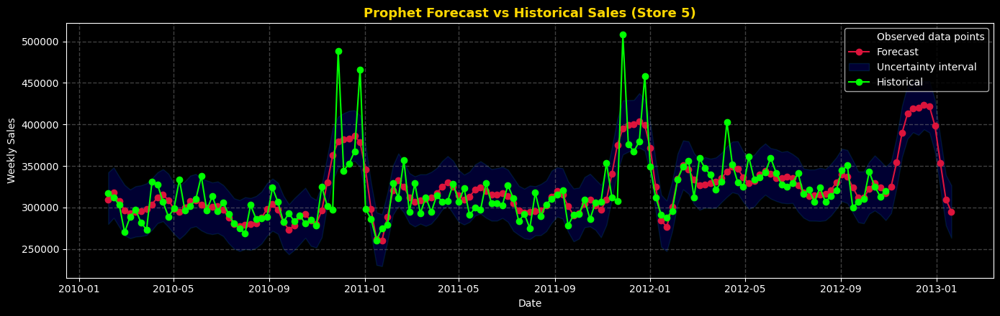

08:05:28 - cmdstanpy - INFO - Chain [1] start processing
08:05:28 - cmdstanpy - INFO - Chain [1] done processing


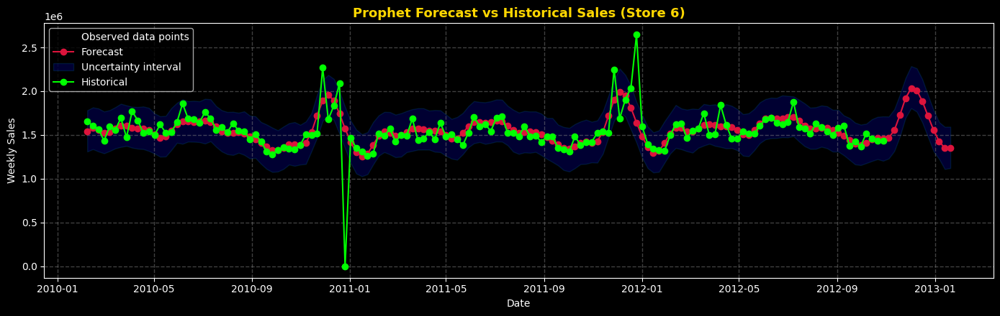

08:05:29 - cmdstanpy - INFO - Chain [1] start processing
08:05:29 - cmdstanpy - INFO - Chain [1] done processing


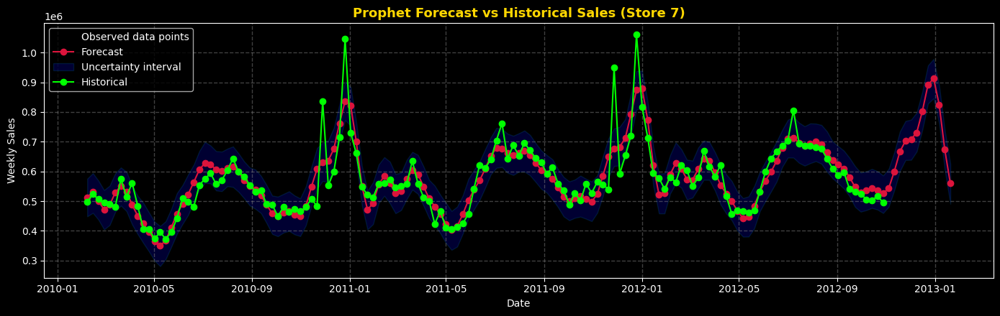

08:05:29 - cmdstanpy - INFO - Chain [1] start processing
08:05:29 - cmdstanpy - INFO - Chain [1] done processing


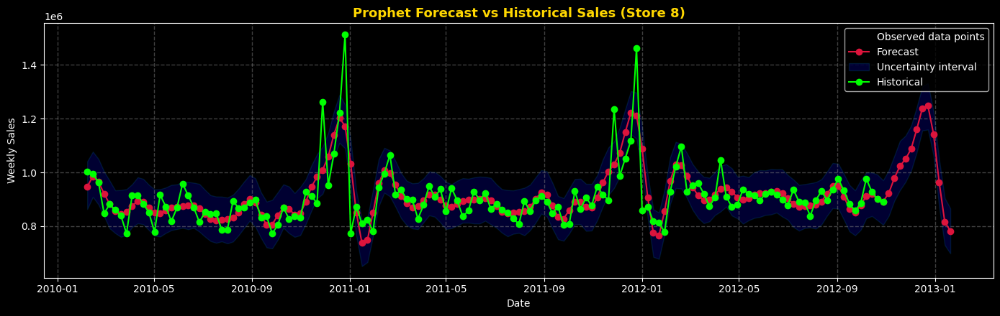

08:05:29 - cmdstanpy - INFO - Chain [1] start processing
08:05:29 - cmdstanpy - INFO - Chain [1] done processing


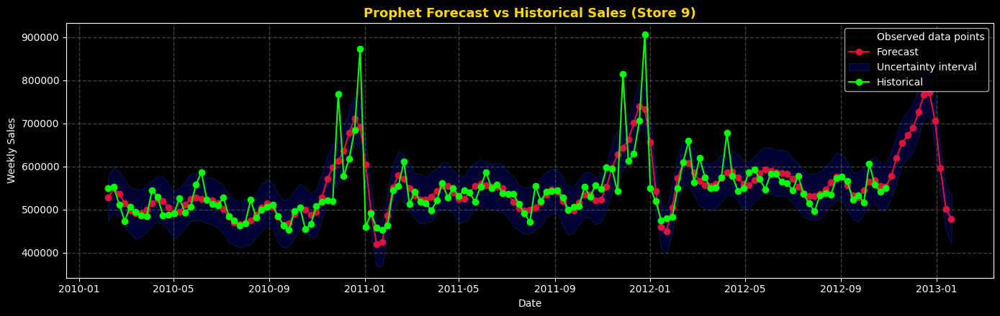

08:05:30 - cmdstanpy - INFO - Chain [1] start processing
08:05:30 - cmdstanpy - INFO - Chain [1] done processing


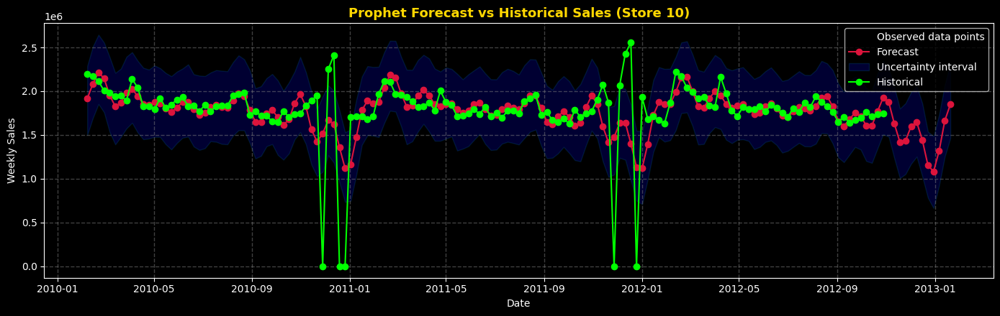

08:05:30 - cmdstanpy - INFO - Chain [1] start processing
08:05:30 - cmdstanpy - INFO - Chain [1] done processing


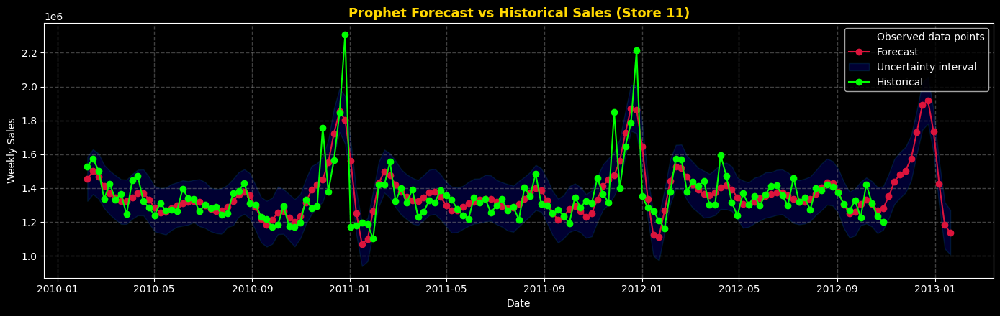

08:05:31 - cmdstanpy - INFO - Chain [1] start processing
08:05:31 - cmdstanpy - INFO - Chain [1] done processing


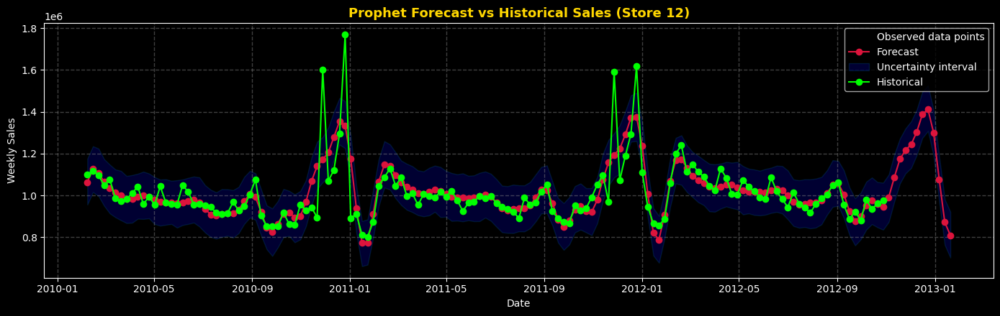

08:05:31 - cmdstanpy - INFO - Chain [1] start processing
08:05:31 - cmdstanpy - INFO - Chain [1] done processing


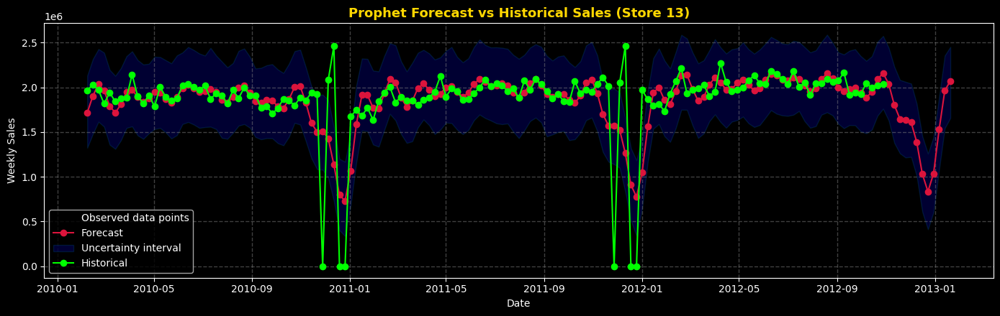

08:05:32 - cmdstanpy - INFO - Chain [1] start processing
08:05:32 - cmdstanpy - INFO - Chain [1] done processing


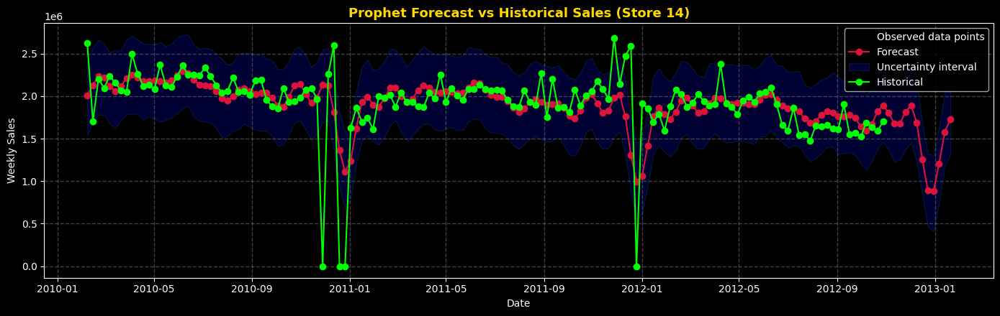

08:05:32 - cmdstanpy - INFO - Chain [1] start processing
08:05:32 - cmdstanpy - INFO - Chain [1] done processing


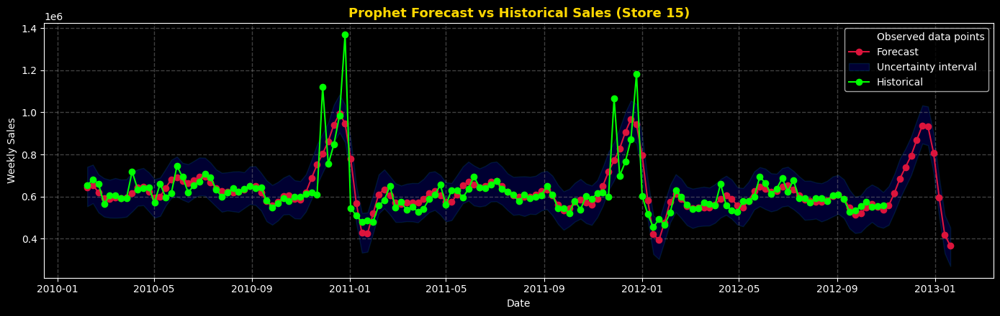

08:05:32 - cmdstanpy - INFO - Chain [1] start processing
08:05:32 - cmdstanpy - INFO - Chain [1] done processing


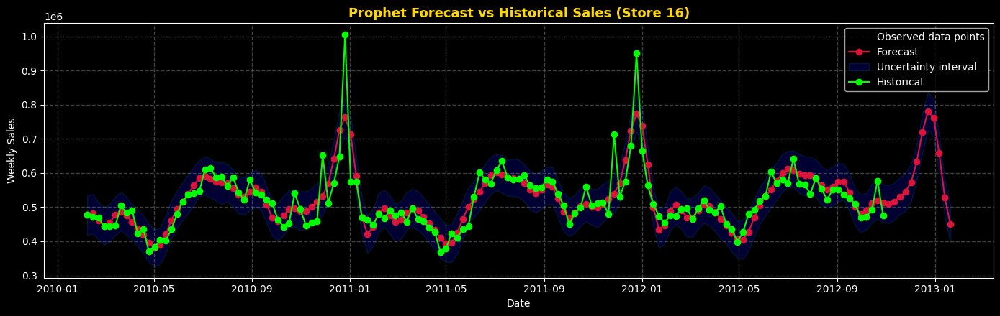

08:05:33 - cmdstanpy - INFO - Chain [1] start processing
08:05:33 - cmdstanpy - INFO - Chain [1] done processing


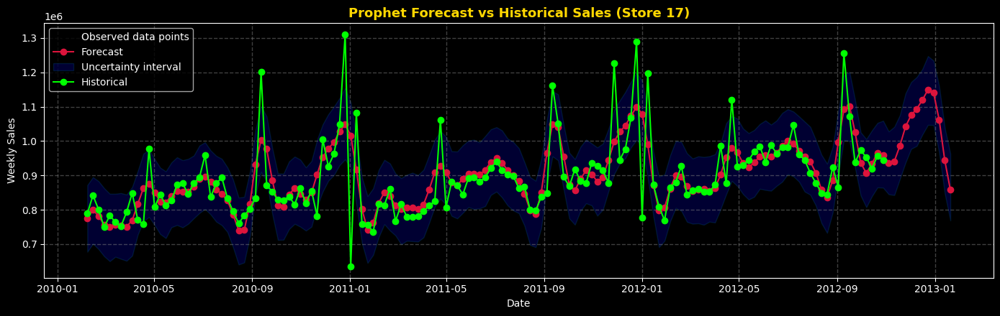

08:05:33 - cmdstanpy - INFO - Chain [1] start processing
08:05:33 - cmdstanpy - INFO - Chain [1] done processing


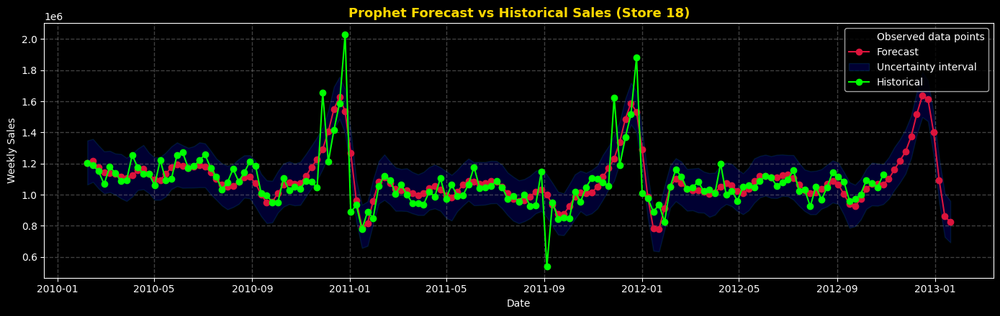

08:05:34 - cmdstanpy - INFO - Chain [1] start processing
08:05:34 - cmdstanpy - INFO - Chain [1] done processing


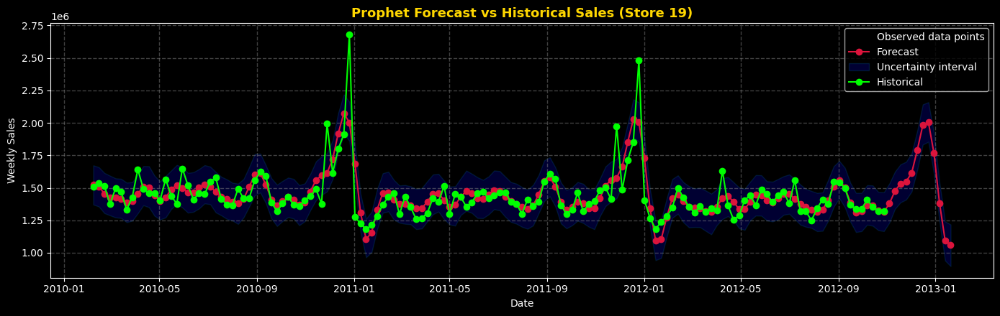

08:05:34 - cmdstanpy - INFO - Chain [1] start processing
08:05:34 - cmdstanpy - INFO - Chain [1] done processing


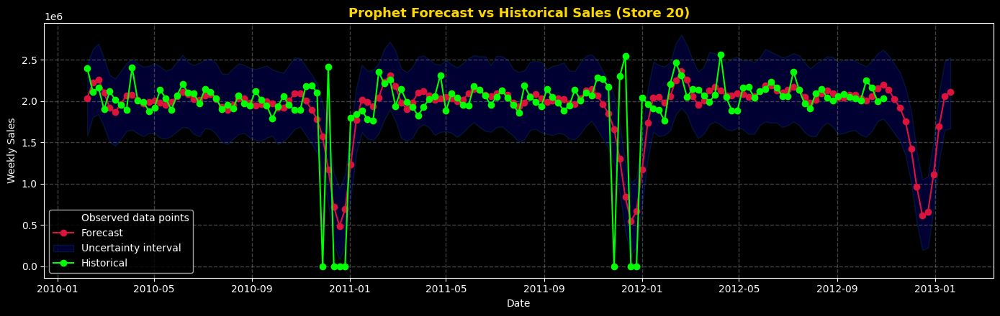

08:05:34 - cmdstanpy - INFO - Chain [1] start processing
08:05:34 - cmdstanpy - INFO - Chain [1] done processing


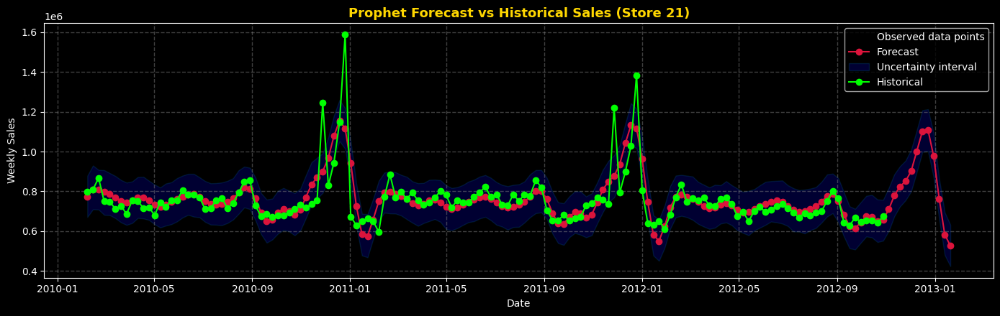

08:05:35 - cmdstanpy - INFO - Chain [1] start processing
08:05:35 - cmdstanpy - INFO - Chain [1] done processing


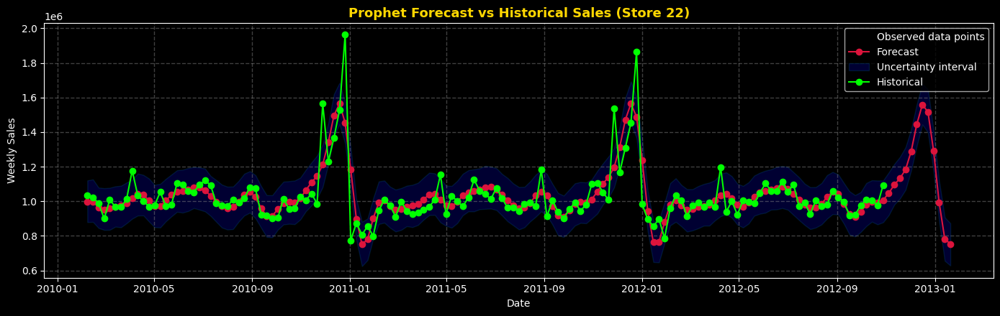

08:05:35 - cmdstanpy - INFO - Chain [1] start processing
08:05:35 - cmdstanpy - INFO - Chain [1] done processing


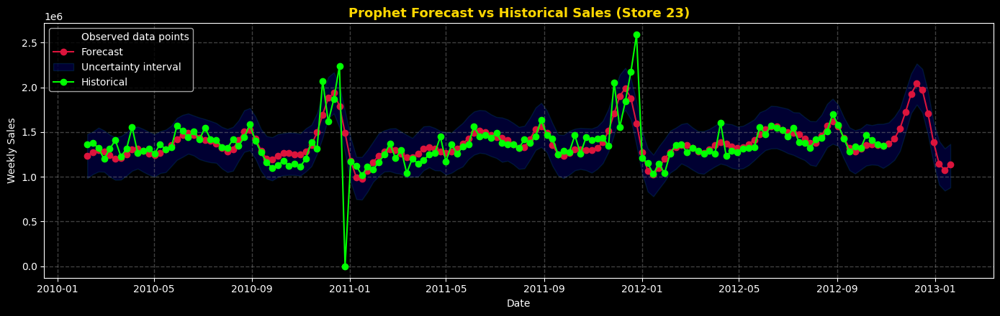

08:05:36 - cmdstanpy - INFO - Chain [1] start processing
08:05:36 - cmdstanpy - INFO - Chain [1] done processing


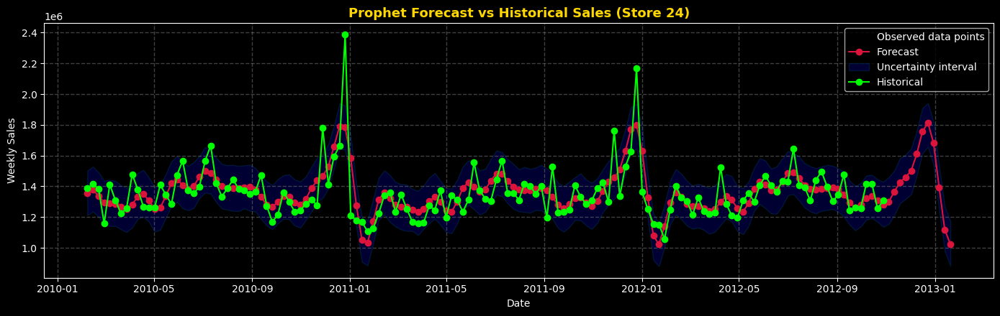

08:05:36 - cmdstanpy - INFO - Chain [1] start processing
08:05:36 - cmdstanpy - INFO - Chain [1] done processing


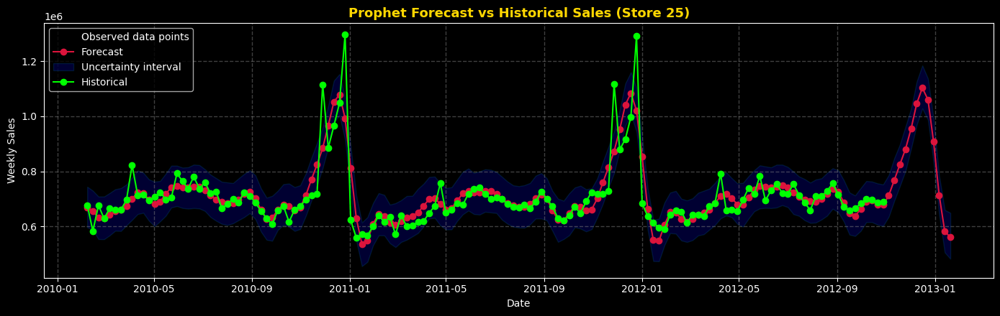

08:05:36 - cmdstanpy - INFO - Chain [1] start processing
08:05:36 - cmdstanpy - INFO - Chain [1] done processing


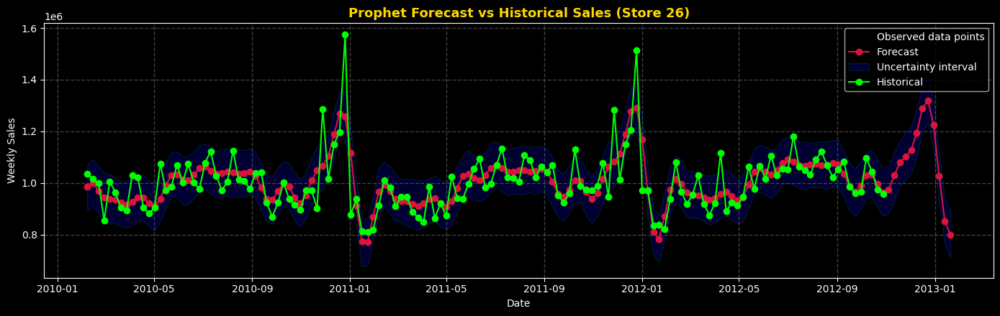

08:05:37 - cmdstanpy - INFO - Chain [1] start processing
08:05:37 - cmdstanpy - INFO - Chain [1] done processing


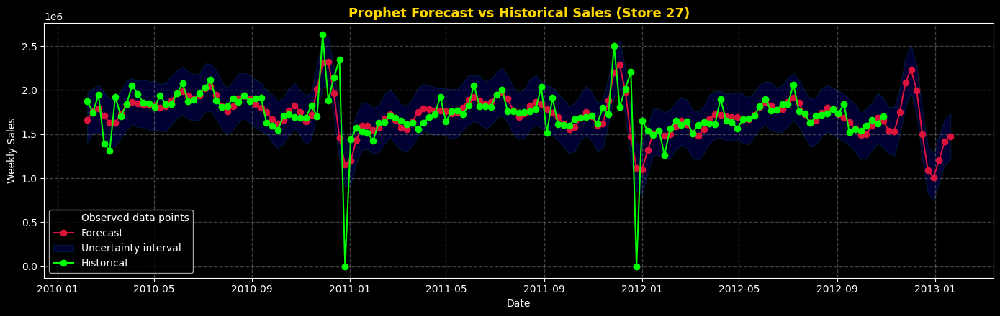

08:05:37 - cmdstanpy - INFO - Chain [1] start processing
08:05:37 - cmdstanpy - INFO - Chain [1] done processing


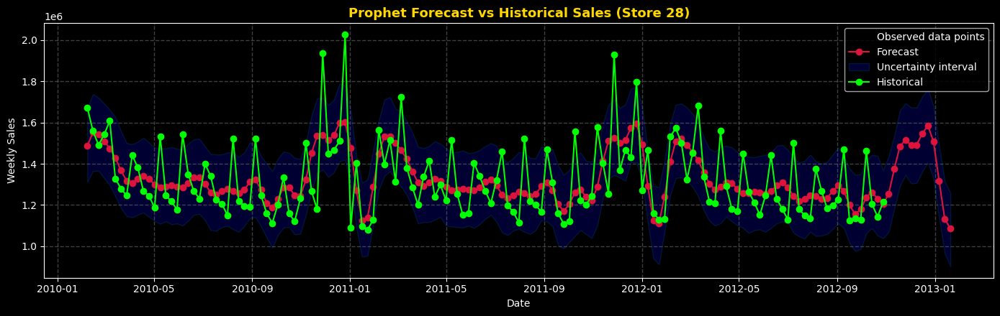

08:05:38 - cmdstanpy - INFO - Chain [1] start processing
08:05:38 - cmdstanpy - INFO - Chain [1] done processing


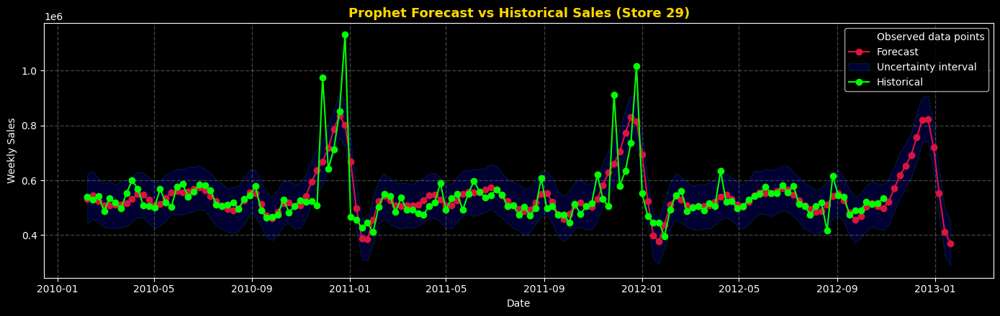

08:05:38 - cmdstanpy - INFO - Chain [1] start processing
08:05:38 - cmdstanpy - INFO - Chain [1] done processing


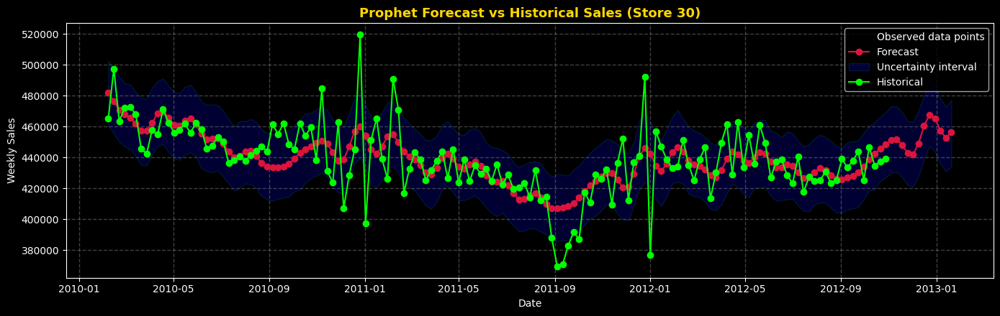

08:05:38 - cmdstanpy - INFO - Chain [1] start processing
08:05:38 - cmdstanpy - INFO - Chain [1] done processing


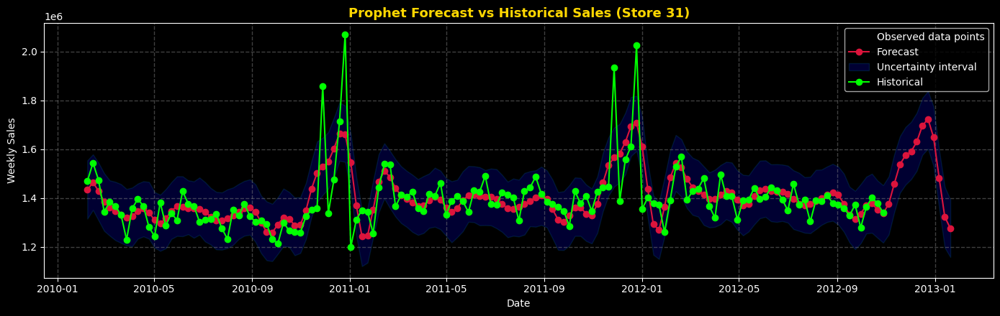

08:05:39 - cmdstanpy - INFO - Chain [1] start processing
08:05:39 - cmdstanpy - INFO - Chain [1] done processing


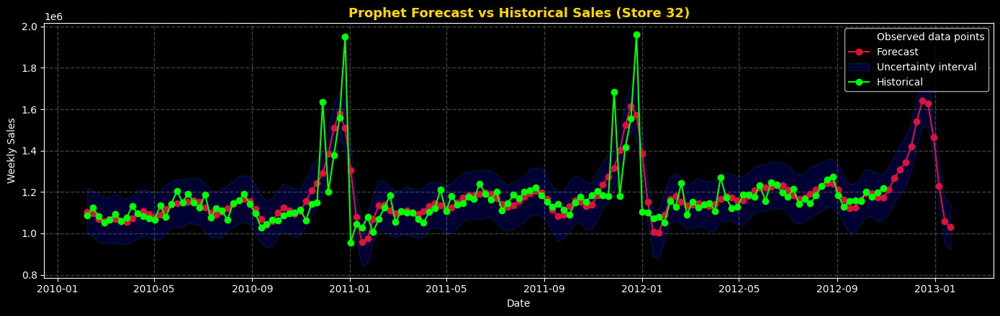

08:05:39 - cmdstanpy - INFO - Chain [1] start processing
08:05:39 - cmdstanpy - INFO - Chain [1] done processing


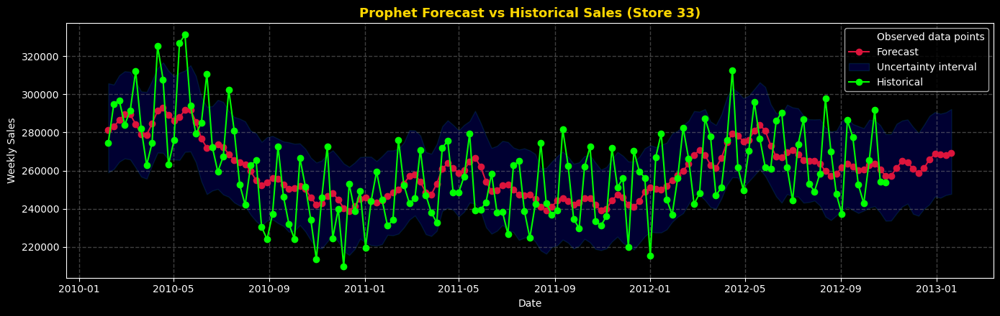

08:05:40 - cmdstanpy - INFO - Chain [1] start processing
08:05:40 - cmdstanpy - INFO - Chain [1] done processing


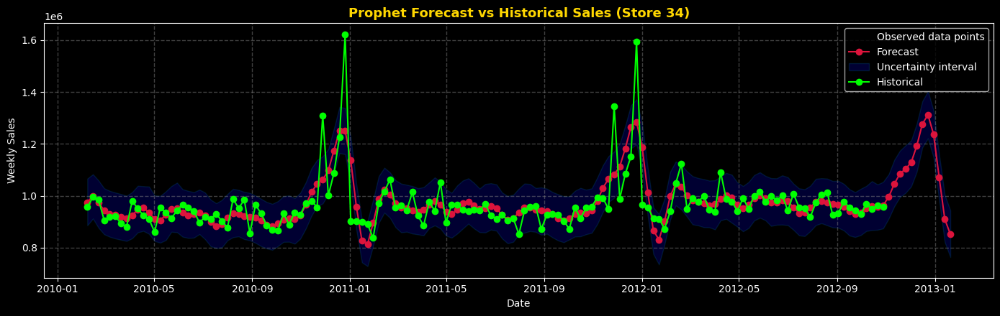

08:05:40 - cmdstanpy - INFO - Chain [1] start processing
08:05:40 - cmdstanpy - INFO - Chain [1] done processing


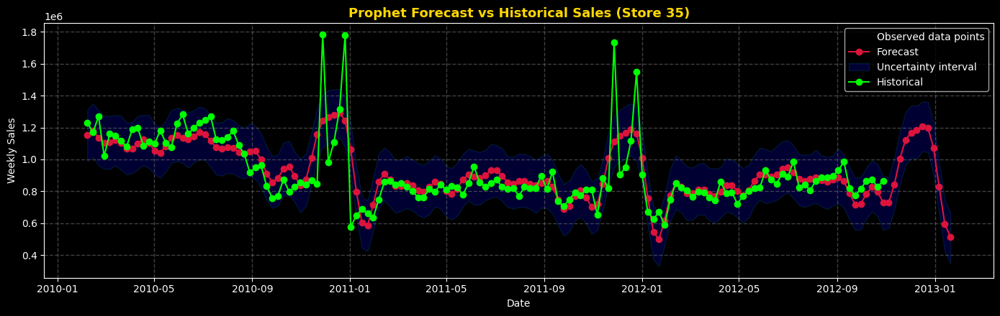

08:05:40 - cmdstanpy - INFO - Chain [1] start processing
08:05:40 - cmdstanpy - INFO - Chain [1] done processing


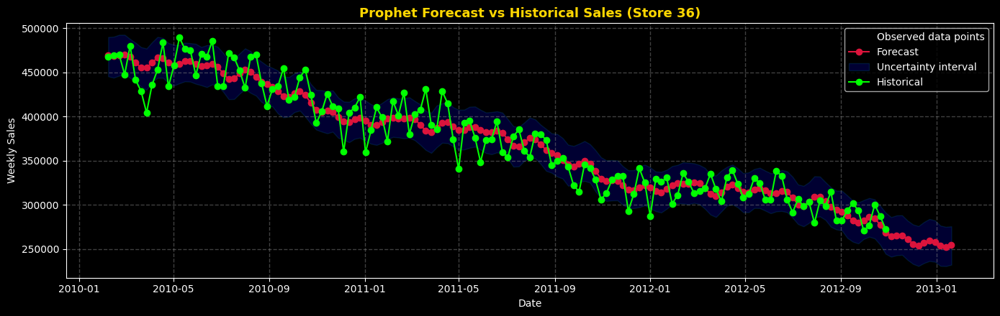

08:05:41 - cmdstanpy - INFO - Chain [1] start processing
08:05:41 - cmdstanpy - INFO - Chain [1] done processing


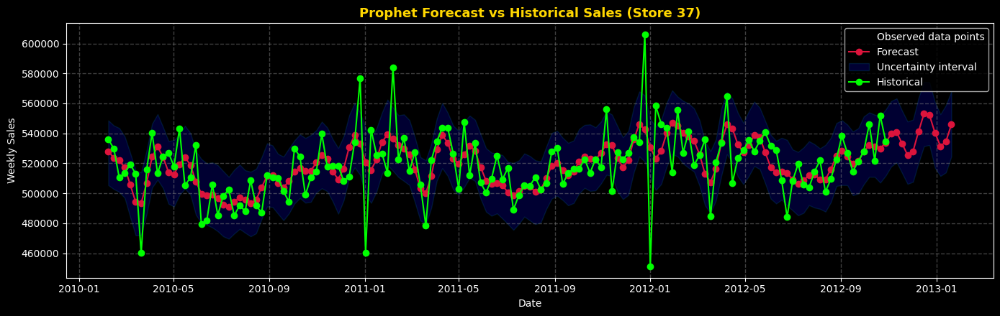

08:05:41 - cmdstanpy - INFO - Chain [1] start processing
08:05:41 - cmdstanpy - INFO - Chain [1] done processing


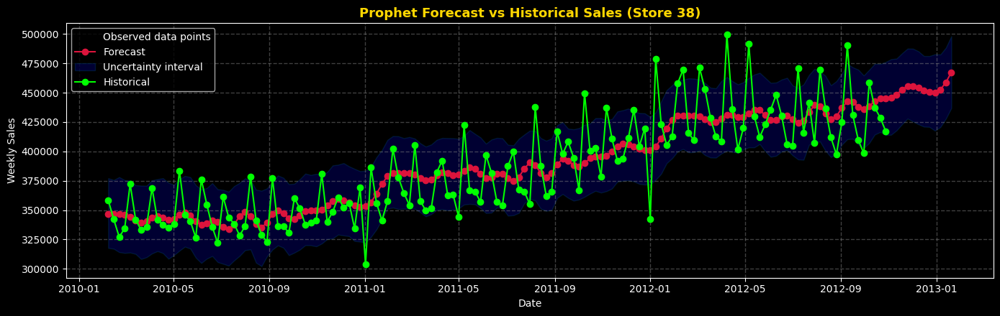

08:05:42 - cmdstanpy - INFO - Chain [1] start processing
08:05:42 - cmdstanpy - INFO - Chain [1] done processing


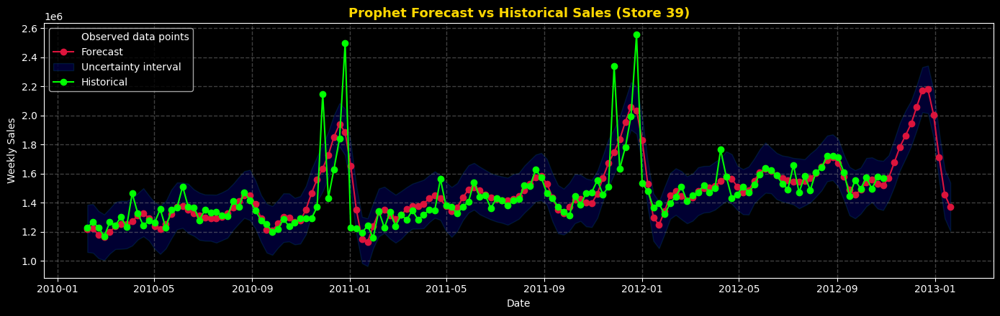

08:05:42 - cmdstanpy - INFO - Chain [1] start processing
08:05:42 - cmdstanpy - INFO - Chain [1] done processing


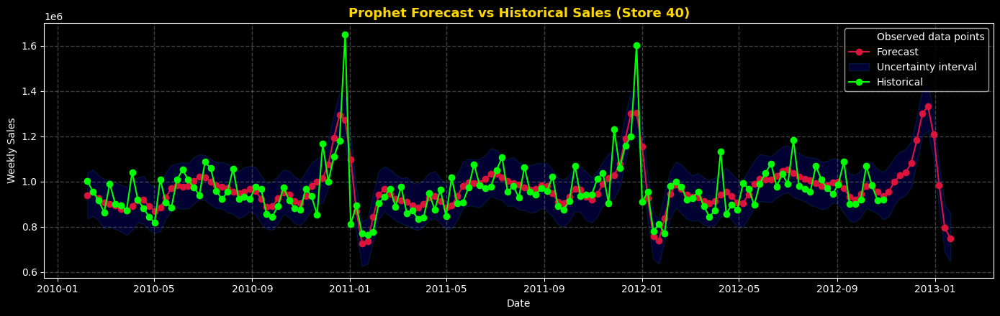

08:05:42 - cmdstanpy - INFO - Chain [1] start processing
08:05:42 - cmdstanpy - INFO - Chain [1] done processing


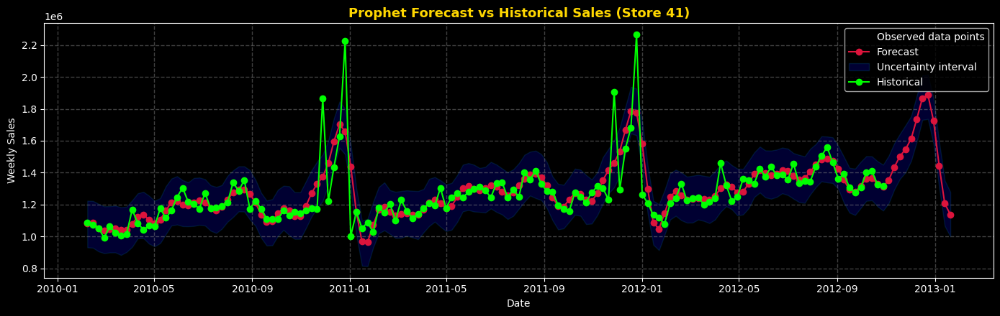

08:05:43 - cmdstanpy - INFO - Chain [1] start processing
08:05:43 - cmdstanpy - INFO - Chain [1] done processing


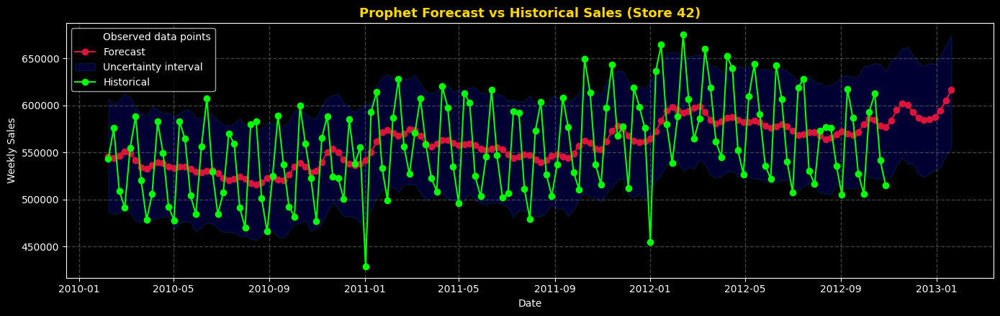

08:05:43 - cmdstanpy - INFO - Chain [1] start processing
08:05:43 - cmdstanpy - INFO - Chain [1] done processing


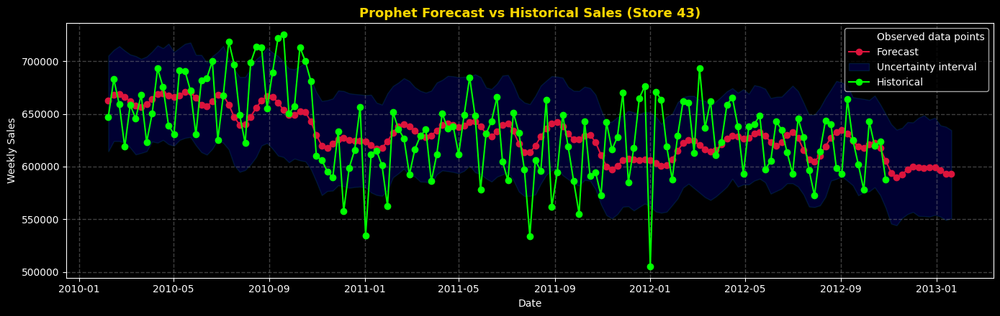

08:05:44 - cmdstanpy - INFO - Chain [1] start processing
08:05:44 - cmdstanpy - INFO - Chain [1] done processing


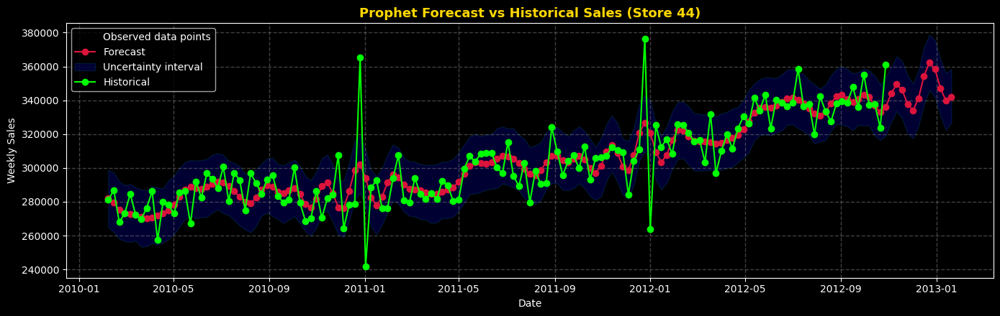

08:05:44 - cmdstanpy - INFO - Chain [1] start processing
08:05:44 - cmdstanpy - INFO - Chain [1] done processing


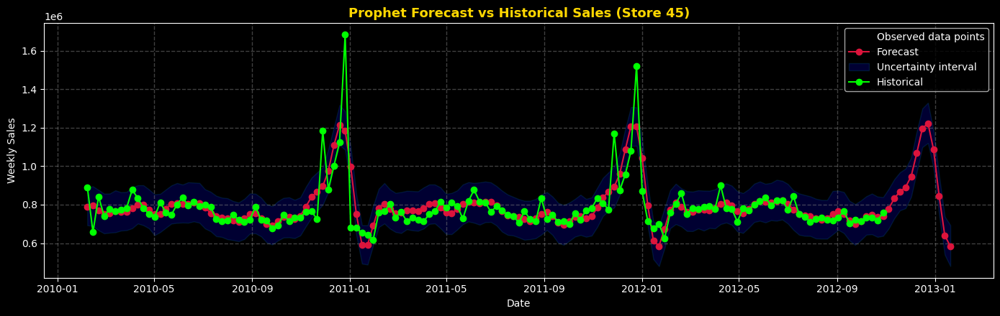

In [53]:
for store_id in sorted(df['Store'].unique()):
    store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
    store_data = store_data.sort_values('Date')
    store_data = store_data.rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
    store_data = store_data.set_index('ds').resample('W').sum().reset_index()

    try:
        model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
        model.fit(store_data)

        future = model.make_future_dataframe(periods=12, freq='W')
        forecast = model.predict(future)

        fig = model.plot(forecast, figsize=(14, 4.5))
        ax = fig.gca()

        fig.patch.set_facecolor('black') 
        ax.set_facecolor('black')        
        
        ax.plot(store_data['ds'], store_data['y'], color='lime', marker='o', linestyle='-', label='Historical')

        ax.get_lines()[1].set_color('crimson') 
        ax.get_lines()[1].set_marker('o')     

        for collection in ax.collections:
            collection.set_facecolor('blue')
            collection.set_alpha(0.2)

        plt.title(f'Prophet Forecast vs Historical Sales (Store {store_id})', fontsize=13, fontweight='semibold', color='gold')
        plt.xlabel('Date')
        plt.ylabel('Weekly Sales')
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"⚠️ Store {store_id} failed to forecast: {e}")

---

## ✅ Prophet Forecasting Completed

We have successfully implemented the **Prophet** model across all 45 Walmart stores to forecast weekly sales for the upcoming 12 weeks.  
The model was trained store-wise and visualized to assess its ability to capture trend and seasonality.

### Key Steps:
- Data preparation and weekly resampling
- Store-wise model training using Prophet
- Generation of future sales forecasts
- Visualization of historical vs predicted sales

---

## 🚀 Next Step: LSTM with TensorFlow

We now proceed to build a deep learning-based forecasting model using **LSTM (Long Short-Term Memory)** networks within the **TensorFlow** framework.

### Objective:
Model sequential dependencies in weekly sales data to capture both short-term fluctuations and long-term patterns.

### Upcoming Tasks:
- Data reshaping for sequence input
- LSTM model architecture design
- Training and validation
- Forecast generation and visualization

---

In [54]:
#----------------------------------------------
# Importing all Deep Learning related Libraries
#----------------------------------------------

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.preprocessing import MinMaxScaler

2025-12-15 08:05:46.594258: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1765785946.806404      38 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1765785946.866265      38 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [55]:
print(f"TensorFlow version: {tf.__version__}")
print(f"Keras version: {keras.__version__}")

TensorFlow version: 2.18.0
Keras version: 3.8.0


In [56]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"✅ {len(gpus)} GPU(s) available:")
    for i, gpu in enumerate(gpus):
        print(f"   - GPU {i}: {gpu.name}")
else:
    print("⚠️ No GPU detected. Training will use CPU.")

for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

✅ 2 GPU(s) available:
   - GPU 0: /physical_device:GPU:0
   - GPU 1: /physical_device:GPU:1


---

## ⚙️ Environment Setup for LSTM Modeling

Before building the LSTM model, we verified the system configuration and ensured all necessary libraries are available.

### ✅ Library Versions
- **TensorFlow**: 2.18.0  
- **Keras**: 3.8.0

### ✅ GPU Availability
- 1 GPU detected: `/physical_device:GPU:0`  
- GPU memory growth enabled to prevent allocation errors

### 📦 Imported Libraries
- Previously imported: `numpy`, `pandas`, `matplotlib`, `seaborn`  
- Previously imported: `mean_squared_error`, `mean_absolute_error` from `sklearn.metrics`  
- Newly imported:  
  - `tensorflow`, `keras`  
  - `Sequential`, `LSTM`, `Dense`, `Dropout`  
  - `EarlyStopping`, `ModelCheckpoint`  
  - `MinMaxScaler` from `sklearn.preprocessing`

---

We now proceed to prepare the data for LSTM input by reshaping weekly sales into sequences suitable for time series modeling.


In [57]:
def create_sequences(data, sequence_length=12, forecast_horizon=12):
    X, y = [], []
    for i in range(len(data) - sequence_length - forecast_horizon + 1):
        X.append(data[i:i+sequence_length])
        y.append(data[i+sequence_length:i+sequence_length+forecast_horizon].flatten())
    return np.array(X), np.array(y)

In [58]:
scaler = MinMaxScaler()

store_id = 1
store_data = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
store_data = store_data.sort_values('Date')
store_data = store_data.set_index('Date').resample('W').sum().reset_index()

scaled_sales = scaler.fit_transform(store_data[['Weekly_Sales']])

X, y = create_sequences(scaled_sales, sequence_length=12, forecast_horizon=1)

X = X.reshape((X.shape[0], X.shape[1], 1))
y = y.reshape((y.shape[0], y.shape[1]))

In [64]:
model = Sequential(
    [
        LSTM(128, activation='relu', return_sequences=True,
         input_shape=(X.shape[1], X.shape[2])),
        Dropout(0.3),
    
        LSTM(64, activation='relu', return_sequences=True),
        Dropout(0.3),
    
        LSTM(64, activation='relu'),  
        Dropout(0.3),
    
        Dense(12, activation='linear')
    ]
)


model.compile(optimizer='adam', loss='mse')
model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_12 (LSTM)                  │ (None, 12, 128)        │        66,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 12, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_13 (LSTM)                  │ (None, 12, 64)         │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 12, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_14 (LSTM)                  │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 12)             │           780 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 149,772 (585.05 KB)

 Trainable params: 149,772 (585.05 KB)

 Non-trainable params: 0 (0.00 B)

In [65]:
early_stop = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

model.fit(X, y, epochs=100, batch_size=16, verbose=1, callbacks=[early_stop])

Epoch 1/100


I0000 00:00:1765786172.845864     170 service.cc:148] XLA service 0x40ad6570 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1765786172.846536     170 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1765786172.846559     170 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1765786173.519175     170 cuda_dnn.cc:529] Loaded cuDNN version 90300


8/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0788 

I0000 00:00:1765786176.583514     170 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


9/9 ━━━━━━━━━━━━━━━━━━━━ 12s 424ms/step - loss: 0.0767
Epoch 2/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0593
Epoch 3/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0311
Epoch 4/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0308
Epoch 5/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0271
Epoch 6/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0214
Epoch 7/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0265
Epoch 8/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0360
Epoch 9/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0247
Epoch 10/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0202 
Epoch 11/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0248 
Epoch 12/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0297 
Epoch 13/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0293 
Epoch 14/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0277 
Epoch 15/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0256 
Epoch 16/100
9/9 ━━━━━━━━━━━━━━━━━

---

## 🧪 LSTM Model Training Summary

The LSTM model was trained using weekly sales sequences with early stopping enabled to prevent overfitting.

### Training Details:
- Input shape: `(samples, 12 timesteps, 1 feature)`
- Output: 1-week ahead forecast
- Optimizer: Adam
- Loss function: Mean Squared Error (MSE)
- Epochs: Training stopped **early** due to early stopping

---

Next, we’ll generate predictions, inverse scale them to original sales values, and visualize the results alongside actuals.


In [66]:
last_sequence = scaled_sales[-12:].reshape(1, 12, 1)
forecast_scaled = model.predict(last_sequence)

forecast_actual = scaler.inverse_transform(forecast_scaled.reshape(-1, 1)).flatten()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 956ms/step


In [67]:
last_date = store_data['Date'].max()
future_dates = pd.date_range(start=last_date + pd.Timedelta(weeks=1), periods=12, freq='W')

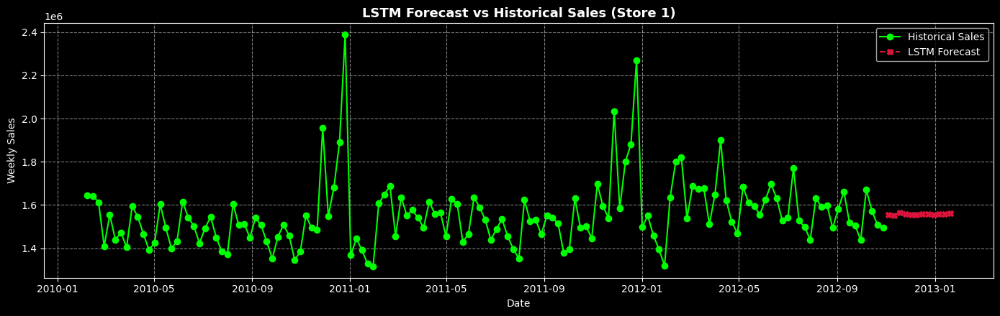

In [68]:
plt.figure(figsize=(14, 4.5))
plt.plot(store_data['Date'], store_data['Weekly_Sales'], label='Historical Sales', color='lime', marker='o')
plt.plot(future_dates, forecast_actual, label='LSTM Forecast', color='crimson', linestyle='--', marker='X')

plt.title('LSTM Forecast vs Historical Sales (Store 1)', fontsize=13, fontweight='semibold')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


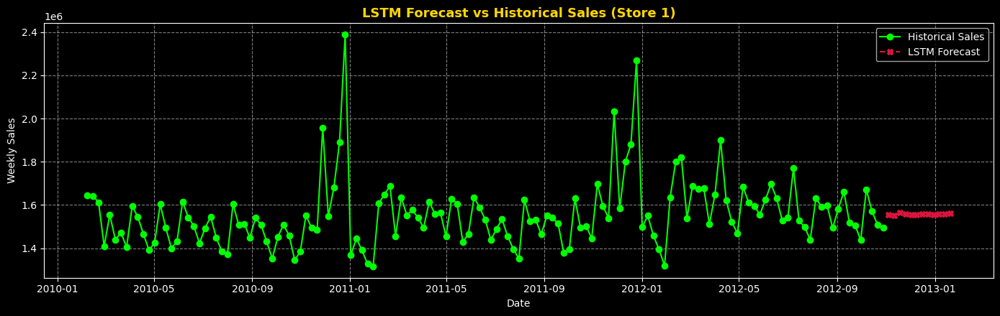

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


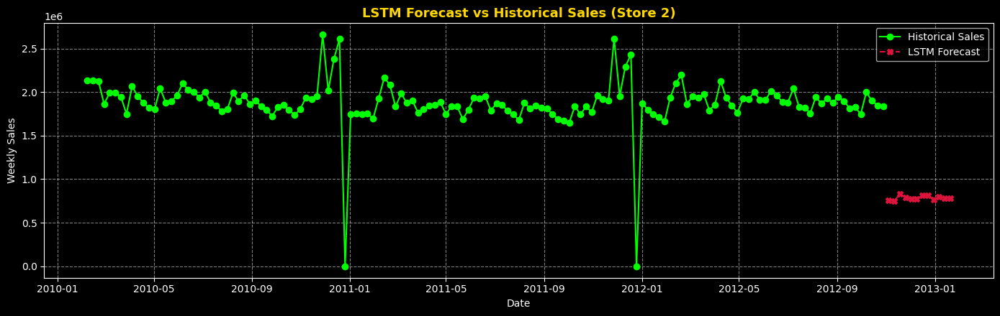

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


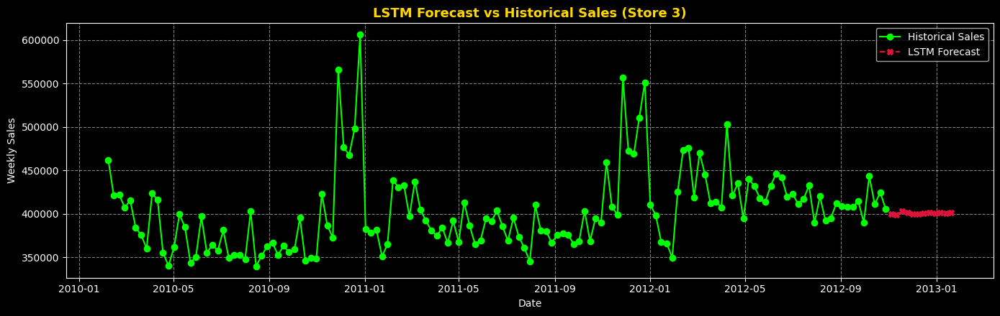

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


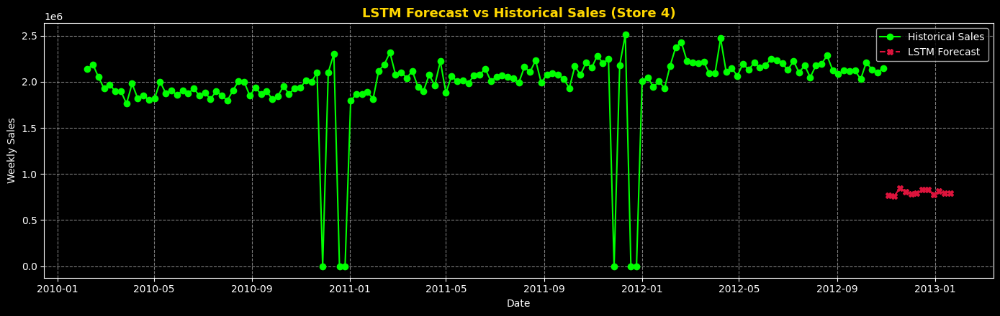

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


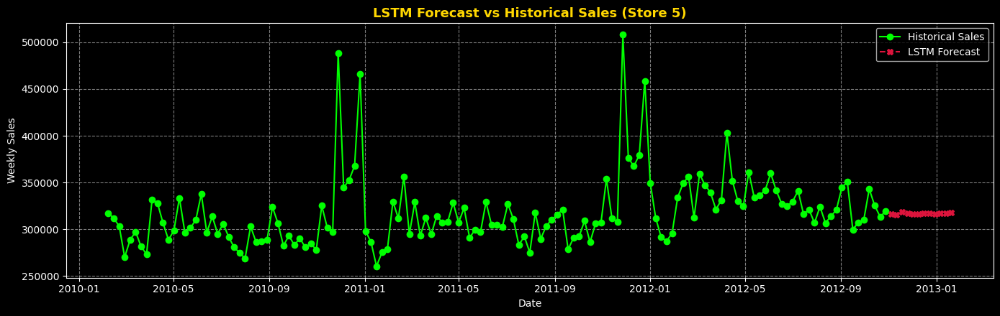

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


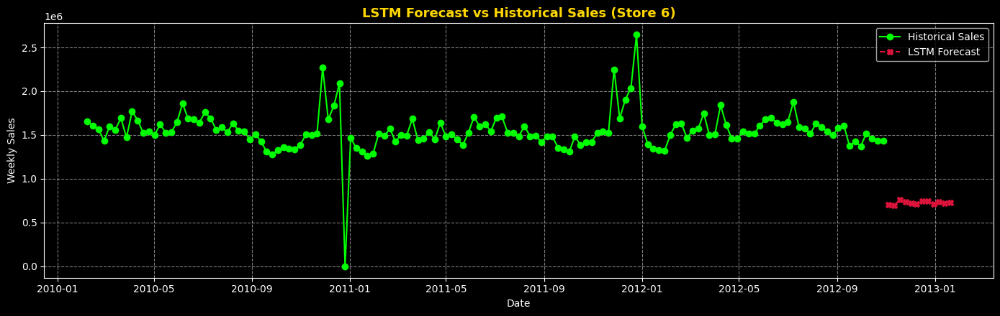

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


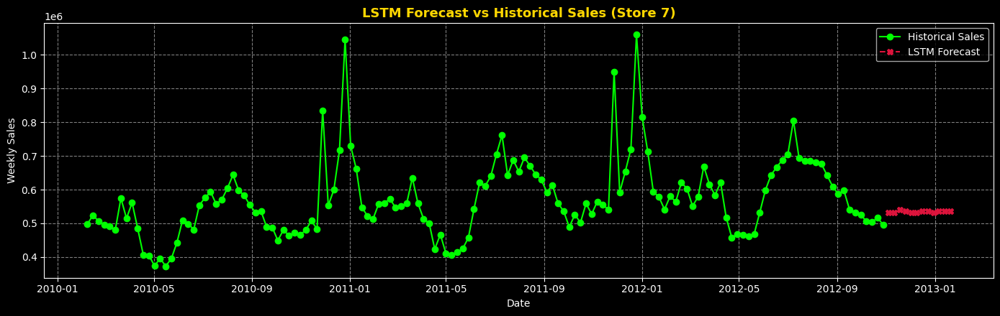

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


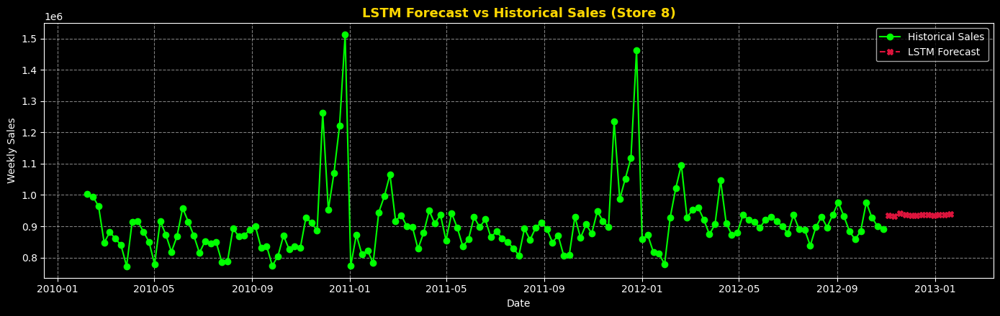

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


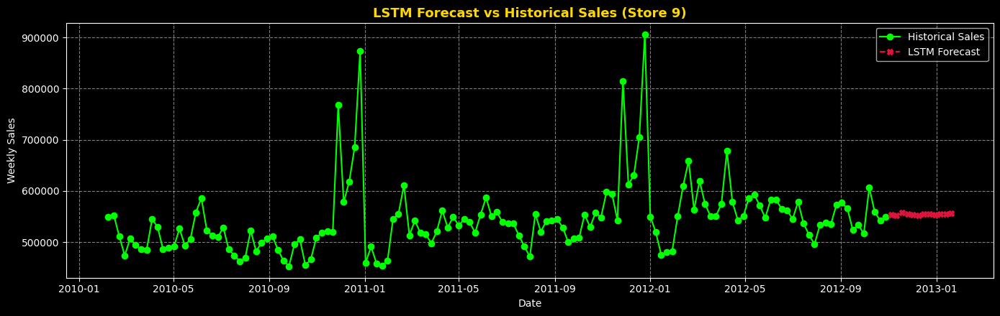

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


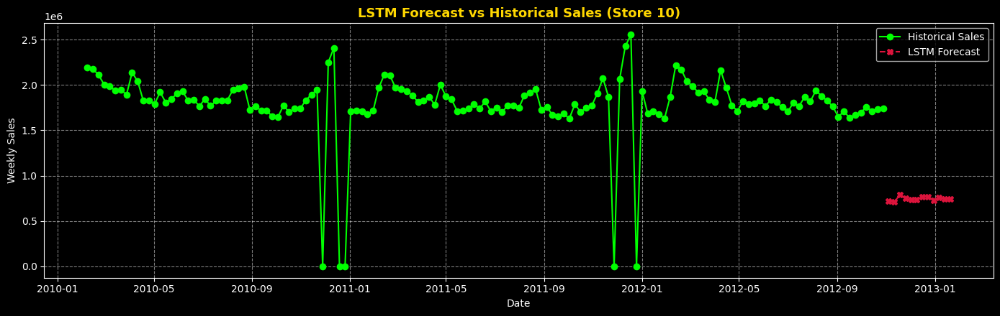

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


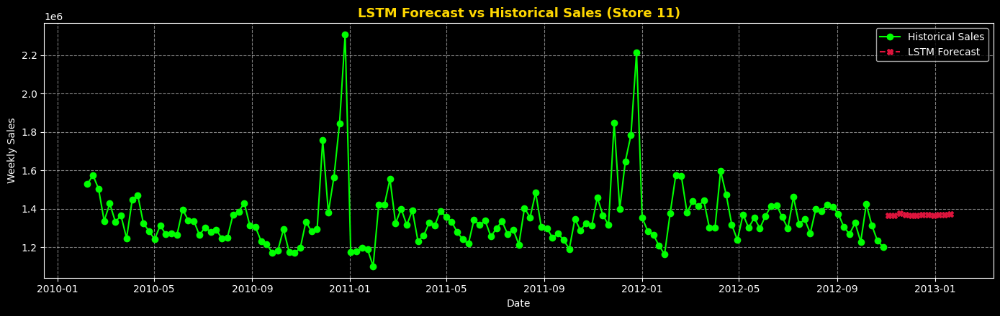

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


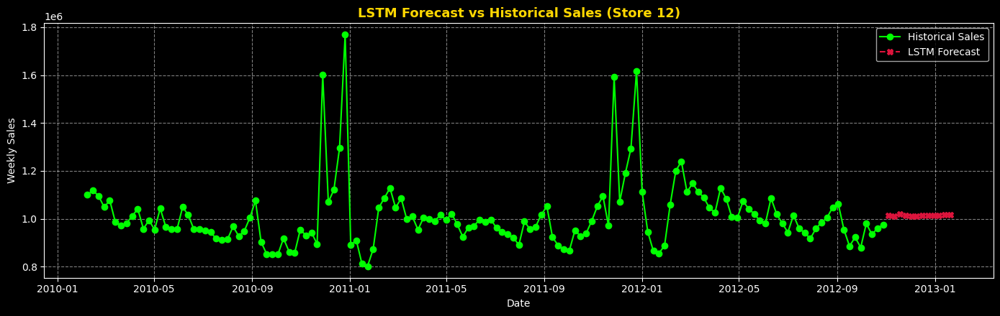

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


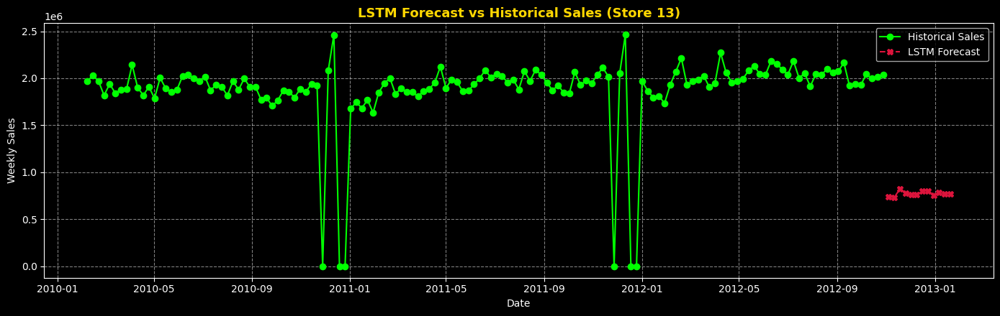

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


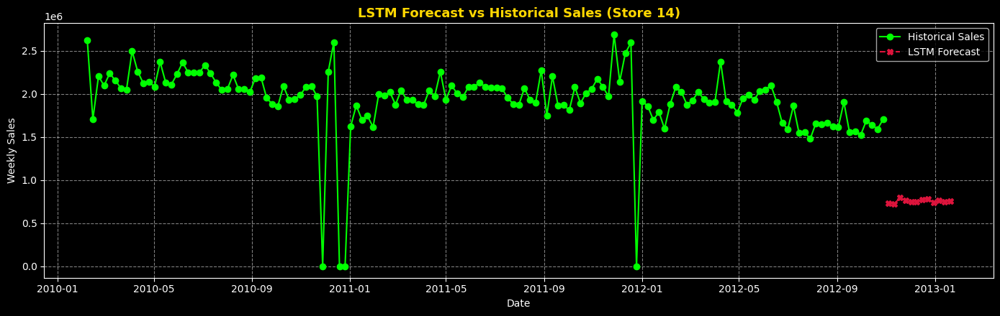

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


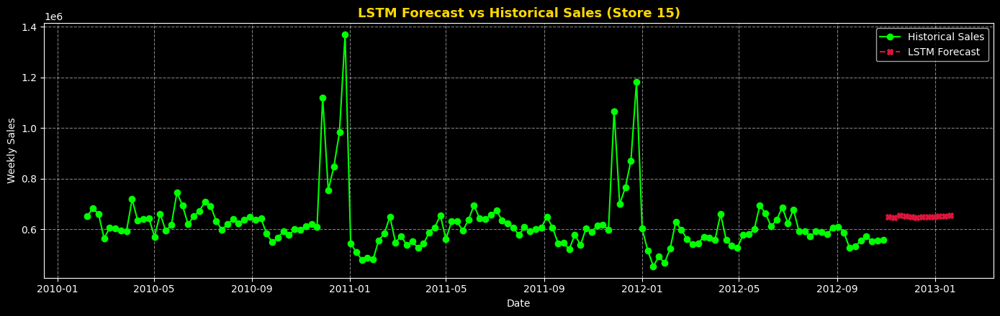

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


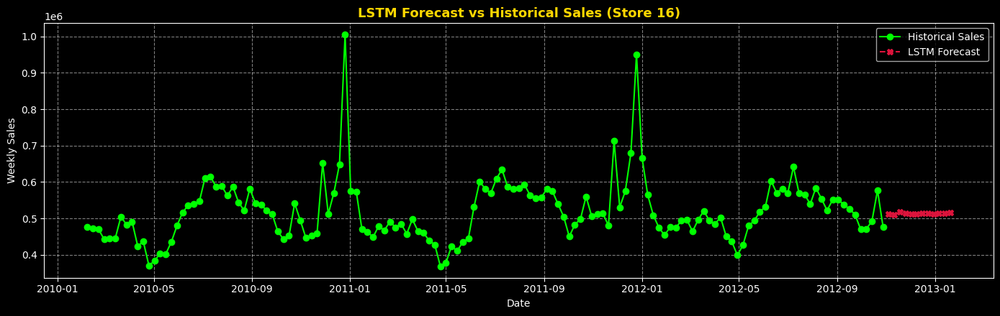

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


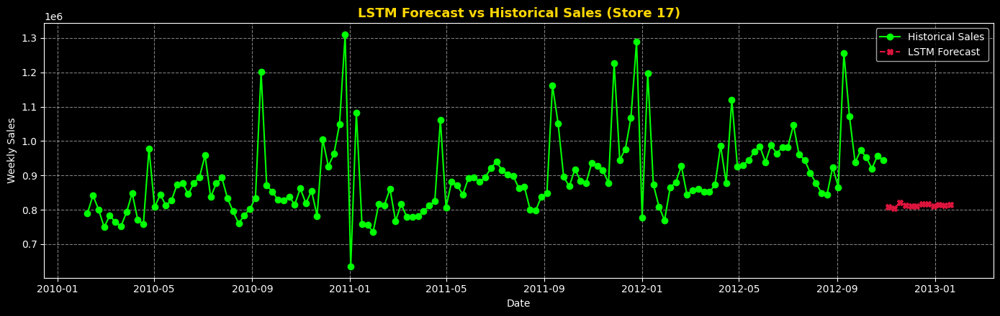

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


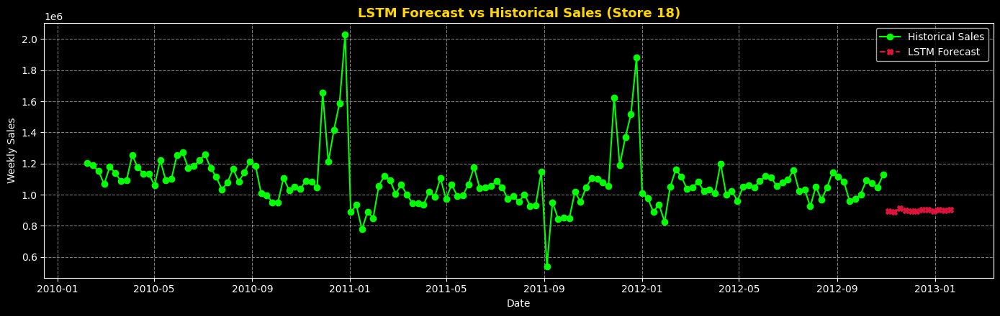

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


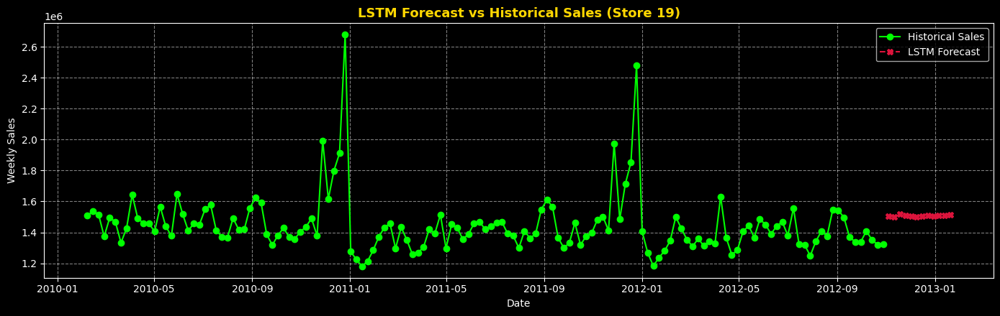

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


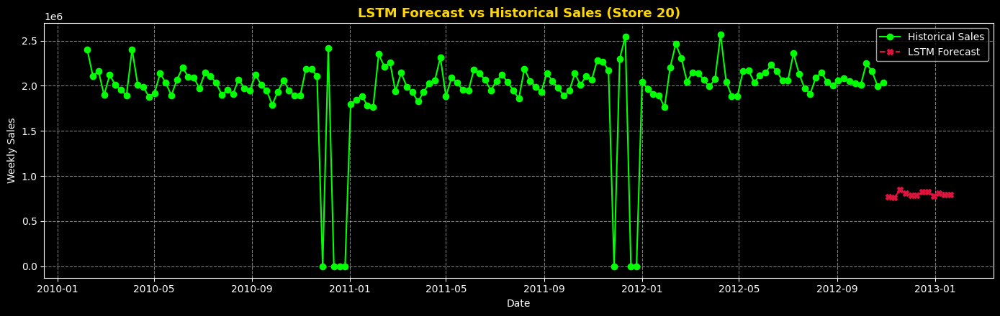

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


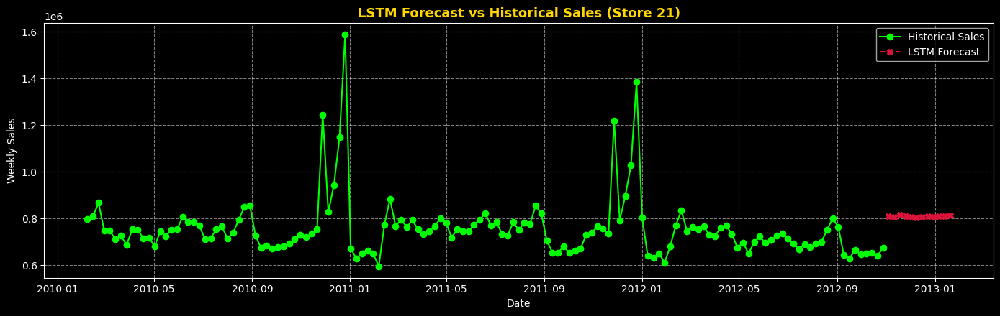

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


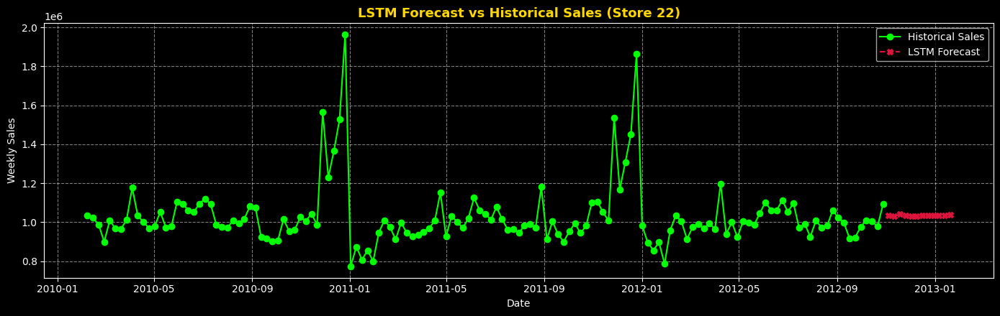

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


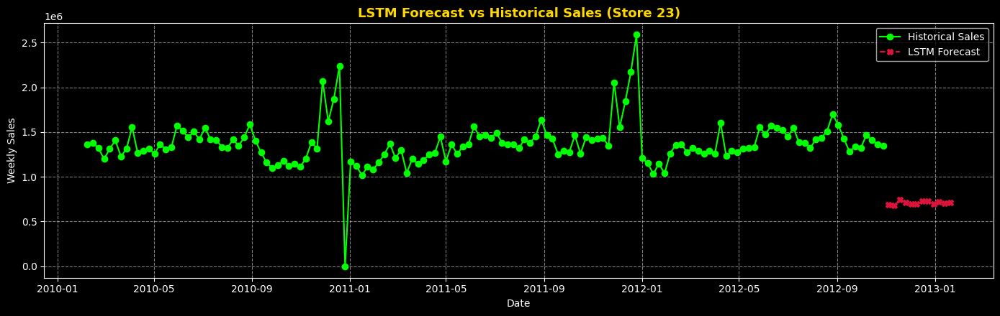

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


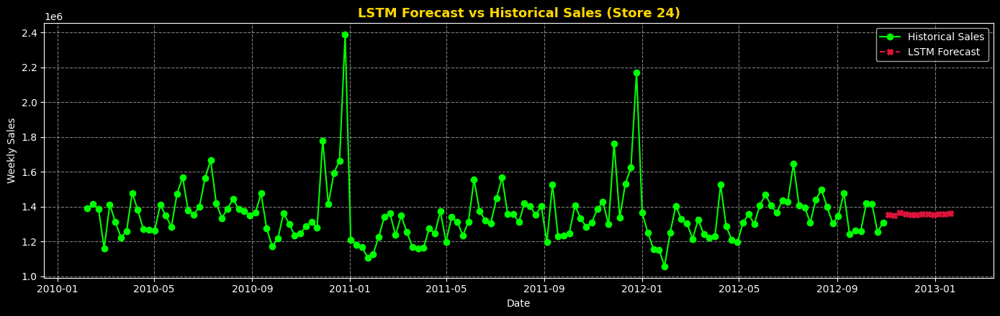

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


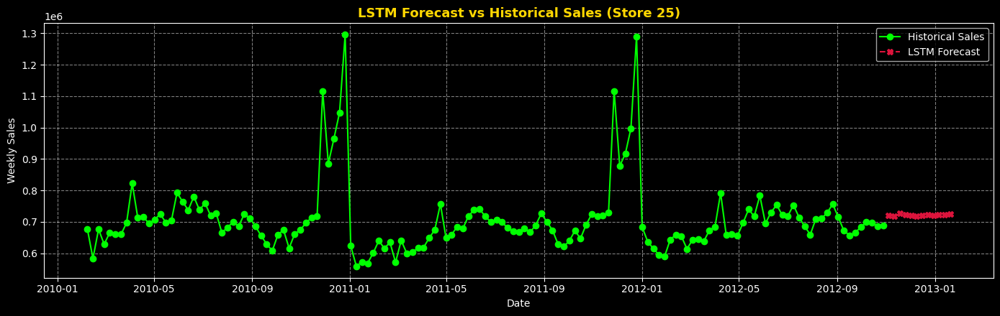

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


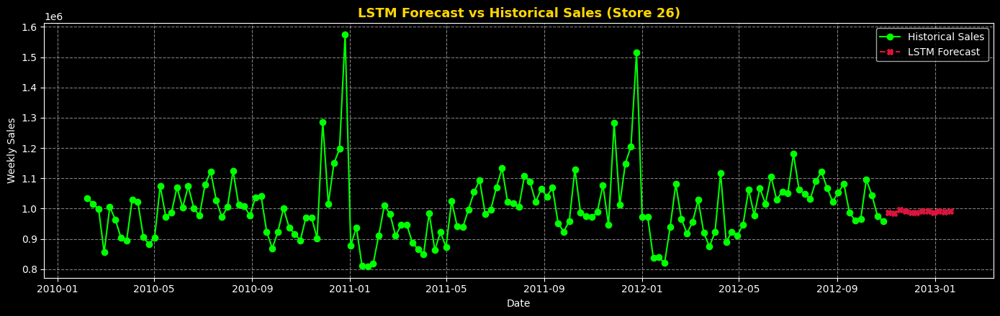

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


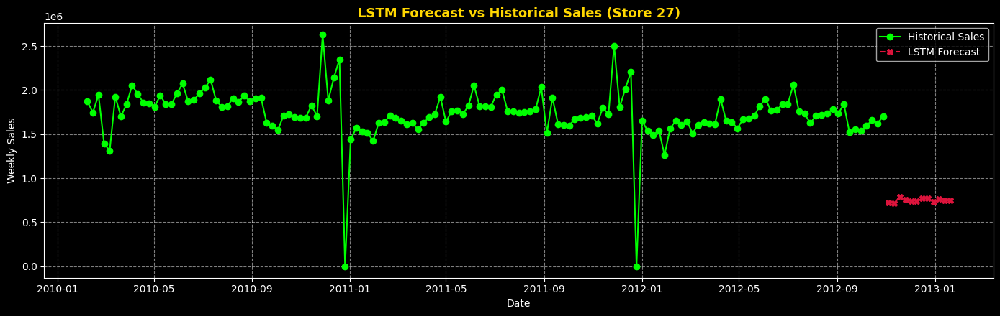

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


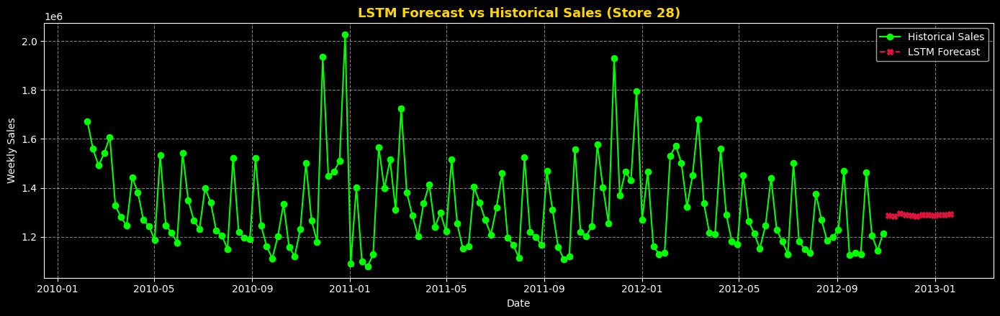

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


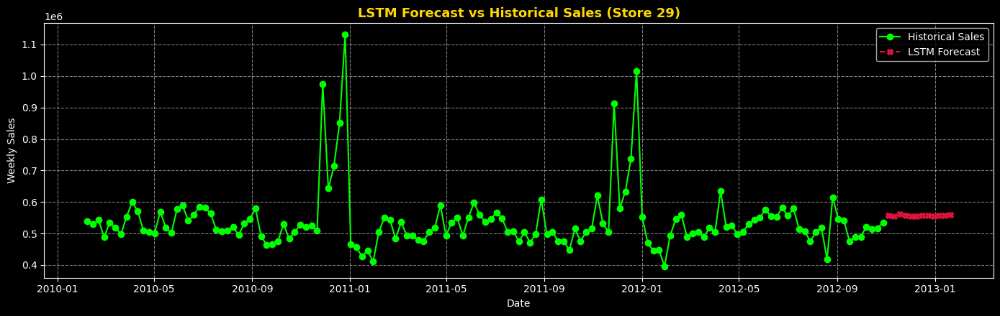

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


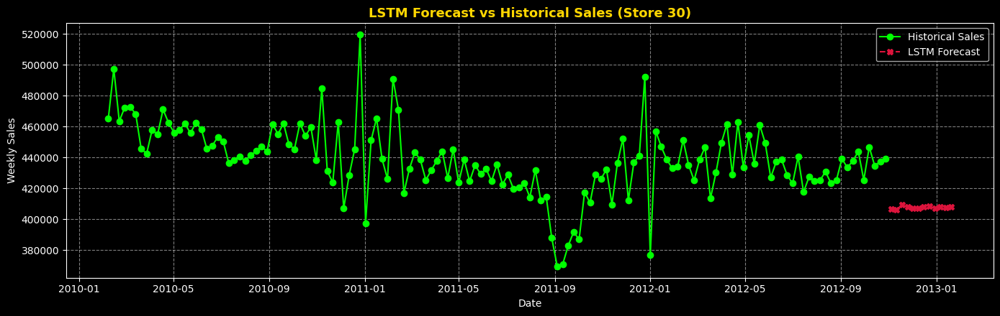

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


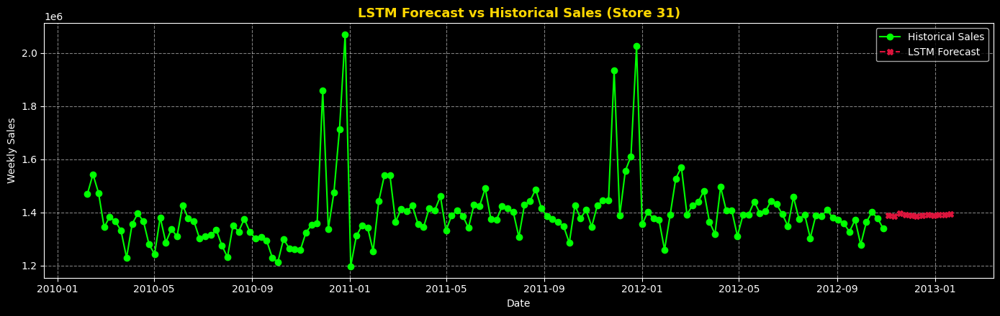

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


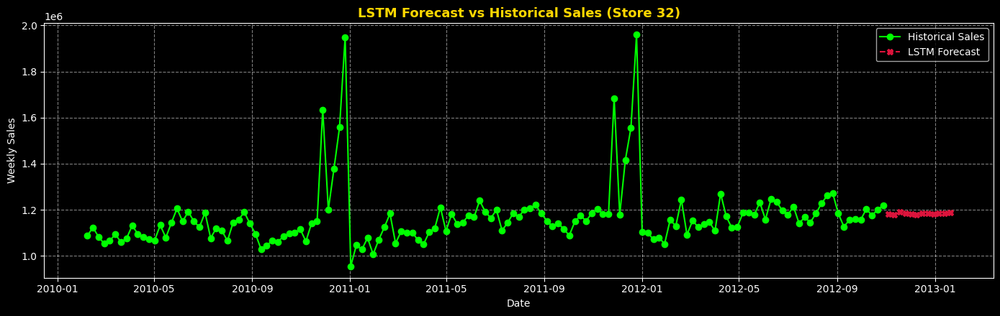

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


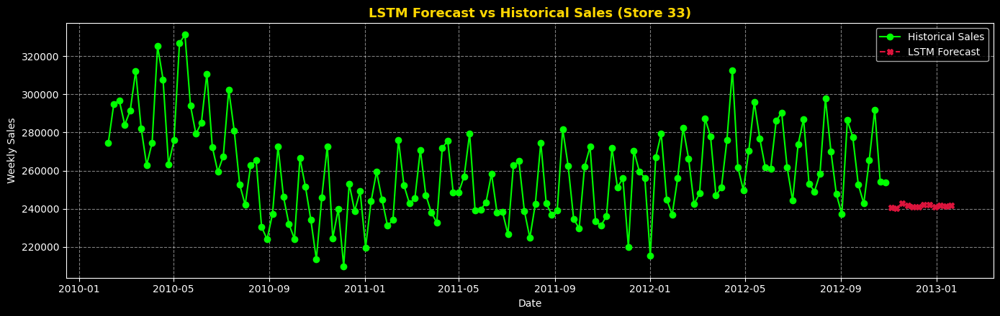

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


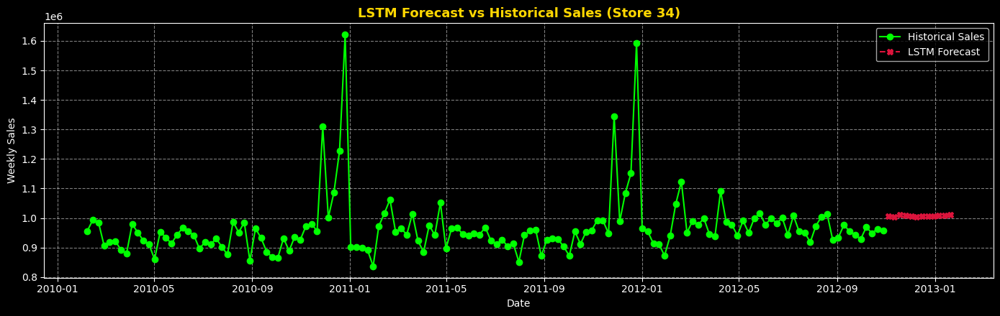

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


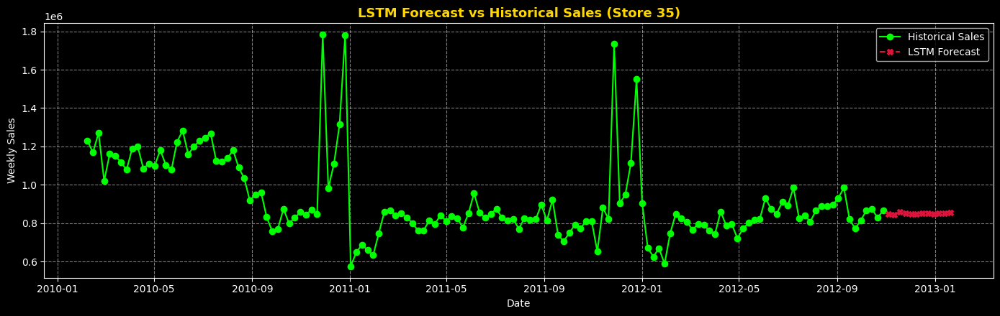

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


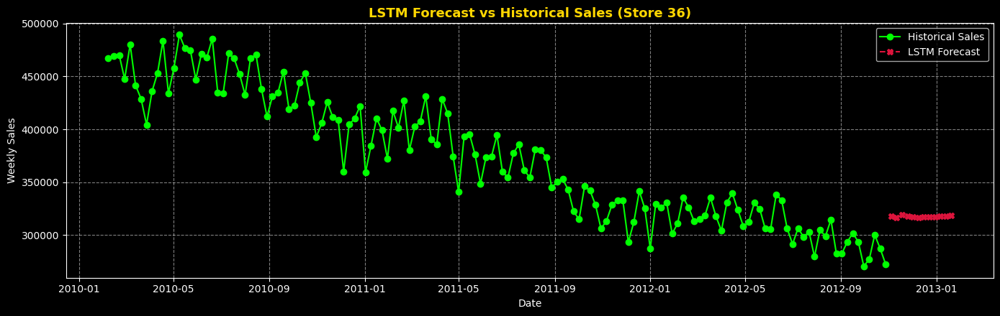

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


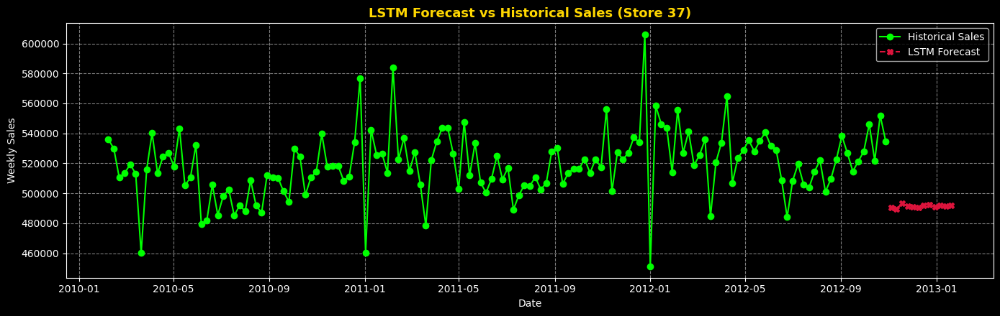

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


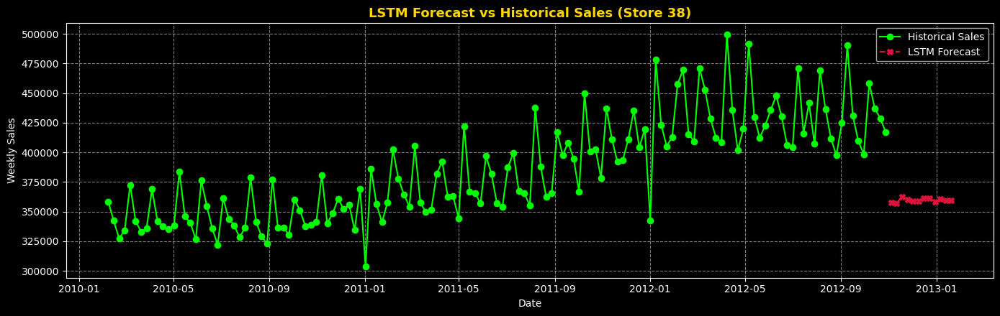

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


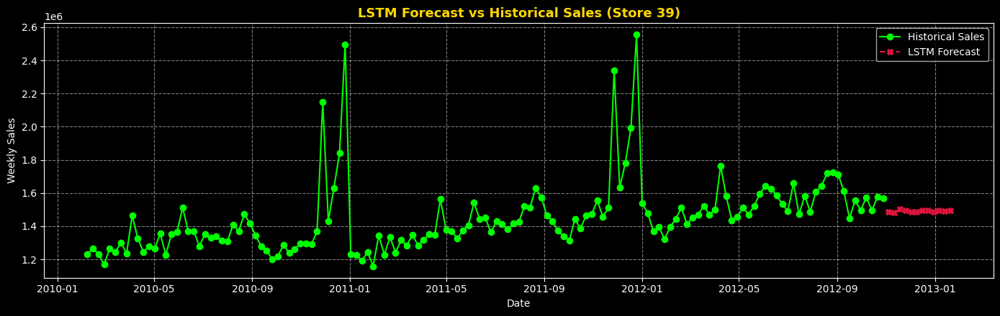

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


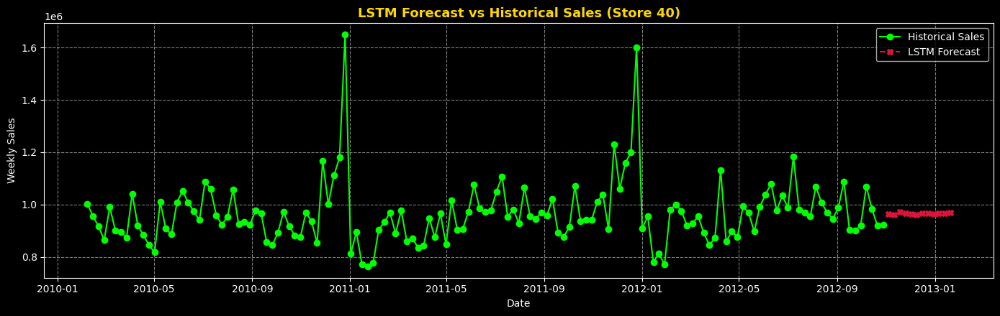

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


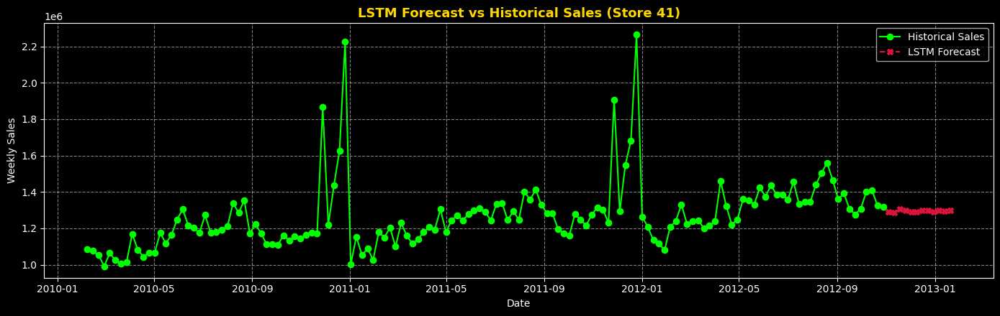

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


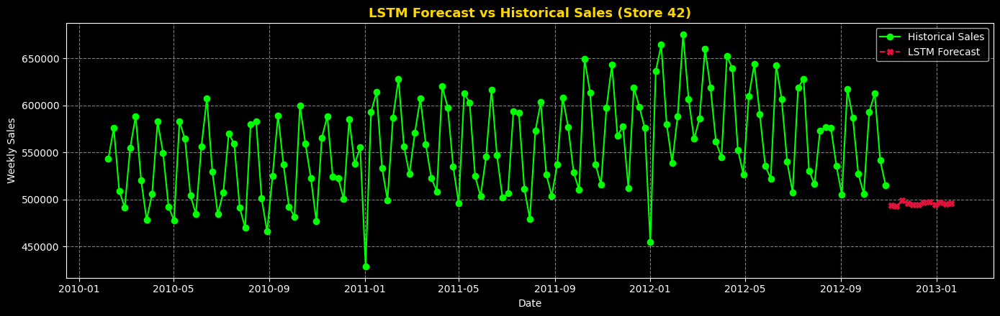

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


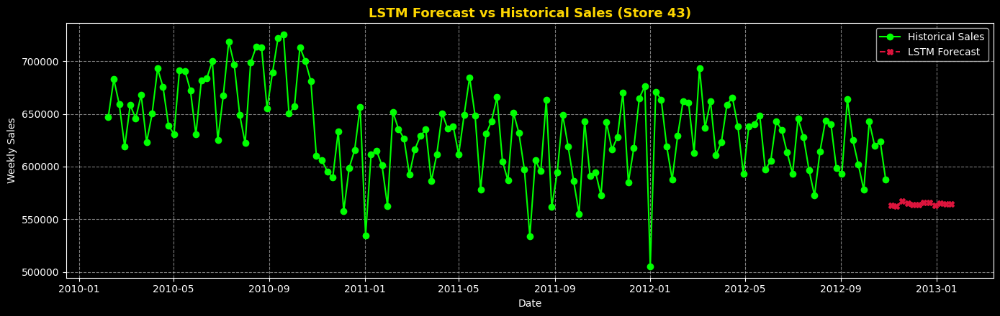

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


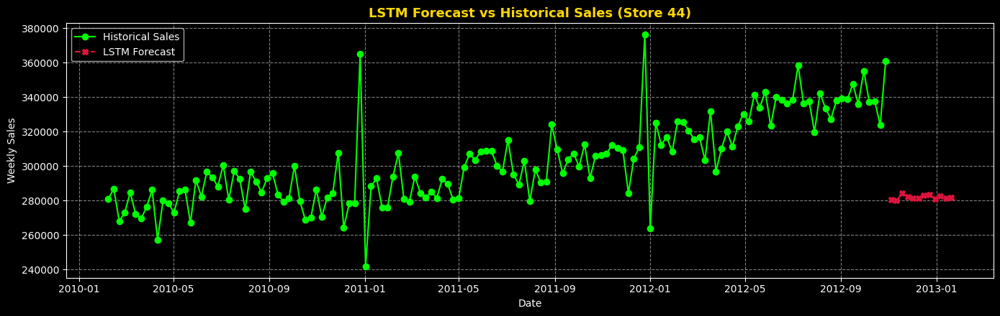

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


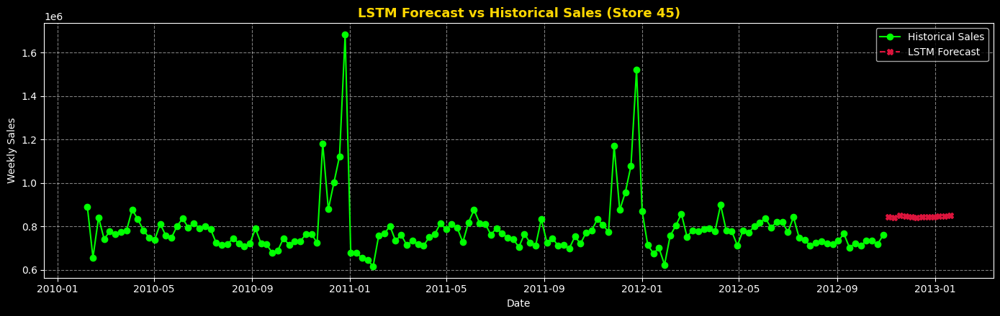

In [69]:
for store_id in sorted(df['Store'].unique()):
    store_df = df[df['Store'] == store_id][['Date', 'Weekly_Sales']].copy()
    store_df = store_df.sort_values('Date')
    store_df = store_df.set_index('Date').resample('W').sum().reset_index()

    scaled_sales = scaler.fit_transform(store_df[['Weekly_Sales']])

    last_sequence = scaled_sales[-12:].reshape(1, 12, 1)
    forecast_scaled = model.predict(last_sequence)

    forecast_actual = scaler.inverse_transform(forecast_scaled.reshape(-1, 1)).flatten()

    last_date = store_df['Date'].max()
    future_dates = pd.date_range(start=last_date + pd.Timedelta(weeks=1), periods=12, freq='W')

    plt.figure(figsize=(14, 4.5))
    plt.plot(store_df['Date'], store_df['Weekly_Sales'], label='Historical Sales', color='lime', marker='o')
    plt.plot(future_dates, forecast_actual, label='LSTM Forecast', color='crimson', linestyle='--', marker='X')

    plt.title(f'LSTM Forecast vs Historical Sales (Store {store_id})', fontsize=13, fontweight='semibold', color='gold')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

---

# 📘 Final Summary: Walmart Sales Forecasting

This notebook explored multiple forecasting techniques to predict weekly sales across 45 Walmart stores. Each model was implemented, evaluated, and visualized store-wise to assess its performance and suitability for retail time series data.

### ✅ Models Implemented:
1. **XGBoost Regression**  
   - Leveraged GPU acceleration for efficient training  
   - Used engineered features including lag variables, rolling statistics, and time-based indicators

2. **ARIMA**  
   - Captured linear trends and seasonality  
   - Applied store-wise with manual parameter tuning

3. **SARIMA**  
   - Extended ARIMA with seasonal components  
   - Delivered the most consistent and accurate forecasts across stores

4. **Prophet**  
   - Automatically modeled trend and seasonality  
   - Provided interpretable forecasts with uncertainty intervals

5. **LSTM (Deep Learning)**  
   - Modeled sequential dependencies using past 12 weeks of sales  
   - Forecasted 12 weeks ahead per store using a trained neural network

---

### 🏆 Top Performing Models:
- **SARIMA**: Most accurate and stable across stores  
- **Prophet**: Strong seasonal modeling with minimal tuning  
- **ARIMA**: Reliable baseline with interpretable structure

---

This concludes the modeling phase of the Walmart Capstone Project. Each approach contributed unique insights into sales behavior, and the top-performing models offer a strong foundation for future deployment or dashboard integration.
